In [0]:
%matplotlib inline
import math
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

from collections import defaultdict, Counter
from scipy.stats.stats import pearsonr

from datetime import datetime

In [0]:
#pip install prettytable

In [0]:
#conda install -c conda-forge pyts

In [0]:
url = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatraining.csv'
df = pd.read_csv(url) 

url_test1 = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatest.csv'
df_test1 =pd.read_csv(url_test1)

url_test2 = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatest2.csv'
df_test2 =pd.read_csv(url_test2)

# Data preparation

## date time

#### df

In [0]:
df['date'] = pd.to_datetime(df['date'])

In [0]:
df = df.set_index(['date'])

In [0]:
df.head(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-04 17:51:00,23.18,27.2720,426.0,721.25,0.004793,1
2015-02-04 17:51:59,23.15,27.2675,429.5,714.00,0.004783,1


In [0]:
df.tail(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-10 09:32:00,21.1,36.26,433.0,820.333333,0.005621,1
2015-02-10 09:33:00,21.1,36.20,447.0,821.000000,0.005612,1


#### df_test 1

In [0]:
df_test1['date'] = pd.to_datetime(df_test1['date'])

In [0]:
df_test1 = df_test1.set_index(['date'])

In [0]:
df_test1.head(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-02 14:19:00,23.700,26.272,585.2,749.2,0.004764,1
2015-02-02 14:19:59,23.718,26.290,578.4,760.4,0.004773,1


In [0]:
df_test1.tail(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-04 10:41:59,24.356667,25.700000,813.0,1123.0,0.004849,1
2015-02-04 10:43:00,24.408333,25.681667,798.0,1124.0,0.004860,1


#### df_test 2

In [0]:
df_test2['date'] = pd.to_datetime(df_test2['date'])

In [0]:
df_test2 = df_test2.set_index(['date'])

In [0]:
df_test2.head(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-11 14:48:00,21.76,31.133333,437.333333,1029.666667,0.005021,1
2015-02-11 14:49:00,21.79,31.000000,437.333333,1000.000000,0.005009,1


In [0]:
df_test2.tail(2)

,Temperature,Humidity,Light,CO2,HumidityRatio,Occupancy
date,,,,,,
2015-02-18 09:17:59,20.89,28.0225,418.75,1632.0,0.004279,1
2015-02-18 09:19:00,21.00,28.1000,409.00,1864.0,0.004321,1


## Explore time series

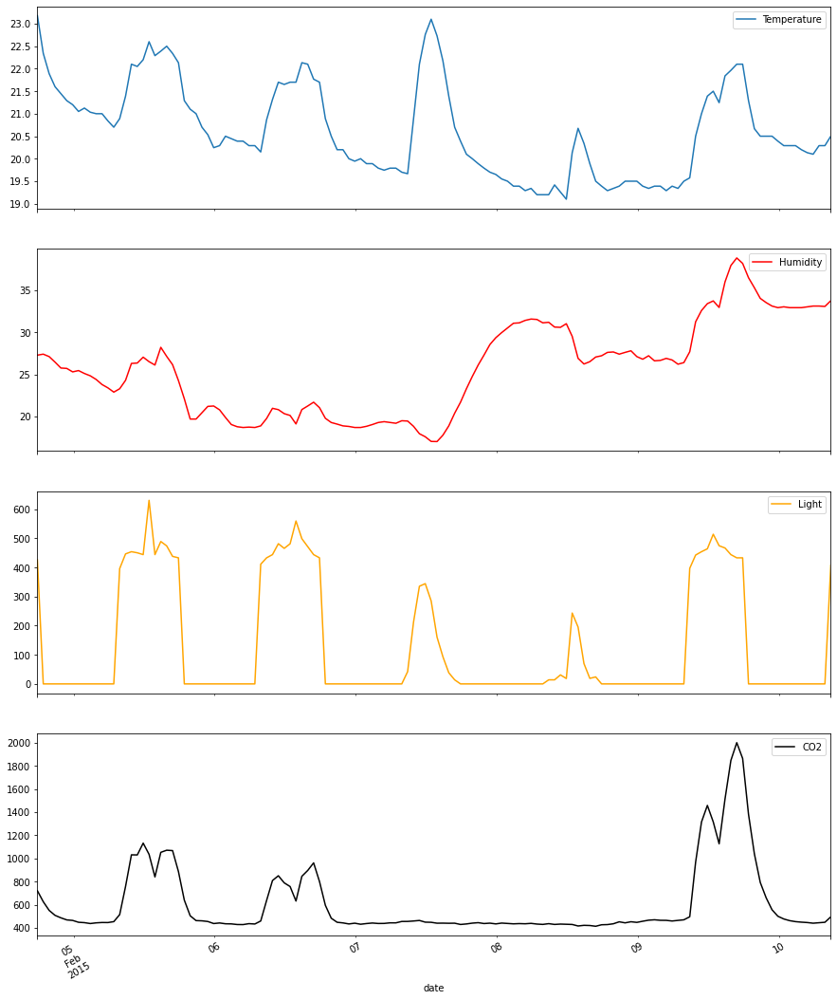

In [0]:
df[['Temperature','Humidity','Light','CO2']].asfreq(freq = '60min').plot(subplots=True, figsize=(15,20), color =('#1f77b4','r','orange','k'))
plt.show()

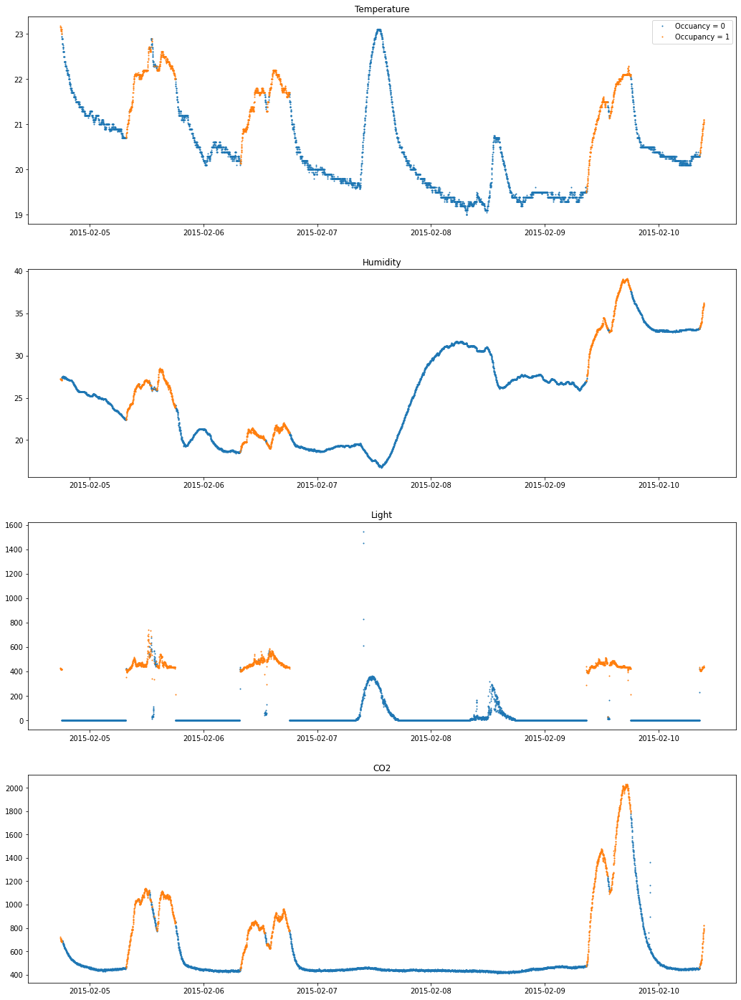

In [0]:
non_occupato = df[df['Occupancy']==0]
occupato = df[df['Occupancy']==1]


plt.figure(figsize=(15,20))
plt.subplot(411)

plt.title('Temperature')
plt.plot(non_occupato.index, non_occupato['Temperature'], label='Occuancy = 0', marker = 'o', markersize=1, linestyle = 'None')
plt.plot(occupato.index,occupato['Temperature'], label='Occupancy = 1', marker = 'o',  markersize=1, linestyle = 'None')
plt.legend(loc='best')

plt.subplot(412)
plt.title('Humidity')
plt.plot(non_occupato.index, non_occupato['Humidity'], label='Occuancy = 0', marker = 'o', markersize=1, linestyle = 'None')
plt.plot(occupato.index,occupato['Humidity'], label='Occupancy = 1', marker = 'o',  markersize=1, linestyle = 'None')

plt.subplot(413)
plt.title('Light')
plt.plot(non_occupato.index, non_occupato['Light'], label='Occuancy = 0', marker = 'o', markersize=1, linestyle = 'None')
plt.plot(occupato.index,occupato['Light'], label='Occupancy = 1', marker = 'o',  markersize=1, linestyle = 'None')

plt.subplot(414)
plt.title('CO2')
plt.plot(non_occupato.index, non_occupato['CO2'], label='Occuancy = 0', marker = 'o', markersize=1, linestyle = 'None')
plt.plot(occupato.index,occupato['CO2'], label='Occupancy = 1', marker = 'o',  markersize=1, linestyle = 'None')

plt.tight_layout(pad=3.0)
plt.show()


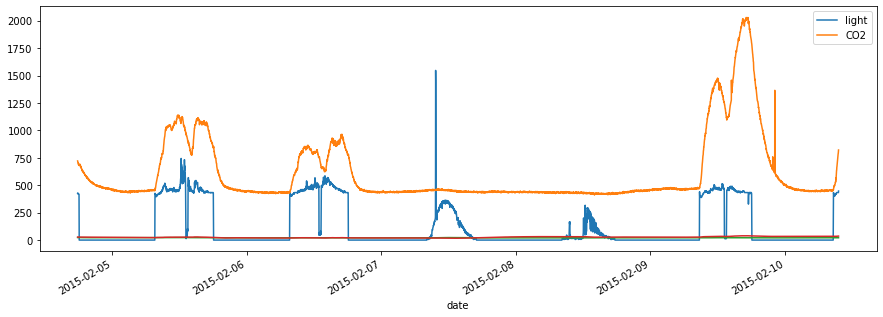

In [0]:
plt.figure(figsize=(15,5))

df["Light"].plot(legend=True)
shifted = df["CO2"].plot(legend=True)
shifted1 = df["Temperature"].plot(legend=True)
shifted3 = df["Humidity"].plot(legend=True)


shifted.legend(['light','CO2'])
plt.show()

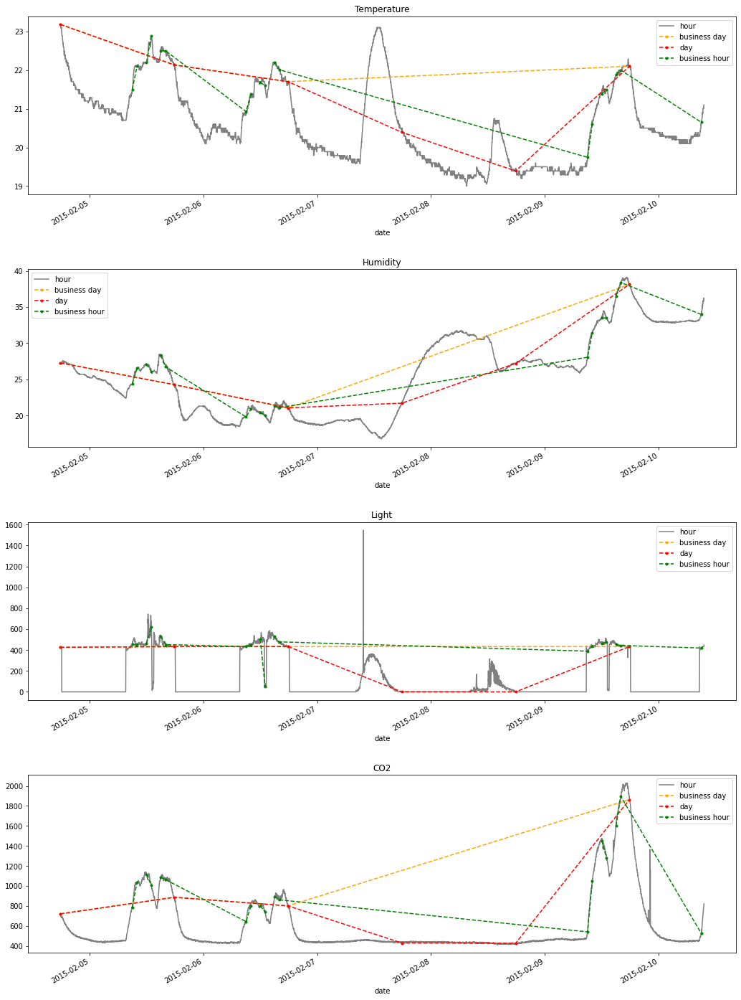

In [0]:
plt.figure(figsize=(15,20))
plt.subplot(411)

date = df["Temperature"].plot(legend=True, c = 'gray')
business_day = df["Temperature"].asfreq(freq='B').plot(legend=True, c = 'orange',marker = 'o',  markersize=3, linestyle = '--')  #giorni lavorativi
day = df["Temperature"].asfreq(freq='D').plot(legend=True, c = 'red',marker = 'o',  markersize=3, linestyle = '--')  #giorni
business_hour = df["Temperature"].asfreq(freq='BH').plot(legend=True, c = 'green',marker = 'o',  markersize=3, linestyle = '--')  #ore lavorative

business_hour.legend(['hour', 'business day', 'day', 'business hour'])
plt.title('Temperature')

plt.subplot(412)

date = df["Humidity"].plot(legend=True, c = 'gray')
business_day = df["Humidity"].asfreq(freq='B').plot(legend=True, c = 'orange',marker = 'o',  markersize=3, linestyle = '--')  #giorni lavorativi
day = df["Humidity"].asfreq(freq='D').plot(legend=True, c = 'red',marker = 'o',  markersize=3, linestyle = '--')  #giorni
business_hour = df["Humidity"].asfreq(freq='BH').plot(legend=True, c = 'green',marker = 'o',  markersize=3, linestyle = '--')  #ore lavorative

business_hour.legend(['hour', 'business day', 'day', 'business hour'])
plt.title('Humidity')

plt.subplot(413)

date = df["Light"].plot(legend=True, c = 'gray')
business_day = df["Light"].asfreq(freq='B').plot(legend=True, c = 'orange',marker = 'o',  markersize=3, linestyle = '--')  #giorni lavorativi
day = df["Light"].asfreq(freq='D').plot(legend=True, c = 'red',marker = 'o',  markersize=3, linestyle = '--')  #giorni
business_hour = df["Light"].asfreq(freq='BH').plot(legend=True, c = 'green',marker = 'o',  markersize=3, linestyle = '--')  #ore lavorative

business_hour.legend(['hour', 'business day', 'day', 'business hour'])
plt.title('Light')

plt.subplot(414)

date = df["CO2"].plot(legend=True, c = 'gray')
business_day = df["CO2"].asfreq(freq='B').plot(legend=True, c = 'orange',marker = 'o',  markersize=3, linestyle = '--')  #giorni lavorativi
day = df["CO2"].asfreq(freq='D').plot(legend=True, c = 'red',marker = 'o',  markersize=3, linestyle = '--')  #giorni
business_hour = df["CO2"].asfreq(freq='BH').plot(legend=True, c = 'green',marker = 'o',  markersize=3, linestyle = '--')  #ore lavorative

business_hour.legend(['hour', 'business day', 'day', 'business hour'])
plt.title('CO2')

plt.tight_layout(pad=3.0)
plt.show()


# Motif & Anomaly Discovery: Matrix Profile

In [0]:
pip install matrixprofile-ts

In [0]:
from matrixprofile import *
from matrixprofile.discords import discords

### Light

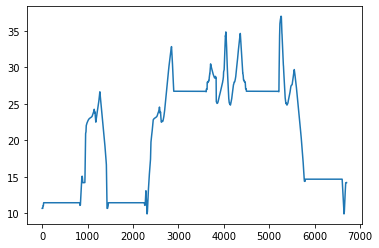

In [0]:
w = 1440
mp_l, mpi_l = matrixProfile.stomp(df['Light'].values, w)

plt.plot(mp_l)
plt.show()

In [0]:
mo_l, mod_l  = motifs.motifs(df['Light'].values, (mp_l, mpi_l), max_motifs=5)
mo_l,mod_l

([[882, 2310, 6647], [13, 5776], [3031, 4631]],
 [9.911605793865196, 10.671319921679892, 26.737072056970952])

In [0]:
df.index[mo_l[0]],df.index[mo_l[1]],df.index[mo_l[2]]

(DatetimeIndex(['2015-02-05 08:32:59', '2015-02-06 08:21:00',
                '2015-02-09 08:38:00'],
               dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-04 18:04:00', '2015-02-08 18:07:00'], dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-06 20:22:00', '2015-02-07 23:02:00'], dtype='datetime64[ns]', name='date', freq=None))

In [0]:
anoms_l = discords(mp_l, ex_zone=3, k=20)
anoms_l, df.index[anoms_l]

(array([5260, 5267, 5256, 5263, 5252, 5248, 5270, 5244, 5240, 5236, 5273,
        5232, 5276, 4045, 5279, 4048, 4363, 4041, 5282, 4359]),
 DatetimeIndex(['2015-02-08 09:30:59', '2015-02-08 09:38:00',
                '2015-02-08 09:27:00', '2015-02-08 09:34:00',
                '2015-02-08 09:23:00', '2015-02-08 09:19:00',
                '2015-02-08 09:40:59', '2015-02-08 09:15:00',
                '2015-02-08 09:10:59', '2015-02-08 09:07:00',
                '2015-02-08 09:43:59', '2015-02-08 09:03:00',
                '2015-02-08 09:47:00', '2015-02-07 13:15:59',
                '2015-02-08 09:49:59', '2015-02-07 13:19:00',
                '2015-02-07 18:34:00', '2015-02-07 13:12:00',
                '2015-02-08 09:53:00', '2015-02-07 18:29:59'],
               dtype='datetime64[ns]', name='date', freq=None))

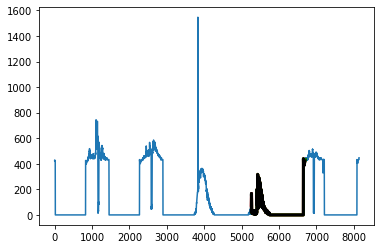

In [0]:
plt.plot(df['Light'].values)
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_l)]
for a, c in zip(anoms_l, colors):
    a_shape = df['Light'].values[a:a+w]
    plt.plot(range(a, a+w), a_shape, color=c, lw=3)

plt.show()

### Temperature

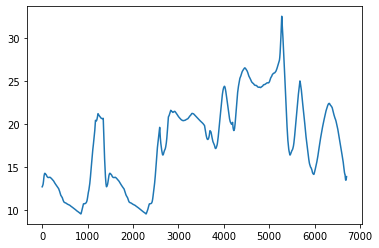

In [0]:
w = 1440
mp_t, mpi_t = matrixProfile.stomp(df['Temperature'].values, w)

plt.plot(mp_t)
plt.show()

In [0]:
mo_t, mod_t  = motifs.motifs(df['Temperature'].values, (mp_t, mpi_t), max_motifs=5)
mo_t,mod_t

([[851, 2287, 3732, 6684], [130, 3008, 5963]],
 [9.575469855961, 14.26666443136945])

In [0]:
df.index[mo_t[0]],df.index[mo_t[1]]

(DatetimeIndex(['2015-02-05 08:02:00', '2015-02-06 07:58:00',
                '2015-02-07 08:03:00', '2015-02-09 09:15:00'],
               dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-04 20:00:59', '2015-02-06 19:59:00',
                '2015-02-08 21:14:00'],
               dtype='datetime64[ns]', name='date', freq=None))

In [0]:
anoms_t = discords(mp_t, ex_zone=3, k=20)
anoms_t, df.index[anoms_t]

(array([5276, 5279, 5282, 5272, 5285, 5288, 5268, 5291, 5264, 5294, 5297,
        5260, 5300, 5303, 5256, 5306, 5252, 5309, 5312, 5248]),
 DatetimeIndex(['2015-02-08 09:47:00', '2015-02-08 09:49:59',
                '2015-02-08 09:53:00', '2015-02-08 09:42:59',
                '2015-02-08 09:55:59', '2015-02-08 09:59:00',
                '2015-02-08 09:39:00', '2015-02-08 10:01:59',
                '2015-02-08 09:35:00', '2015-02-08 10:05:00',
                '2015-02-08 10:08:00', '2015-02-08 09:30:59',
                '2015-02-08 10:11:00', '2015-02-08 10:14:00',
                '2015-02-08 09:27:00', '2015-02-08 10:17:00',
                '2015-02-08 09:23:00', '2015-02-08 10:20:00',
                '2015-02-08 10:23:00', '2015-02-08 09:19:00'],
               dtype='datetime64[ns]', name='date', freq=None))

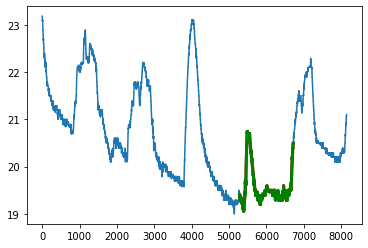

In [0]:
plt.plot(df['Temperature'].values)
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_t)]
for a, c in zip(anoms_t, colors):
    a_shape = df['Temperature'].values[a:a+w]
    plt.plot(range(a, a+w), a_shape, color=c, lw=3)

plt.show()

### CO2

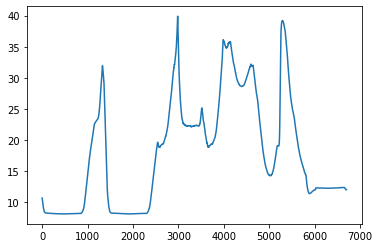

In [0]:
w = 1440
mp_c, mpi_c = matrixProfile.stomp(df['CO2'].values, w)

plt.plot(mp_c)
plt.show()

In [0]:
mo_c, mod_c  = motifs.motifs(df['CO2'].values, (mp_c, mpi_c), max_motifs=5)
mo_c,mod_c

([[461, 1904, 6289], [1182, 2625, 3668, 4389]],
 [8.159125448997404, 18.849366956852368])

In [0]:
df.index[mo_c[0]],df.index[mo_c[1]]

(DatetimeIndex(['2015-02-05 01:32:00', '2015-02-06 01:34:59',
                '2015-02-09 02:39:59'],
               dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-05 13:33:00', '2015-02-06 13:36:00',
                '2015-02-07 06:59:00', '2015-02-07 19:00:00'],
               dtype='datetime64[ns]', name='date', freq=None))

In [0]:
anoms_c = discords(mp_c, ex_zone=3, k=20)
anoms_c, df.index[anoms_c]

(array([2984, 2980, 5293, 5296, 5289, 5299, 5285, 5302, 5281, 5305, 5308,
        5277, 5311, 2987, 5314, 5273, 5317, 5320, 5323, 5269]),
 DatetimeIndex(['2015-02-06 19:34:59', '2015-02-06 19:31:00',
                '2015-02-08 10:04:00', '2015-02-08 10:07:00',
                '2015-02-08 10:00:00', '2015-02-08 10:09:59',
                '2015-02-08 09:55:59', '2015-02-08 10:13:00',
                '2015-02-08 09:52:00', '2015-02-08 10:15:59',
                '2015-02-08 10:19:00', '2015-02-08 09:48:00',
                '2015-02-08 10:21:59', '2015-02-06 19:38:00',
                '2015-02-08 10:25:00', '2015-02-08 09:43:59',
                '2015-02-08 10:27:59', '2015-02-08 10:31:00',
                '2015-02-08 10:34:00', '2015-02-08 09:40:00'],
               dtype='datetime64[ns]', name='date', freq=None))

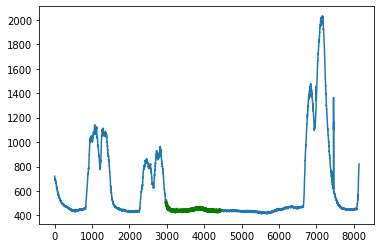

In [0]:
plt.plot(df['CO2'].values)
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_c)]
for a, c in zip(anoms_c, colors):
    a_shape = df['CO2'].values[a:a+w]
    plt.plot(range(a, a+w), a_shape, color=c, lw=3)

plt.show()

### Humidity

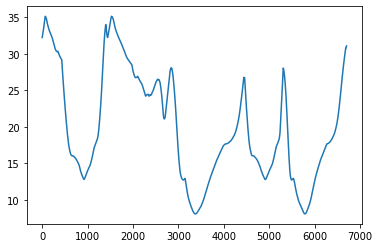

In [0]:
w = 1440
mp_h, mpi_h = matrixProfile.stomp(df['Humidity'].values, w)

plt.plot(mp_h)
plt.show()

In [0]:
mo_h, mod_h  = motifs.motifs(df['Humidity'].values, (mp_h, mpi_h), max_motifs=5)
mo_h, mod_h

([[3376, 5789], [919, 2387, 4910], [4097, 6510], [0, 1640]],
 [8.049355324994355,
  12.771716200272444,
  17.760955879312665,
  32.22742696654316])

In [0]:
df.index[mo_h[0]],df.index[mo_h[1]],df.index[mo_h[2]],df.index[mo_h[3]]

(DatetimeIndex(['2015-02-07 02:06:59', '2015-02-08 18:20:00'], dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-05 09:10:00', '2015-02-06 09:38:00',
                '2015-02-08 03:40:59'],
               dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-07 14:08:00', '2015-02-09 06:21:00'], dtype='datetime64[ns]', name='date', freq=None),
 DatetimeIndex(['2015-02-04 17:51:00', '2015-02-05 21:10:59'], dtype='datetime64[ns]', name='date', freq=None))

In [0]:
anoms_h = discords(mp_h, ex_zone=3, k=20)
anoms_h, df.index[anoms_h]

(array([1530,   68, 1526,   71, 1533, 1536,   74, 1539,   77,   64, 1542,
        1522,   80, 1545,   83, 1548, 1518, 1551,   86, 1554]),
 DatetimeIndex(['2015-02-05 19:21:00', '2015-02-04 18:59:00',
                '2015-02-05 19:17:00', '2015-02-04 19:01:59',
                '2015-02-05 19:24:00', '2015-02-05 19:27:00',
                '2015-02-04 19:05:00', '2015-02-05 19:30:00',
                '2015-02-04 19:08:00', '2015-02-04 18:55:00',
                '2015-02-05 19:33:00', '2015-02-05 19:13:00',
                '2015-02-04 19:11:00', '2015-02-05 19:36:00',
                '2015-02-04 19:14:00', '2015-02-05 19:38:59',
                '2015-02-05 19:08:59', '2015-02-05 19:41:59',
                '2015-02-04 19:17:00', '2015-02-05 19:45:00'],
               dtype='datetime64[ns]', name='date', freq=None))

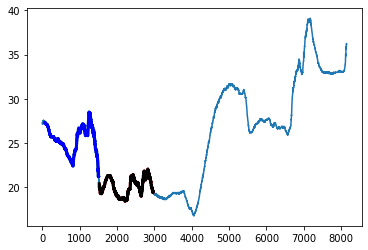

In [0]:
plt.plot(df['Humidity'].values)
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_h)]
for a, c in zip(anoms_h, colors):
    a_shape = df['Humidity'].values[a:a+w]
    plt.plot(range(a, a+w), a_shape, color=c, lw=3)

plt.show()

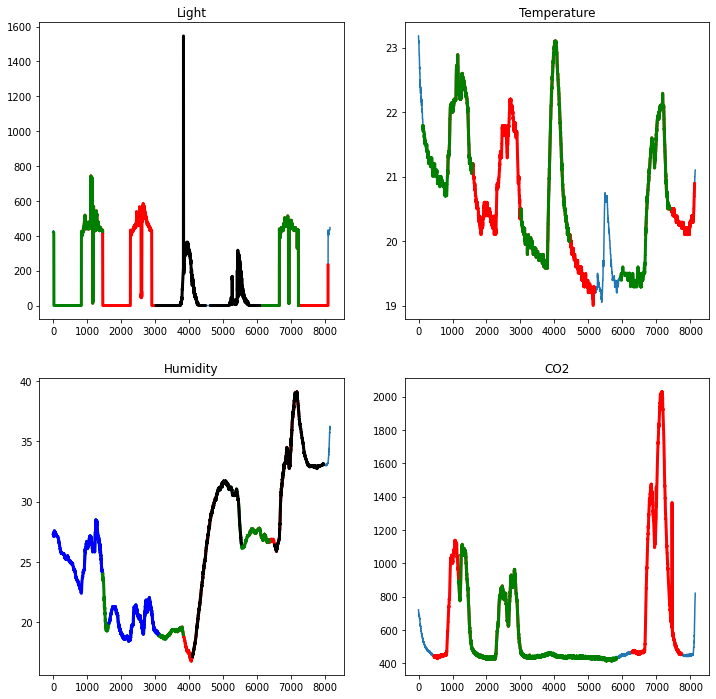

In [0]:
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_h)]

fig, ax = plt.subplots(2, 2,figsize=(12,12))
ax[0,0].plot(df['Light'].values)
ax[0,0].set_title('Light')
for m, d, c in zip(mo_l, mod_l, colors):
    for i in m:
        m_shape = df['Light'].values[i:i+w]
        ax[0,0].plot(range(i,i+w), m_shape, color=c, lw=3)

ax[0,1].plot(df['Temperature'].values)
ax[0,1].set_title('Temperature')
for m, d, c in zip(mo_t, mod_t, colors):
    for i in m:
        m_shape = df['Temperature'].values[i:i+w]
        ax[0,1].plot(range(i,i+w), m_shape, color=c, lw=3)

ax[1,0].plot(df['Humidity'].values)
ax[1,0].set_title('Humidity')
for m, d, c in zip(mo_h, mod_h, colors):
    for i in m:
        m_shape = df['Humidity'].values[i:i+w]
        ax[1,0].plot(range(i,i+w), m_shape, color=c, lw=3)

ax[1,1].plot(df['CO2'].values)
ax[1,1].set_title('CO2')
for m, d, c in zip(mo_c, mod_c, colors):
    for i in m:
        m_shape = df['CO2'].values[i:i+w]
        ax[1,1].plot(range(i,i+w), m_shape, color=c, lw=3)

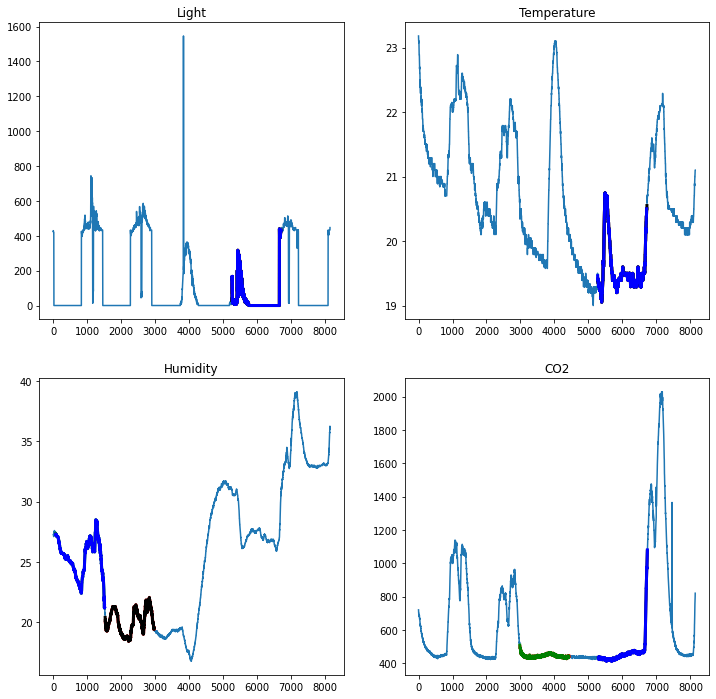

In [0]:
colors = ['r', 'g', 'k', 'b', 'y'][:len(mo_h)]

fig, ax = plt.subplots(2, 2,figsize=(12,12))
ax[0,0].plot(df['Light'].values)
ax[0,0].set_title('Light')
for a, c in zip(anoms_l, colors):
    a_shape = df['Light'].values[a:a+w]
    ax[0,0].plot(range(a,a+w), a_shape, color=c, lw=3)


ax[0,1].plot(df['Temperature'].values)
ax[0,1].set_title('Temperature')
for a, c in zip(anoms_t, colors):
    a_shape = df['Temperature'].values[a:a+w]
    ax[0,1].plot(range(a,a+w), a_shape, color=c, lw=3)


ax[1,0].plot(df['Humidity'].values)
ax[1,0].set_title('Humidity')
for a, c in zip(anoms_h, colors):
    a_shape = df['Humidity'].values[a:a+w]
    ax[1,0].plot(range(a,a+w), a_shape, color=c, lw=3)


ax[1,1].plot(df['CO2'].values)
ax[1,1].set_title('CO2')
for a, c in zip(anoms_c, colors):
    a_shape = df['CO2'].values[a:a+w]
    ax[1,1].plot(range(a,a+w), a_shape, color=c, lw=3)


# Feature Humidity as univariate framework

In [0]:
url = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatraining.csv'
df = pd.read_csv(url) 

In [0]:
df['date'] = pd.to_datetime(df['date'])

In [0]:
df = df.set_index(['date'])

In [0]:
df = df[['Humidity','Occupancy']]
df.head()

,Humidity,Occupancy
date,,
2015-02-04 17:51:00,27.2720,1
2015-02-04 17:51:59,27.2675,1
2015-02-04 17:53:00,27.2450,1
2015-02-04 17:54:00,27.2000,1
2015-02-04 17:55:00,27.2000,1


In [0]:
day_4_02 = df['2015-02-04']
day_5_02 = df['2015-02-05']
day_6_02 = df['2015-02-06']
day_7_02 = df['2015-02-07']
day_8_02 = df['2015-02-08']
day_9_02 = df['2015-02-09']
day_10_02 = df['2015-02-10']

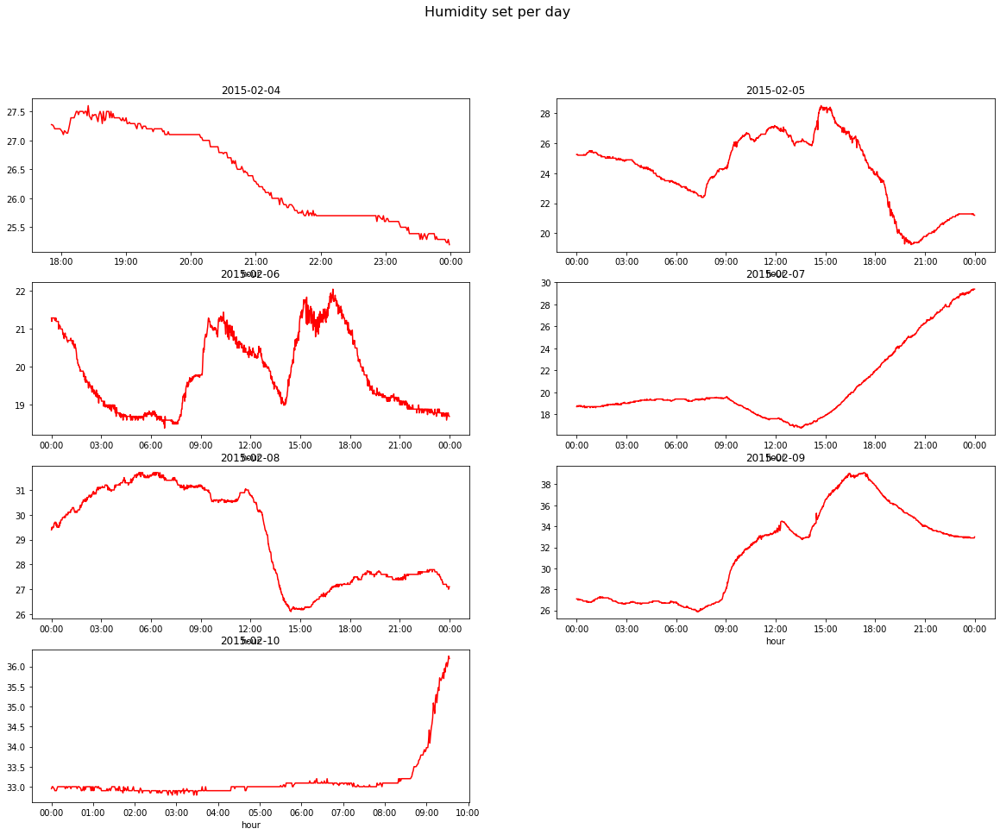

In [0]:
import matplotlib.dates as mdates

fig, axs = plt.subplots(4, 2, figsize=(20,15))
axs[-1, -1].axis('off')
fig.suptitle('Humidity set per day', fontsize=16)
xfmt = mdates.DateFormatter('%H:%M')

axs[0,0].plot(day_4_02['Humidity'],c ='r')
axs[0,0].xaxis.set_major_formatter(xfmt)
axs[0,0].set_xlabel('hour')
axs[0,0].set_title('2015-02-04')

axs[0,1].plot(day_5_02['Humidity'],c ='r')
axs[0,1].xaxis.set_major_formatter(xfmt)
axs[0,1].set_xlabel('hour')
axs[0,1].set_title('2015-02-05')

axs[1,0].plot(day_6_02['Humidity'],c ='r')
axs[1,0].xaxis.set_major_formatter(xfmt)
axs[1,0].set_xlabel('hour')
axs[1,0].set_title('2015-02-06')

axs[1,1].plot(day_7_02['Humidity'],c ='r')
axs[1,1].xaxis.set_major_formatter(xfmt)
axs[1,1].set_xlabel('hour')
axs[1,1].set_title('2015-02-07')

axs[2,0].plot(day_8_02['Humidity'],c ='r')
axs[2,0].xaxis.set_major_formatter(xfmt)
axs[2,0].set_xlabel('hour')
axs[2,0].set_title('2015-02-08')

axs[2,1].plot(day_9_02['Humidity'],c ='r')
axs[2,1].xaxis.set_major_formatter(xfmt)
axs[2,1].set_xlabel('hour')
axs[2,1].set_title('2015-02-09')

axs[3,0].plot(day_10_02['Humidity'],c ='r')
axs[3,0].xaxis.set_major_formatter(xfmt)
axs[3,0].set_xlabel('hour')
axs[3,0].set_title('2015-02-10')

plt.show()

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

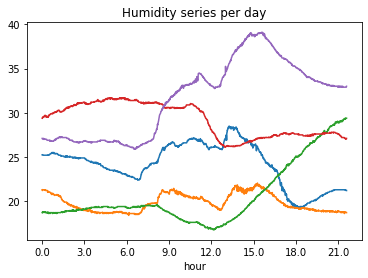

In [0]:
plt.plot(day_5_02['Humidity'])
plt.plot(day_6_02['Humidity'])
plt.plot(day_7_02['Humidity'])
plt.plot(day_8_02['Humidity'])
plt.plot(day_9_02['Humidity'])
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.title('Humidity series per day')
plt.show()

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

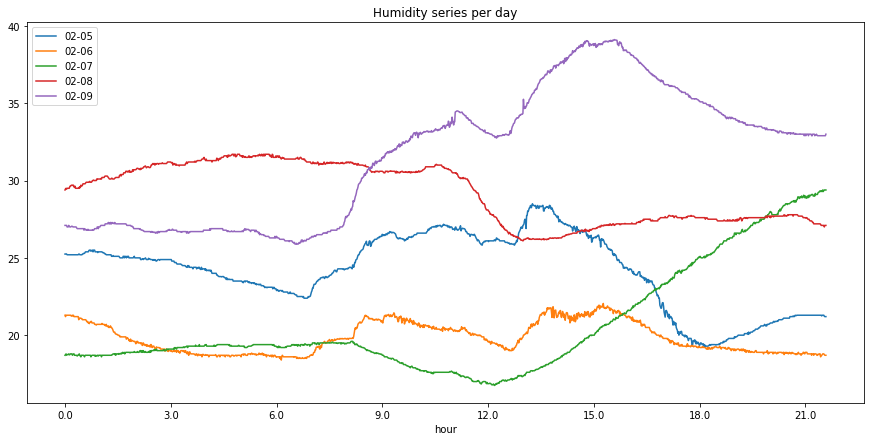

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02['Humidity'])
plt.plot(day_6_02['Humidity'])
plt.plot(day_7_02['Humidity'])
plt.plot(day_8_02['Humidity'])
plt.plot(day_9_02['Humidity'])
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'], loc = 'upper left')
plt.title('Humidity series per day')
plt.show()

## Offset Translation : non è una buona trasformazione

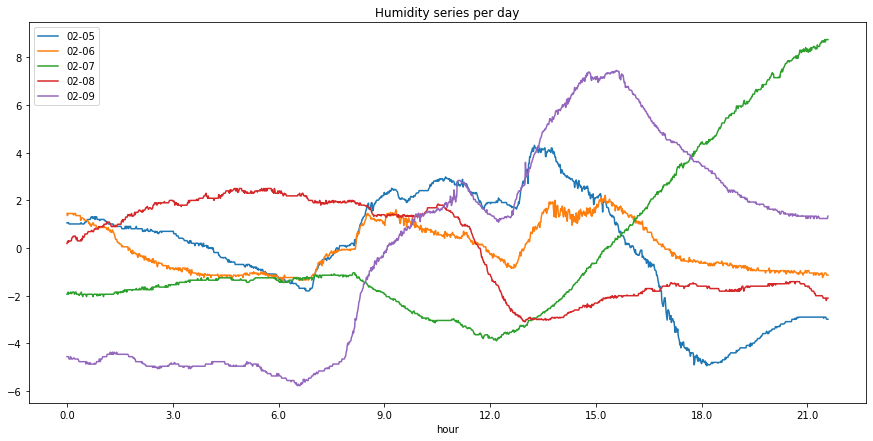

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02['Humidity']-day_5_02['Humidity'].mean())
plt.plot(day_6_02['Humidity']-day_6_02['Humidity'].mean())
plt.plot(day_7_02['Humidity']-day_7_02['Humidity'].mean())
plt.plot(day_8_02['Humidity']-day_8_02['Humidity'].mean())
plt.plot(day_9_02['Humidity']-day_9_02['Humidity'].mean())
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Humidity series per day')
plt.show()

## Amplitude Scaling : non è una buona trasformazione

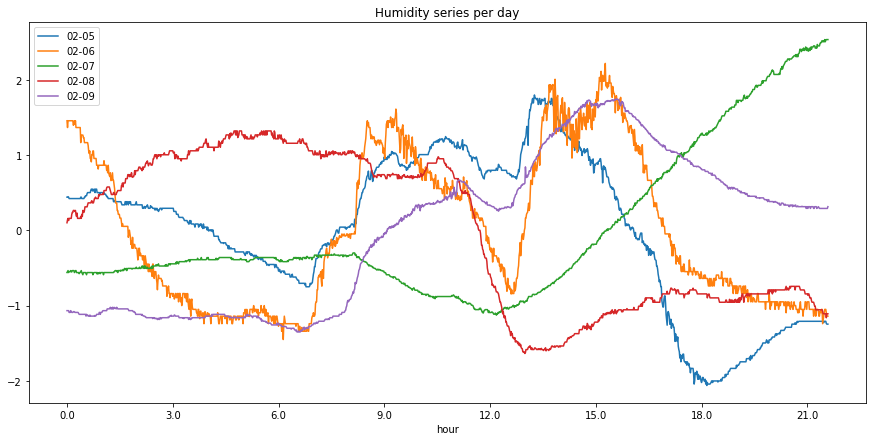

In [0]:
plt.figure(figsize=(15,7))
plt.plot((day_5_02['Humidity']-day_5_02['Humidity'].mean())/day_5_02['Humidity'].std())
plt.plot((day_6_02['Humidity']-day_6_02['Humidity'].mean())/day_6_02['Humidity'].std())
plt.plot((day_7_02['Humidity']-day_7_02['Humidity'].mean())/day_7_02['Humidity'].std())
plt.plot((day_8_02['Humidity']-day_8_02['Humidity'].mean())/day_8_02['Humidity'].std())
plt.plot((day_9_02['Humidity']-day_9_02['Humidity'].mean())/day_9_02['Humidity'].std())
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Humidity series per day')
plt.show()

## Linear Trend

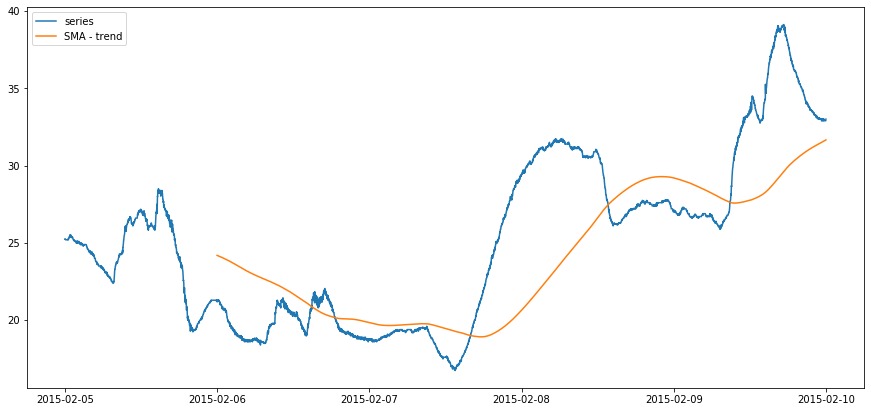

In [0]:
ts = df['Humidity'].loc['2015-02-05':'2015-02-09']
sma = ts.rolling(window = 1440).mean()       #simple moving average
plt.figure(figsize=(15,7))
plt.plot(ts)
plt.plot(sma)
plt.legend(['series','SMA - trend'], loc = 'upper left')   # perchè in un giorno ci sono 1440 min
plt.show()

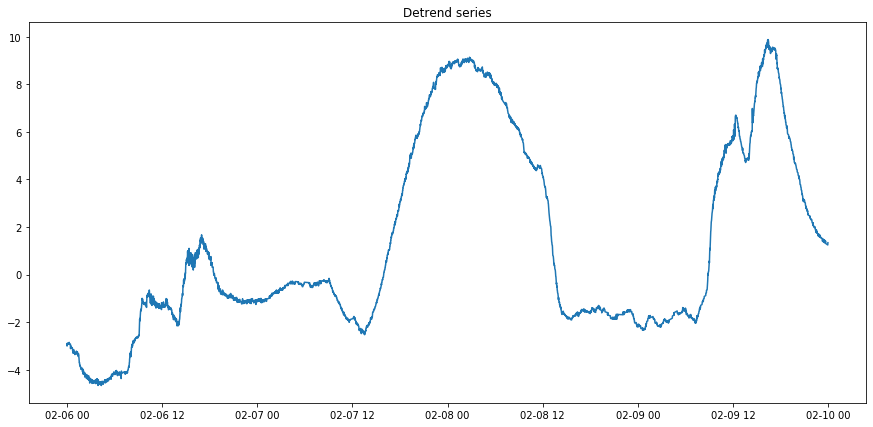

In [0]:
plt.figure(figsize=(15,7))
ts_shift = ts - sma
plt.plot(ts_shift)
plt.title('Detrend series')
plt.show()

## Noise

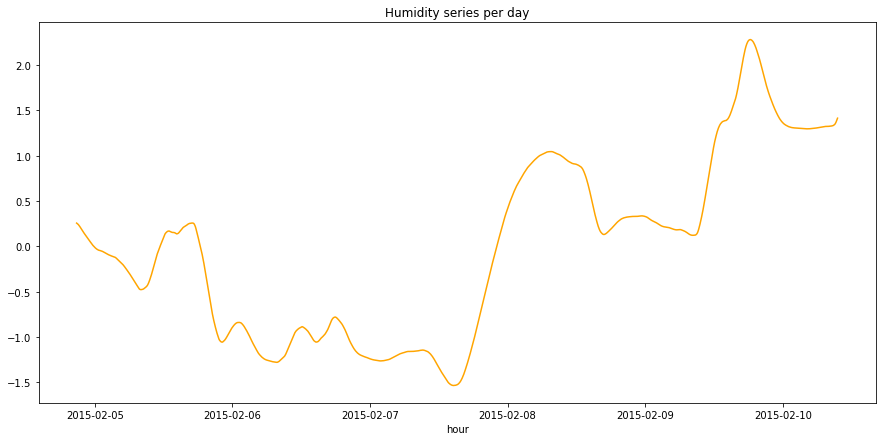

In [0]:
w = 180
plt.figure(figsize=(15,7))
df_denoised = ((df['Humidity']-df['Humidity'].mean())/df['Humidity'].std()).rolling(window=w).mean()
plt.plot(df_denoised, c = 'orange')
plt.xlabel('hour')
plt.title('Humidity series per day')
plt.show()

## Trend on Denoised

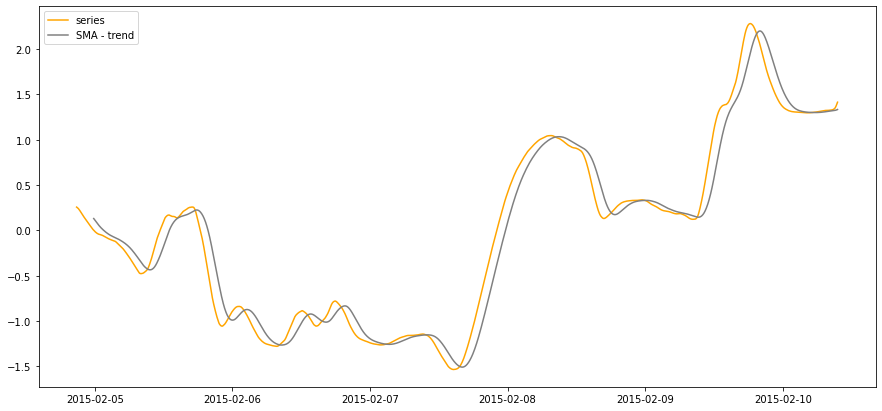

In [0]:
ts = df_denoised.loc['2015-02-04':'2015-02-10']
sma = ts.rolling(window = 180).mean()       #simple moving average
plt.figure(figsize=(15,7))
plt.plot(ts, c ='orange')
plt.plot(sma, c = 'grey')
plt.legend(['series','SMA - trend'], loc = 'upper left')   
plt.show()

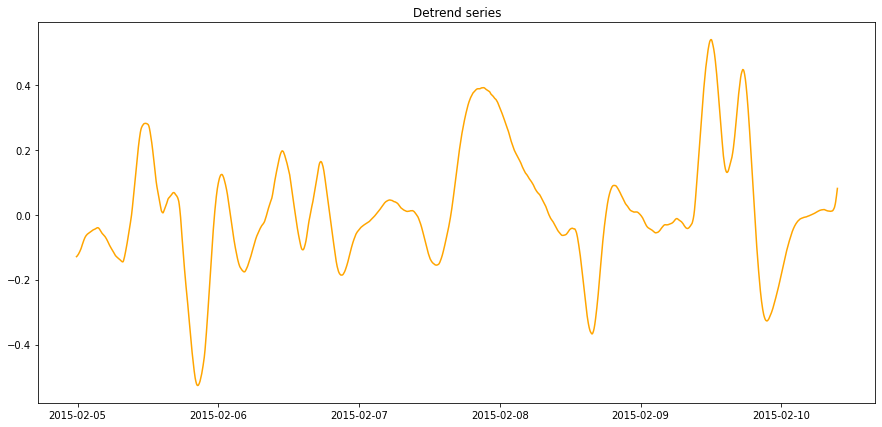

In [0]:
plt.figure(figsize=(15,7))
ts_shift = ts - sma
plt.plot(ts_shift, c = 'orange')
plt.title('Detrend series')
plt.show()

In [0]:
day_4_02 = ts_shift['2015-02-04']
day_5_02 = ts_shift['2015-02-05']
day_6_02 = ts_shift['2015-02-06']
day_7_02 = ts_shift['2015-02-07']
day_8_02 = ts_shift['2015-02-08']
day_9_02 = ts_shift['2015-02-09']
day_10_02 = ts_shift['2015-02-10']

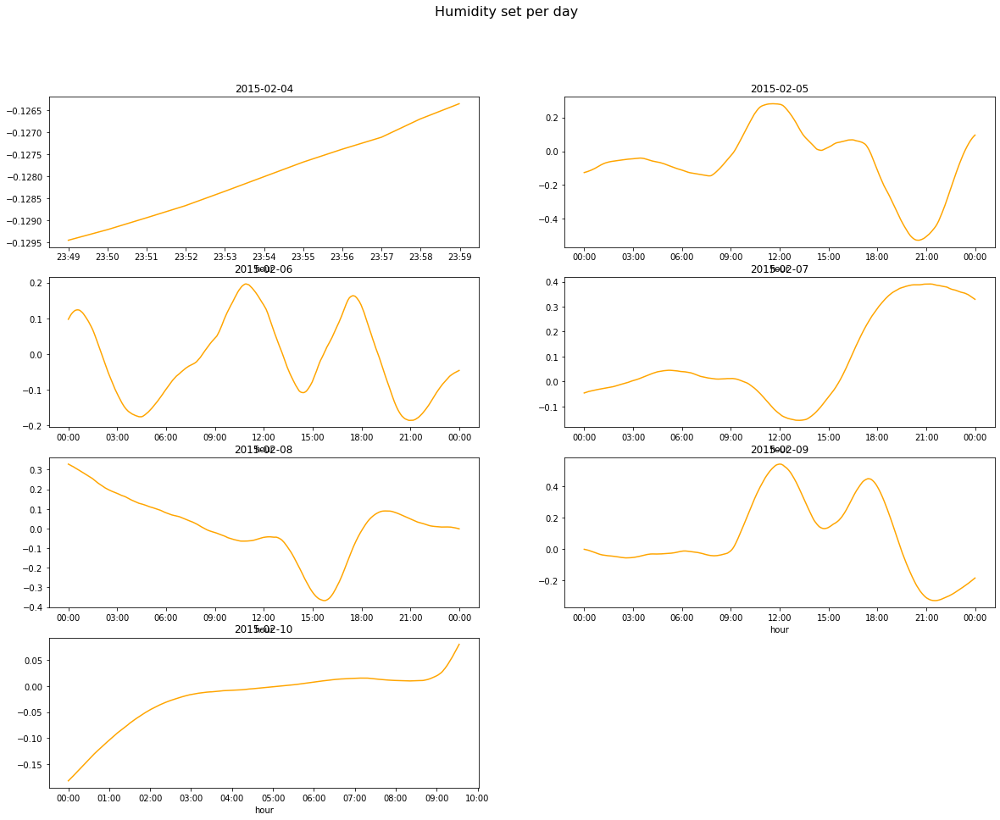

In [0]:
import matplotlib.dates as mdates

fig, axs = plt.subplots(4, 2, figsize=(20,15))
axs[-1, -1].axis('off')
fig.suptitle('Humidity set per day', fontsize=16)
xfmt = mdates.DateFormatter('%H:%M')

axs[0,0].plot(day_4_02,c ='orange')
axs[0,0].xaxis.set_major_formatter(xfmt)
axs[0,0].set_xlabel('hour')
axs[0,0].set_title('2015-02-04')

axs[0,1].plot(day_5_02,c ='orange')
axs[0,1].xaxis.set_major_formatter(xfmt)
axs[0,1].set_xlabel('hour')
axs[0,1].set_title('2015-02-05')

axs[1,0].plot(day_6_02,c ='orange')
axs[1,0].xaxis.set_major_formatter(xfmt)
axs[1,0].set_xlabel('hour')
axs[1,0].set_title('2015-02-06')

axs[1,1].plot(day_7_02,c ='orange')
axs[1,1].xaxis.set_major_formatter(xfmt)
axs[1,1].set_xlabel('hour')
axs[1,1].set_title('2015-02-07')

axs[2,0].plot(day_8_02,c ='orange')
axs[2,0].xaxis.set_major_formatter(xfmt)
axs[2,0].set_xlabel('hour')
axs[2,0].set_title('2015-02-08')

axs[2,1].plot(day_9_02,c ='orange')
axs[2,1].xaxis.set_major_formatter(xfmt)
axs[2,1].set_xlabel('hour')
axs[2,1].set_title('2015-02-09')

axs[3,0].plot(day_10_02,c ='orange')
axs[3,0].xaxis.set_major_formatter(xfmt)
axs[3,0].set_xlabel('hour')
axs[3,0].set_title('2015-02-10')

plt.show()

## Euclidean distance

In [0]:
from scipy.spatial.distance import euclidean

In [0]:
dist_eucl_day5_day6 = euclidean(day_5_02, day_6_02)

dist_eucl_day5_day7 = euclidean(day_5_02, day_7_02)

dist_eucl_day5_day8 = euclidean(day_5_02, day_8_02)

dist_eucl_day5_day9 = euclidean(day_5_02, day_9_02)

dist_eucl_day6_day7 = euclidean(day_6_02, day_7_02)

dist_eucl_day6_day8 = euclidean(day_6_02, day_8_02)

dist_eucl_day6_day9 = euclidean(day_6_02, day_9_02)

dist_eucl_day7_day8 = euclidean(day_7_02, day_8_02)

dist_eucl_day7_day9 = euclidean(day_7_02, day_9_02)

dist_eucl_day8_day9 = euclidean(day_8_02, day_9_02)

In [0]:
from prettytable import PrettyTable

table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_eucl_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_eucl_day5_day7, dist_eucl_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_eucl_day5_day8, dist_eucl_day6_day8, dist_eucl_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_eucl_day5_day9, dist_eucl_day6_day9, dist_eucl_day7_day9,dist_eucl_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+--------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02      | day_9_02 |
+----------+--------------------+--------------------+--------------------+--------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -          |    -     |
| day_6_02 | 6.238868542590936  |         0          |         -          |         -          |    -     |
| day_7_02 | 14.559720060821759 | 9.964232998630806  |         0          |         -          |    -     |
| day_8_02 | 11.480561256232562 | 7.8896507310472614 | 9.017792865401198  |         0          |    -     |
| day_9_02 |  8.12264208899582  | 7.326035895013481  | 13.823059235953897 | 13.097787602499098 |    0     |
+----------+--------------------+--------------------+--------------------+--------------------+----------+


## Manhattan distance

In [0]:
from scipy.spatial.distance import cityblock

In [0]:
dist_city_day5_day6 = cityblock(day_5_02, day_6_02)

dist_city_day5_day7 = cityblock(day_5_02, day_7_02)

dist_city_day5_day8 = cityblock(day_5_02, day_8_02)

dist_city_day5_day9 = cityblock(day_5_02, day_9_02)

dist_city_day6_day7 = cityblock(day_6_02, day_7_02)

dist_city_day6_day8 = cityblock(day_6_02, day_8_02)

dist_city_day6_day9 = cityblock(day_6_02, day_9_02)

dist_city_day7_day8 = cityblock(day_7_02, day_8_02)

dist_city_day7_day9 = cityblock(day_7_02, day_9_02)

dist_city_day8_day9 = cityblock(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_city_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_city_day5_day7, dist_city_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_city_day5_day8, dist_city_day6_day8, dist_city_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_city_day5_day9, dist_city_day6_day9, dist_city_day7_day9,dist_city_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+--------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02      | day_9_02 |
+----------+--------------------+--------------------+--------------------+--------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -          |    -     |
| day_6_02 | 191.2810512231373  |         0          |         -          |         -          |    -     |
| day_7_02 | 399.06336684963867 | 286.00518350574276 |         0          |         -          |    -     |
| day_8_02 | 386.35257162683666 | 265.9830169067923  | 278.22803744743715 |         0          |    -     |
| day_9_02 | 235.51189733708702 | 228.5012821416712  | 387.66621488146853 | 430.10184034508023 |    0     |
+----------+--------------------+--------------------+--------------------+--------------------+----------+


## Dynamic Time Warping

In [0]:
pip install tslearn

In [0]:
from tslearn.metrics import dtw, dtw_path, cdist_dtw, subsequence_cost_matrix

In [0]:
dist_dtw_day5_day6 = dtw(day_5_02, day_6_02)

dist_dtw_day5_day7 = dtw(day_5_02, day_7_02)

dist_dtw_day5_day8 = dtw(day_5_02, day_8_02)

dist_dtw_day5_day9 = dtw(day_5_02, day_9_02)

dist_dtw_day6_day7 = dtw(day_6_02, day_7_02)

dist_dtw_day6_day8 = dtw(day_6_02, day_8_02)

dist_dtw_day6_day9 = dtw(day_6_02, day_9_02)

dist_dtw_day7_day8 = dtw(day_7_02, day_8_02)

dist_dtw_day7_day9 = dtw(day_7_02, day_9_02)

dist_dtw_day8_day9 = dtw(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_dtw_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_dtw_day5_day7, dist_dtw_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_dtw_day5_day8, dist_dtw_day6_day8, dist_dtw_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_dtw_day5_day9, dist_dtw_day6_day9, dist_dtw_day7_day9,dist_dtw_day8_day9,0])

print(table)

+----------+-------------------+-------------------+--------------------+-------------------+----------+
|   Days   |      day_5_02     |      day_6_02     |      day_7_02      |      day_8_02     | day_9_02 |
+----------+-------------------+-------------------+--------------------+-------------------+----------+
| day_5_02 |         0         |         -         |         -          |         -         |    -     |
| day_6_02 | 4.620853982276702 |         0         |         -          |         -         |    -     |
| day_7_02 |  7.45819434393962 | 8.840468452341439 |         0          |         -         |    -     |
| day_8_02 | 6.486768534765356 | 3.944868849575347 |  7.6801950126151   |         0         |    -     |
| day_9_02 | 4.264600200952789 | 5.302164748614152 | 10.103570598859132 | 8.537372489448606 |    0     |
+----------+-------------------+-------------------+--------------------+-------------------+----------+


###### Day 5 and Day 6

In [0]:
path, dist = dtw_path(day_5_02[::30], day_6_02[::30])

In [0]:
from scipy.spatial.distance import cdist

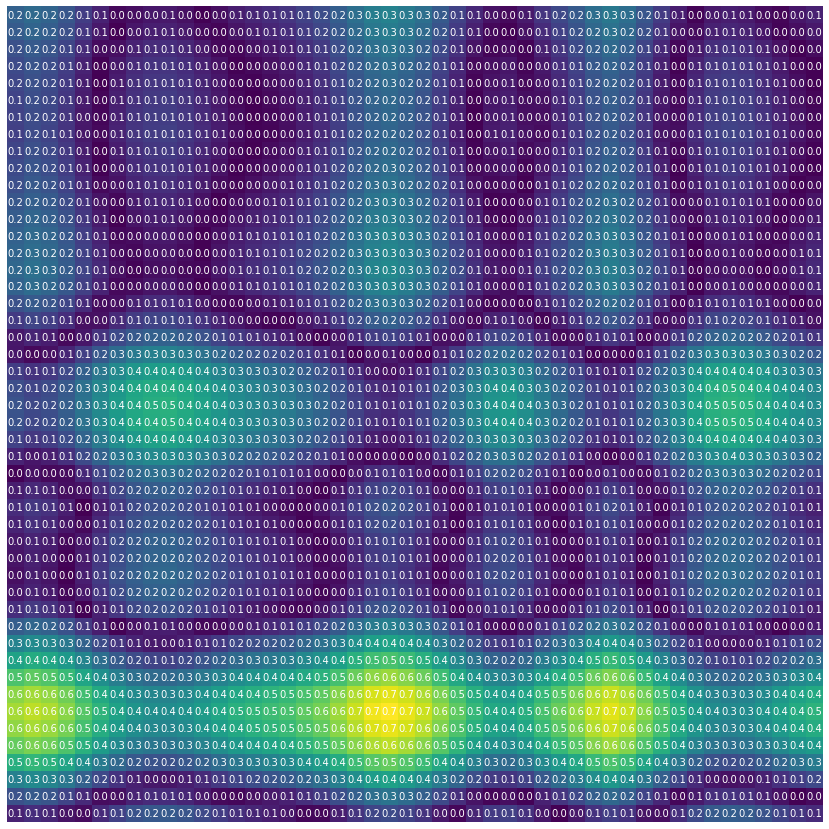

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

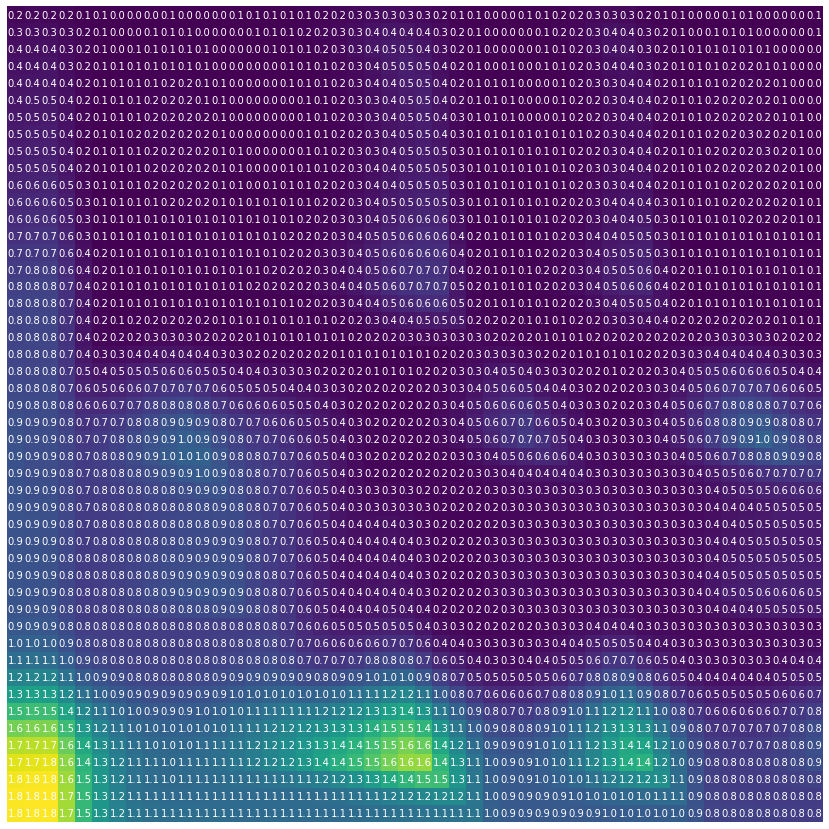

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

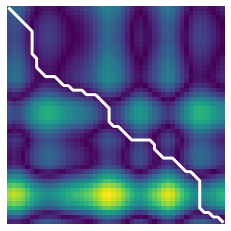

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 7

In [0]:
path, dist = dtw_path(day_5_02[::30], day_7_02[::30])

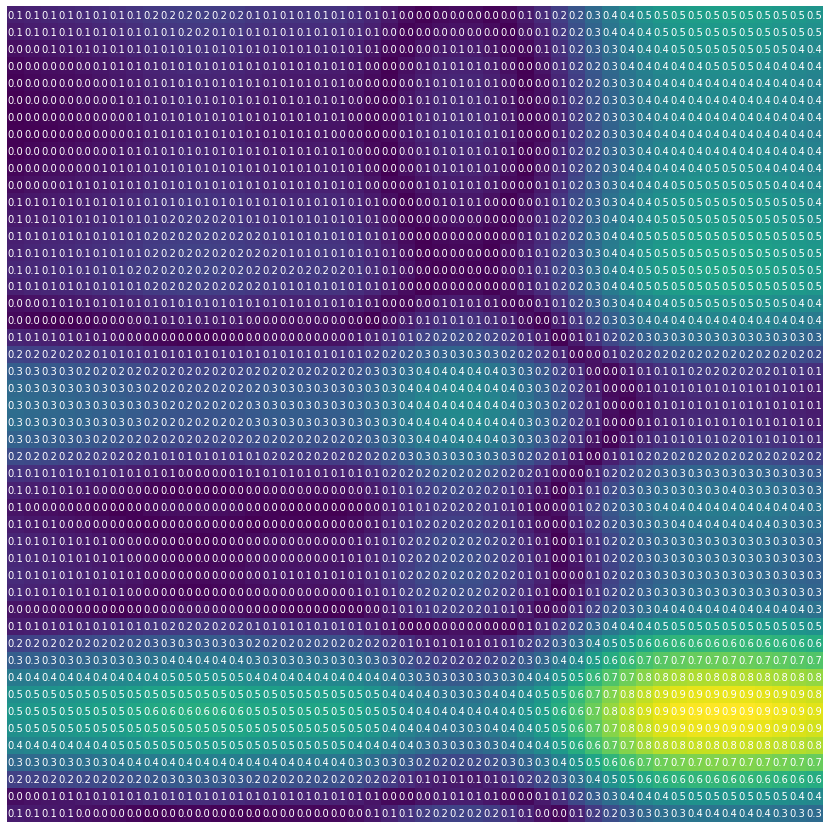

In [0]:
mat = cdist(day_5_02[::30].values.reshape(-1,1),  day_7_02[::30].values.reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

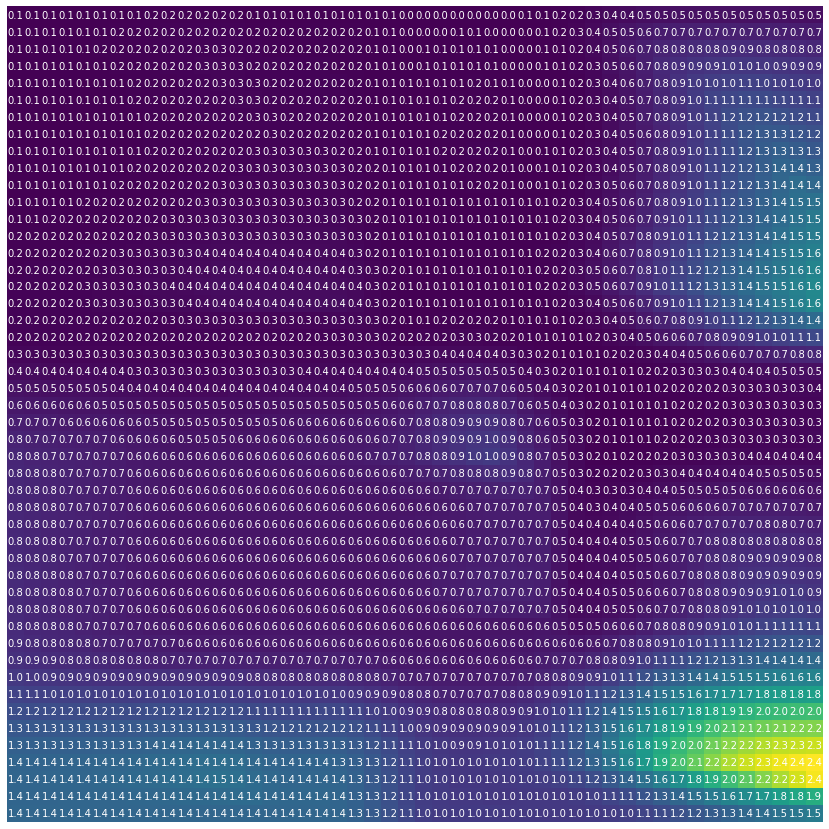

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

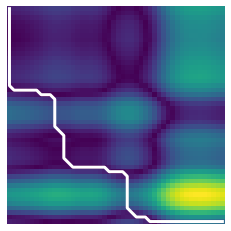

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 8

In [0]:
path, dist = dtw_path(day_5_02[::30], day_8_02[::30])

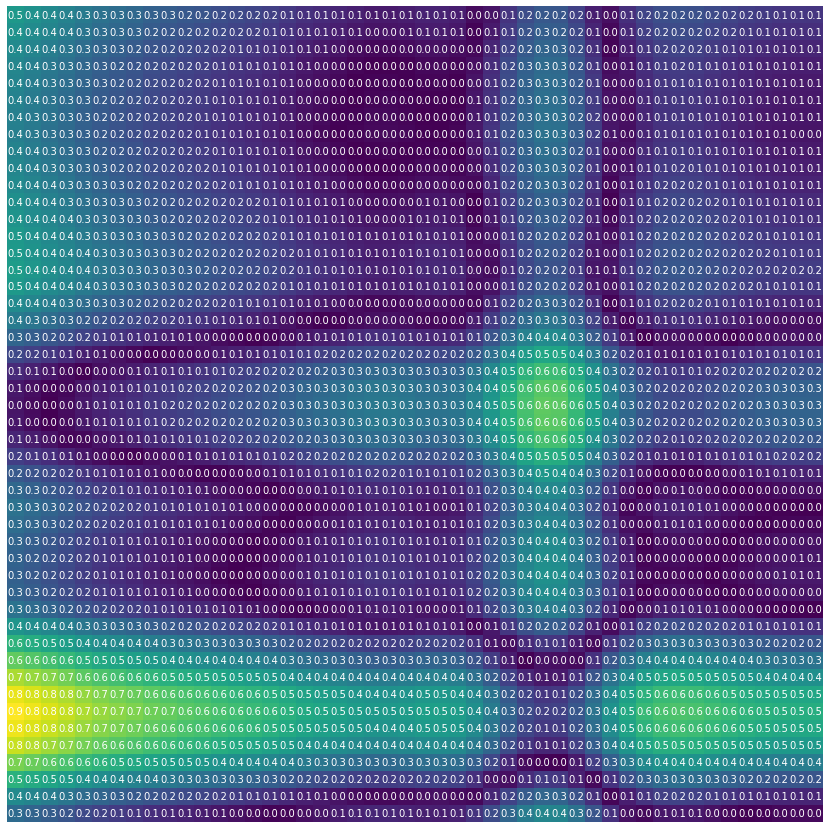

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

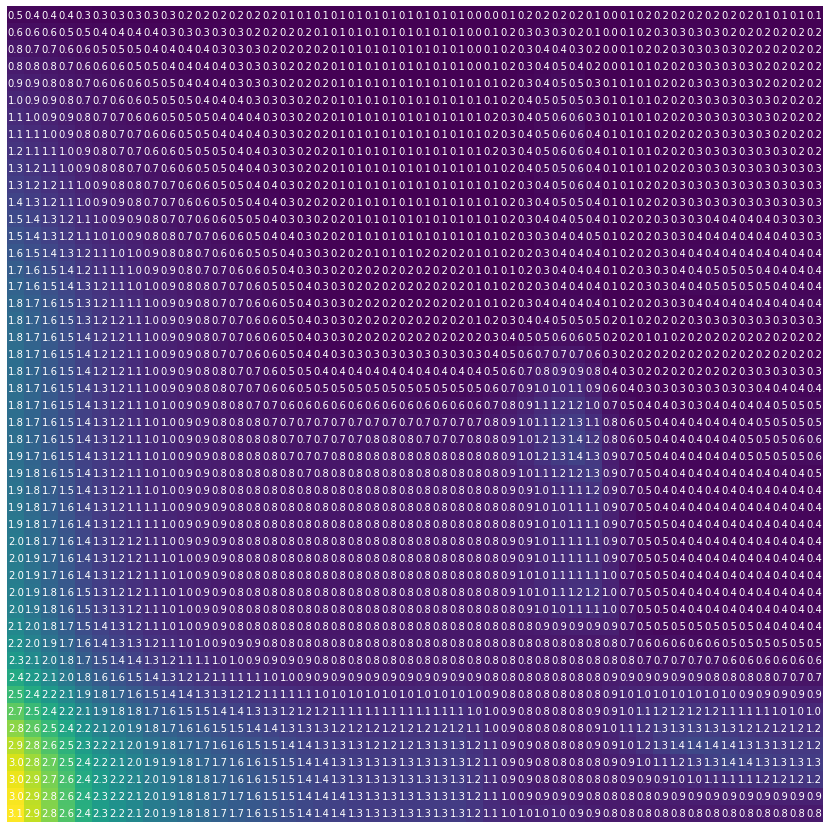

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

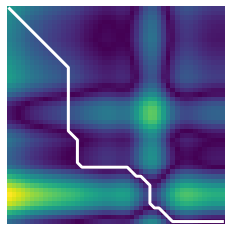

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 9

In [0]:
path, dist = dtw_path(day_5_02[::30], day_9_02[::30])

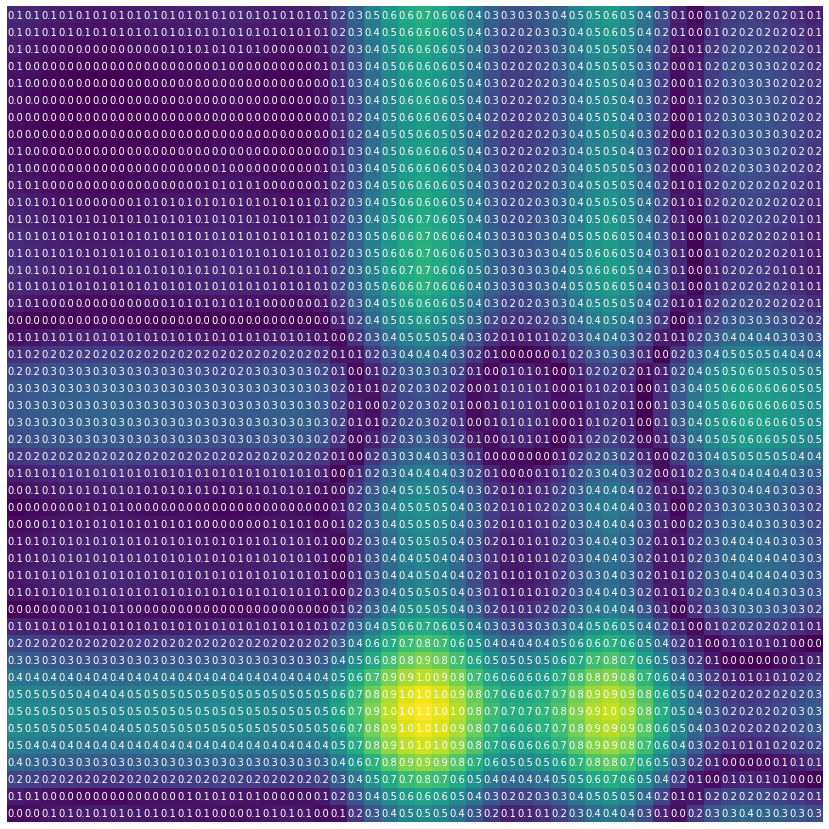

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

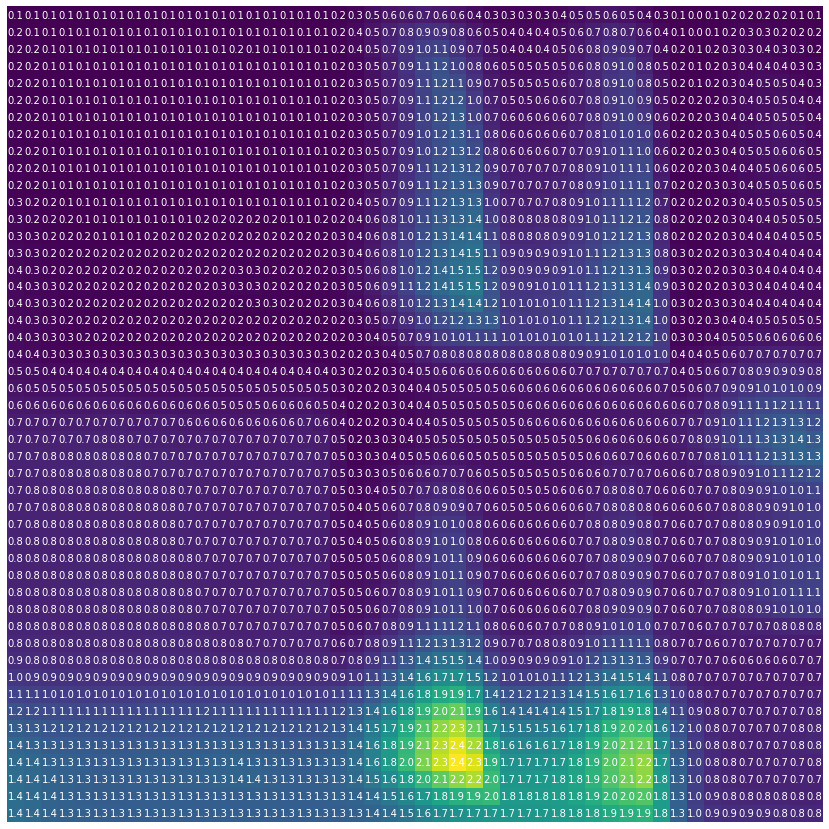

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

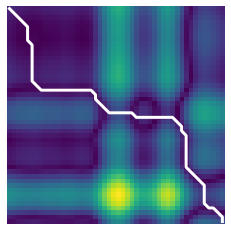

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 7

In [0]:
path, dist = dtw_path(day_6_02[::30], day_7_02[::30])

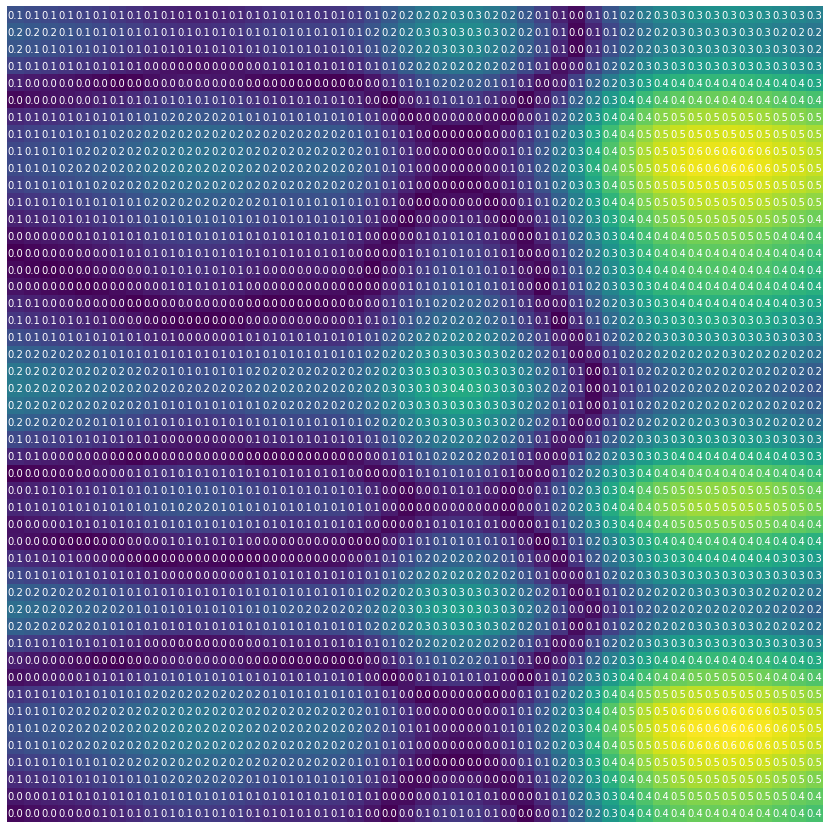

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

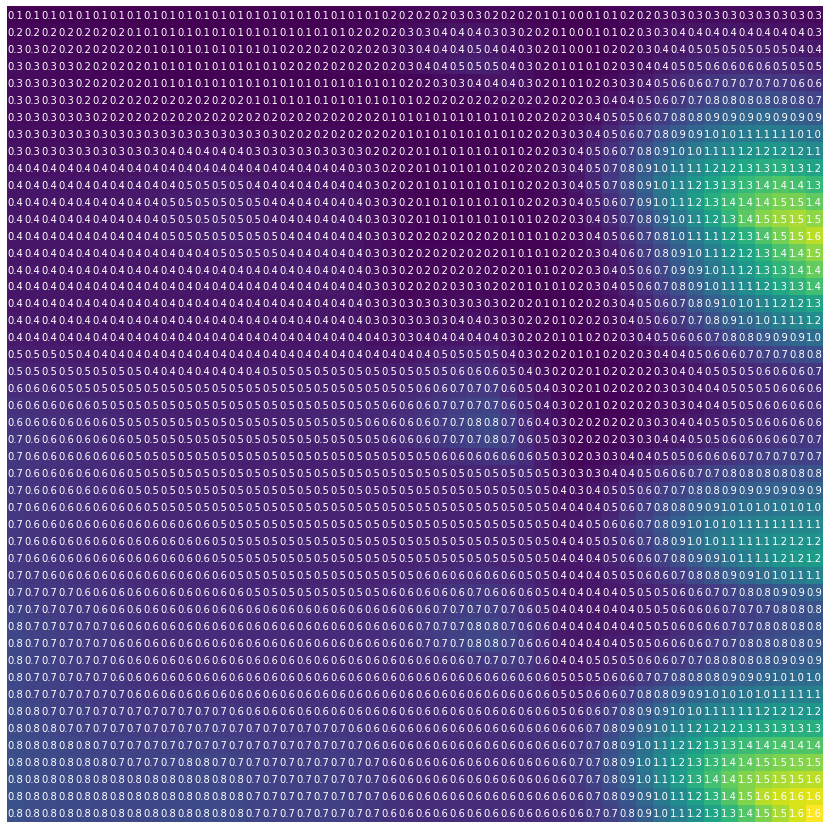

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

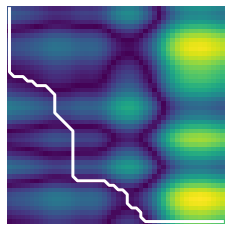

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 8

In [0]:
path, dist = dtw_path(day_6_02[::30], day_8_02[::30])

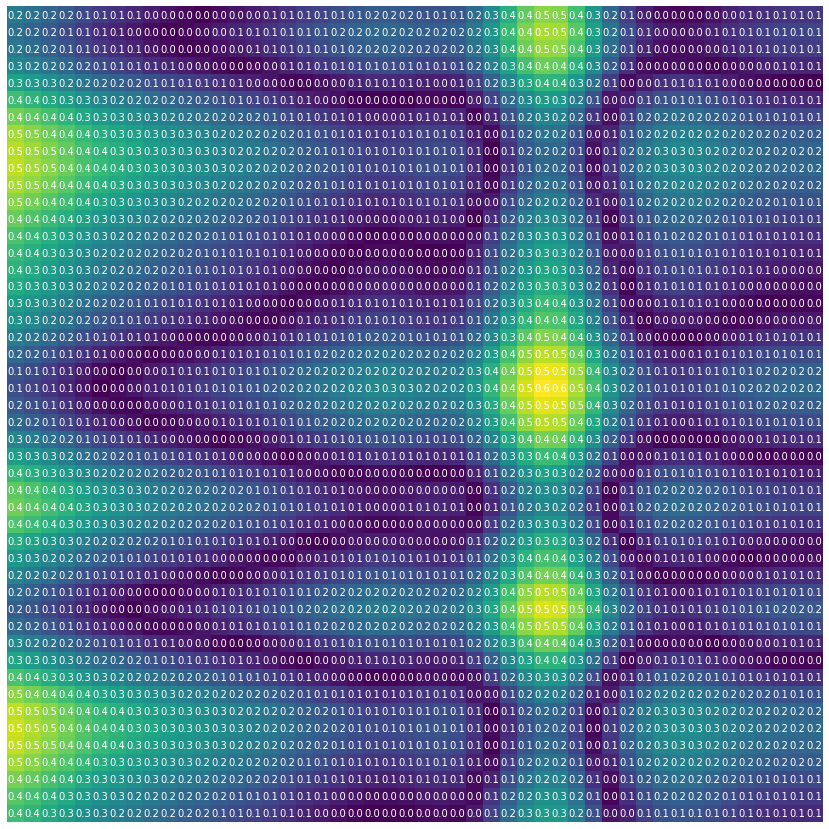

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

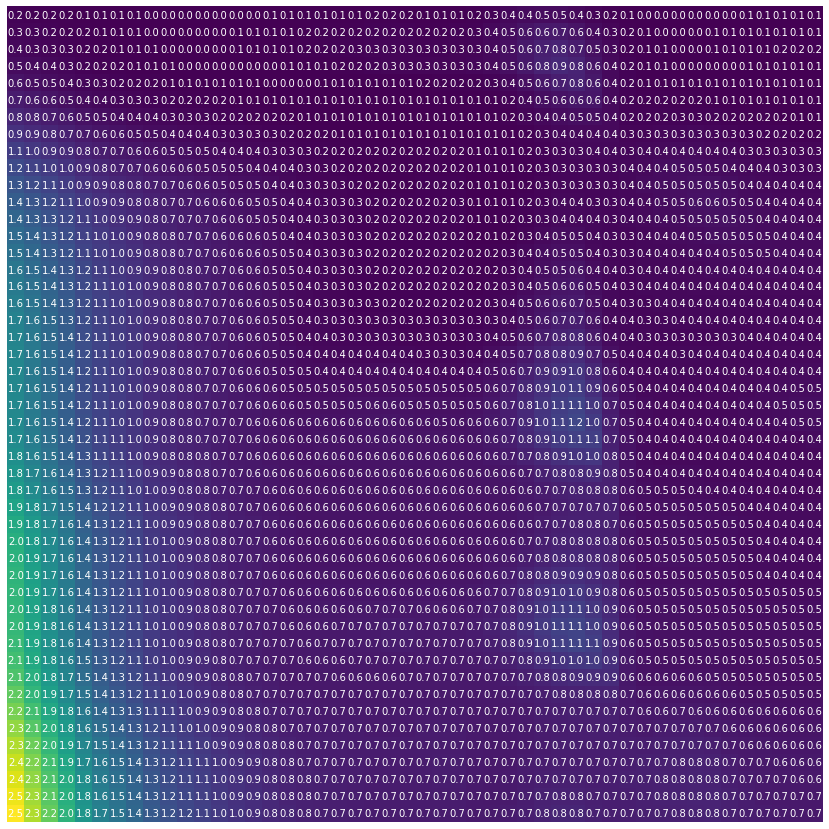

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

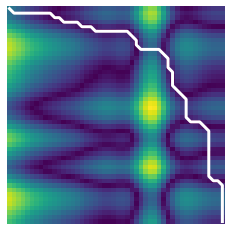

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 9

In [0]:
path, dist = dtw_path(day_6_02[::30], day_9_02[::30])

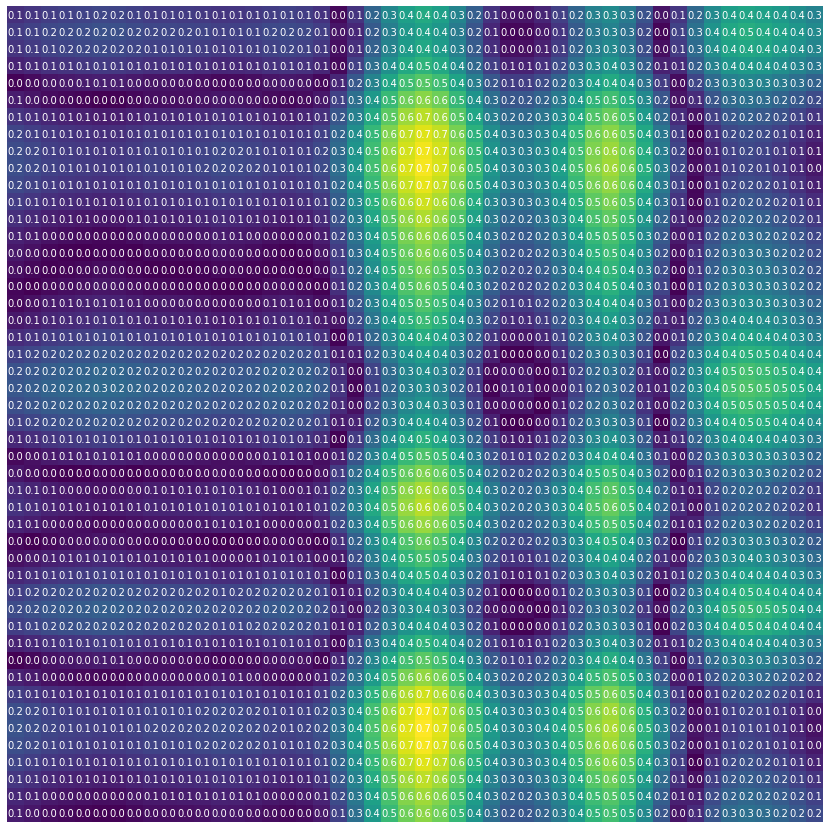

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

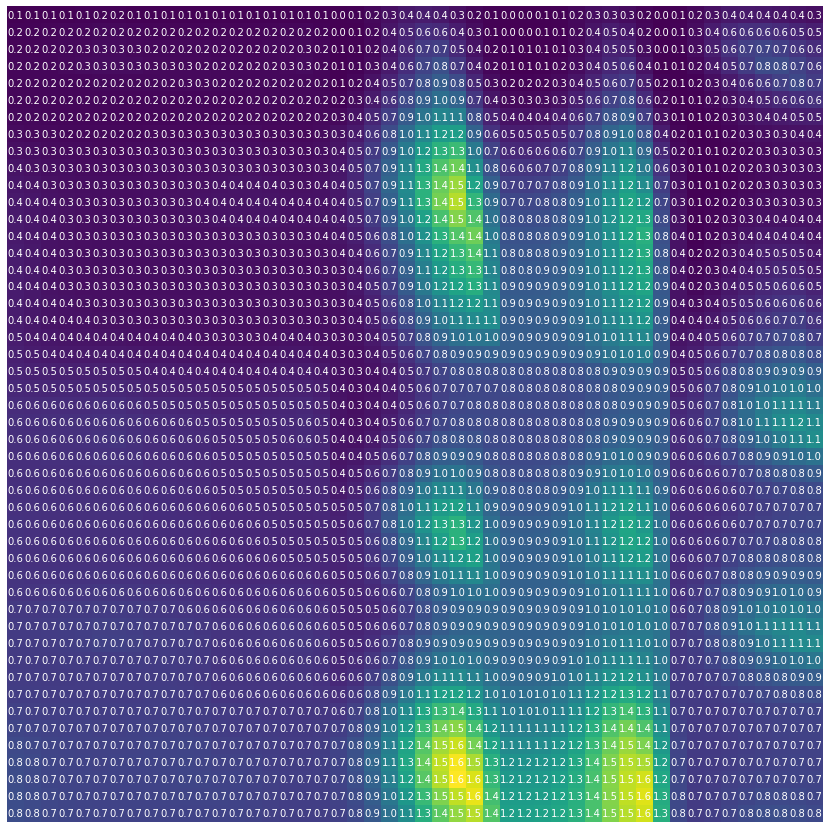

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

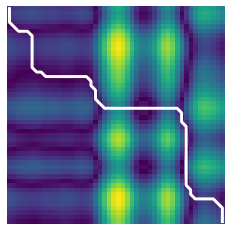

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 8

In [0]:
path, dist = dtw_path(day_7_02[::30], day_8_02[::30])

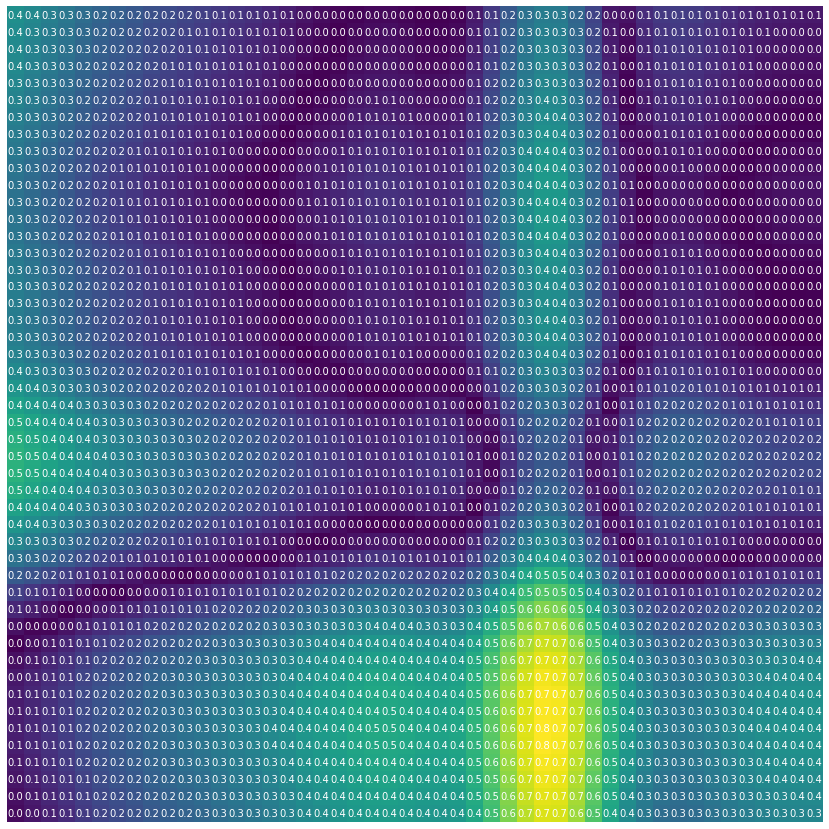

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

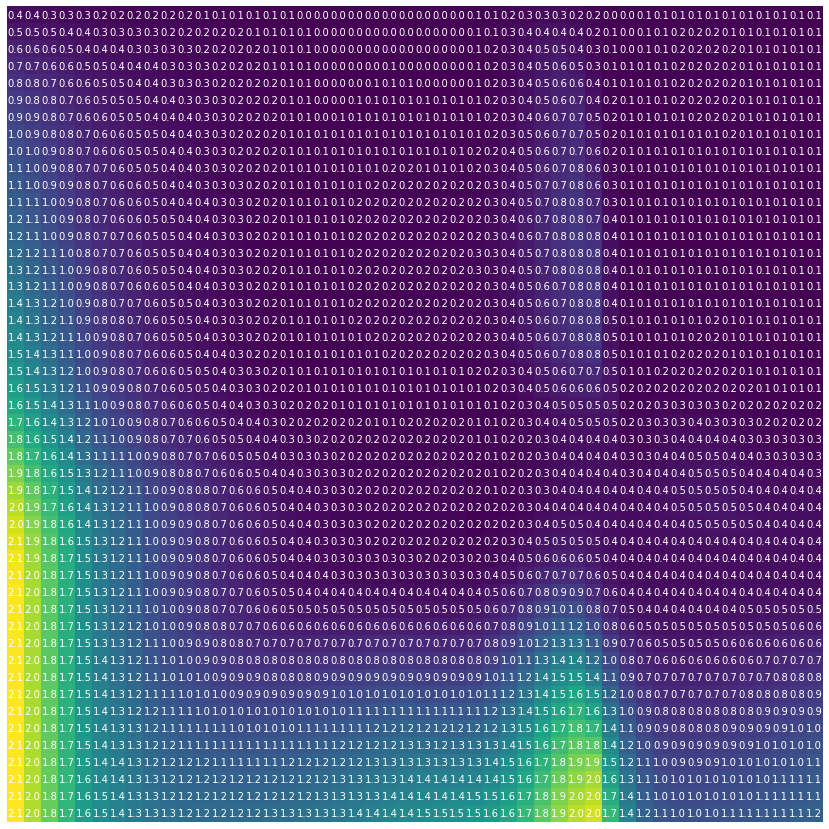

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

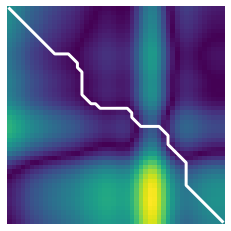

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 9

In [0]:
path, dist = dtw_path(day_7_02[::30], day_9_02[::30])

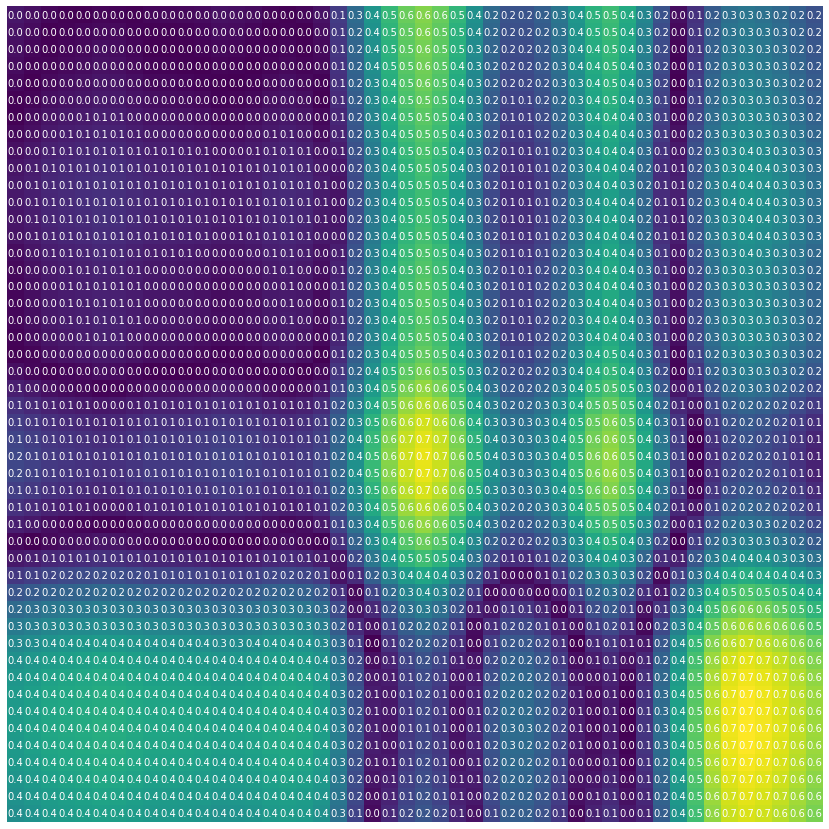

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

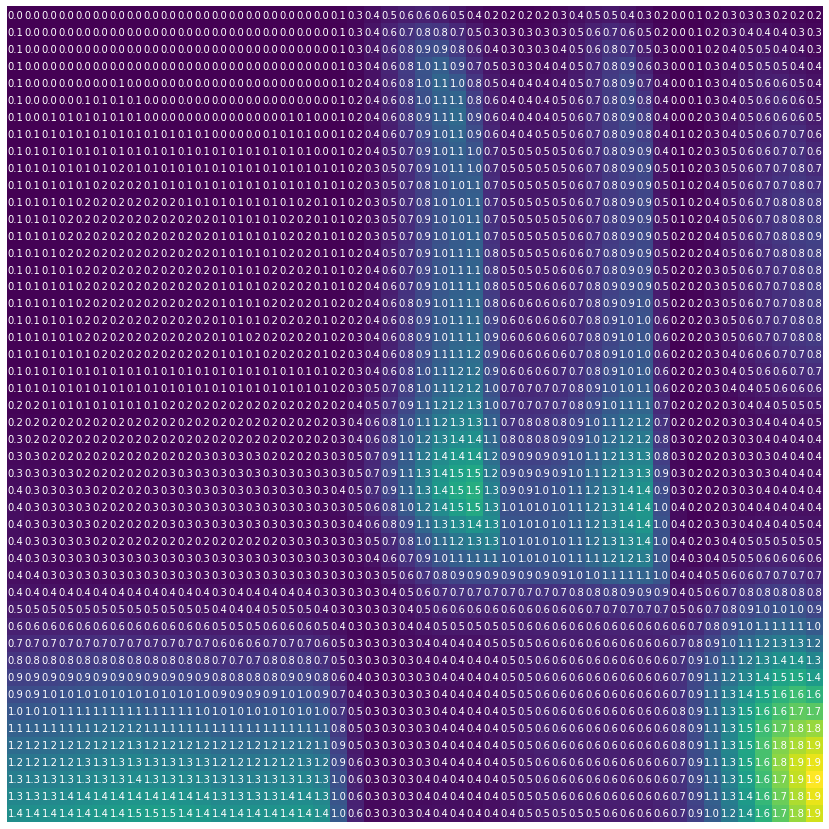

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

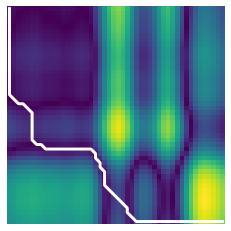

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 8 and Day 9

In [0]:
path, dist = dtw_path(day_8_02[::30], day_9_02[::30])

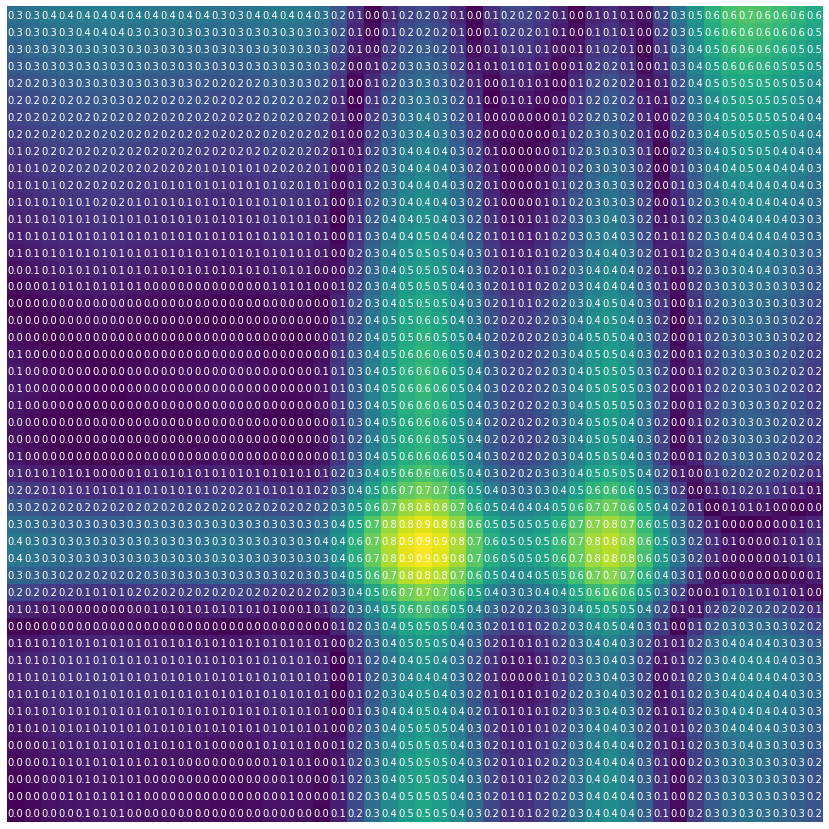

In [0]:
mat = cdist(day_8_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

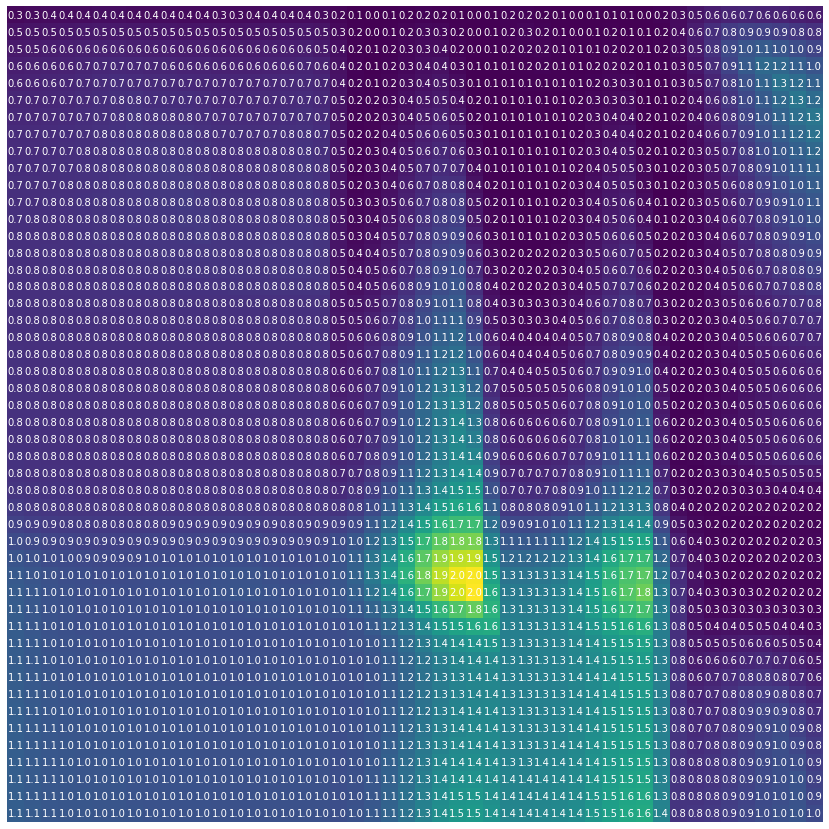

In [0]:
acc = subsequence_cost_matrix(day_8_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

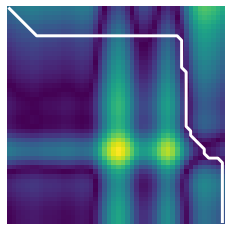

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

In [0]:
### Global constraint: Sakoe-Chiba Band
path, dist = dtw_path(day_8_02[::30], day_9_02[::30], global_constraint="sakoe_chiba", sakoe_chiba_radius=2)

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

In [0]:
###
path, dist = dtw_path(day_8_02[::30], day_9_02[::30], global_constraint="itakura", itakura_max_slope=2.)

## Humidity per day after transformations

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

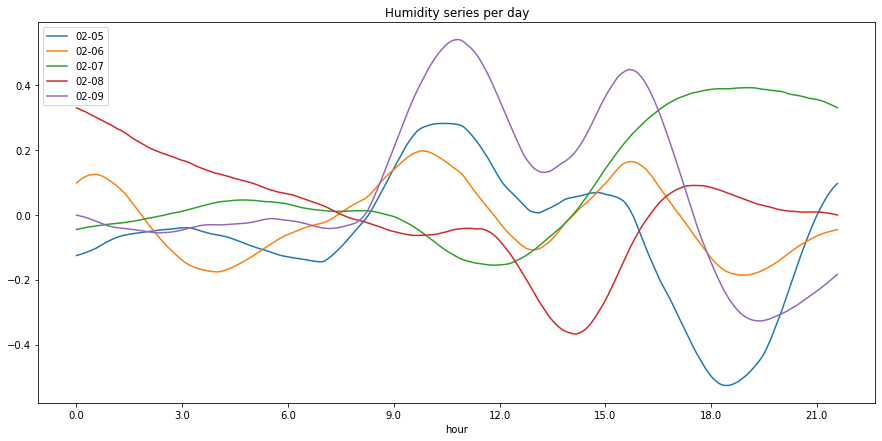

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02)
plt.plot(day_6_02)
plt.plot(day_7_02)
plt.plot(day_8_02)
plt.plot(day_9_02)
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Humidity series per day')
plt.show()

### Feature extraction

In [0]:
pip install tsfresh

Note: you may need to restart the kernel to use updated packages.


In [0]:
from tsfresh.feature_extraction import extract_features

In [0]:
df['id'] = [0] * len(df)

In [0]:
features = extract_features(timeseries_container=df[['id','Humidity']], column_id='id')

Feature Extraction: 100%|██████████| 1/1 [02:11<00:00, 131.10s/it]


In [0]:
features.to_dict()

{'Humidity__abs_energy': {0: 5640664.285546013},
 'Humidity__absolute_sum_of_changes': {0: 304.4966666666676},
 'Humidity__agg_autocorrelation__f_agg_"mean"__maxlag_40': {0: 0.9956723238708178},
 'Humidity__agg_autocorrelation__f_agg_"median"__maxlag_40': {0: 0.9959497424865293},
 'Humidity__agg_autocorrelation__f_agg_"var"__maxlag_40': {0: 8.100235318725137e-06},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"intercept"': {0: 19.664787050402985},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"rvalue"': {0: 0.6421919506937614},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"slope"': {0: 0.015138545456318825},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"stderr"': {0: 0.0006337398713502262},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_50__attr_"intercept"': {0: 19.92830240909771},
 'Humidity__agg_linear_trend__f_agg_"max"__chunk_len_50__attr_"rvalue"': {0: 0.6393736066218647},
 'Humidity__agg_linear_trend__f_agg_

### Compressed-based distancies

In [0]:
import zlib
import string

In [0]:
def CDM(x, y):
    return len(zlib.compress(x + y)) / (len(zlib.compress(x)) + len(zlib.compress(y)))

In [0]:
day_5_02_str = (' '.join([str(v) for v in day_5_02])).encode('utf-8')
day_6_02_str = (' '.join([str(v) for v in day_6_02])).encode('utf-8')
day_7_02_str = (' '.join([str(v) for v in day_7_02])).encode('utf-8')
day_8_02_str = (' '.join([str(v) for v in day_8_02])).encode('utf-8')
day_9_02_str = (' '.join([str(v) for v in day_9_02])).encode('utf-8')

###### Day 5 and 6

In [0]:
print("len(day_5_02_str + day_6_02_str): ", len(day_5_02_str + day_6_02_str))
print("len(compress(day_5_02_str + day_6_02_str)): ", len(zlib.compress(day_5_02_str + day_6_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("CDM = ", CDM(day_5_02_str, day_6_02_str))

len(day_5_02_str + day_6_02_str):  59134
len(compress(day_5_02_str + day_6_02_str)):  26968
len(compress(day_5_02_str)):  13589
len(compress(day_6_02_str)):  13718
CDM =  0.9875856007617094


###### Day 5 and 7

In [0]:
print("len(day_5_02_str + day_7_02_str): ", len(day_5_02_str + day_7_02_str))
print("len(compress(day_5_02_str + day_7_02_str)): ", len(zlib.compress(day_5_02_str + day_7_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("CDM = ", CDM(day_5_02_str, day_7_02_str))

len(day_5_02_str + day_7_02_str):  58982
len(compress(day_5_02_str + day_7_02_str)):  26814
len(compress(day_5_02_str)):  13589
len(compress(day_7_02_str)):  13435
CDM =  0.9922291296625222


###### Day 5 and 8

In [0]:
print("len(day_5_02_str + day_8_02_str): ", len(day_5_02_str + day_8_02_str))
print("len(compress(day_5_02_str + day_8_02_str)): ", len(zlib.compress(day_5_02_str + day_8_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_5_02_str, day_8_02_str))

len(day_5_02_str + day_8_02_str):  58982
len(compress(day_5_02_str + day_8_02_str)):  26883
len(compress(day_5_02_str)):  13589
len(compress(day_8_02_str)):  13559
CDM =  0.9902386916163253


###### Day 5 and 9

In [0]:
print("len(day_5_02_str + day_9_02_str): ", len(day_5_02_str + day_9_02_str))
print("len(compress(day_5_02_str + day_9_02_str)): ", len(zlib.compress(day_5_02_str + day_9_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_5_02_str, day_9_02_str))

len(day_5_02_str + day_9_02_str):  58972
len(compress(day_5_02_str + day_9_02_str)):  26901
len(compress(day_5_02_str)):  13589
len(compress(day_9_02_str)):  13513
CDM =  0.9925835731680319


###### Day 6 and 7

In [0]:
print("len(day_6_02_str + day_7_02_str): ", len(day_6_02_str + day_7_02_str))
print("len(compress(day_6_02_str + day_7_02_str)): ", len(zlib.compress(day_6_02_str + day_7_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("CDM = ", CDM(day_6_02_str, day_7_02_str))

len(day_6_02_str + day_7_02_str):  59058
len(compress(day_6_02_str + day_7_02_str)):  26915
len(compress(day_6_02_str)):  13718
len(compress(day_7_02_str)):  13435
CDM =  0.991234854343903


###### Day 6 and 8

In [0]:
print("len(day_6_02_str + day_8_02_str): ", len(day_6_02_str + day_8_02_str))
print("len(compress(day_6_02_str + day_8_02_str)): ", len(zlib.compress(day_6_02_str + day_8_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_6_02_str, day_8_02_str))

len(day_6_02_str + day_8_02_str):  59058
len(compress(day_6_02_str + day_8_02_str)):  26986
len(compress(day_6_02_str)):  13718
len(compress(day_8_02_str)):  13559
CDM =  0.9893316713714851


###### Day 6 and 9

In [0]:
print("len(day_6_02_str + day_9_02_str): ", len(day_6_02_str + day_9_02_str))
print("len(compress(day_6_02_str + day_9_02_str)): ", len(zlib.compress(day_6_02_str + day_9_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_6_02_str, day_9_02_str))

len(day_6_02_str + day_9_02_str):  59048
len(compress(day_6_02_str + day_9_02_str)):  26988
len(compress(day_6_02_str)):  13718
len(compress(day_9_02_str)):  13513
CDM =  0.9910763468106203


###### Day 7 and 8

In [0]:
print("len(day_7_02_str + day_8_02_str): ", len(day_7_02_str + day_8_02_str))
print("len(compress(day_7_02_str + day_8_02_str)): ", len(zlib.compress(day_7_02_str + day_8_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_7_02_str, day_8_02_str))

len(day_7_02_str + day_8_02_str):  58906
len(compress(day_7_02_str + day_8_02_str)):  26742
len(compress(day_7_02_str)):  13435
len(compress(day_8_02_str)):  13559
CDM =  0.9906645921315848


###### Day 7 and 9

In [0]:
print("len(day_7_02_str + day_9_02_str): ", len(day_7_02_str + day_9_02_str))
print("len(compress(day_7_02_str + day_9_02_str)): ", len(zlib.compress(day_7_02_str + day_9_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_7_02_str, day_9_02_str))

len(day_7_02_str + day_9_02_str):  58896
len(compress(day_7_02_str + day_9_02_str)):  26727
len(compress(day_7_02_str)):  13435
len(compress(day_9_02_str)):  13513
CDM =  0.9917990203354609


###### Day 8 and 9

In [0]:
print("len(day_8_02_str + day_9_02_str): ", len(day_8_02_str + day_9_02_str))
print("len(compress(day_8_02_str + day_9_02_str)): ", len(zlib.compress(day_8_02_str + day_9_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_8_02_str, day_9_02_str))

len(day_8_02_str + day_9_02_str):  58896
len(compress(day_8_02_str + day_9_02_str)):  26835
len(compress(day_8_02_str)):  13559
len(compress(day_9_02_str)):  13513
CDM =  0.9912455673758865


### Time series Approximation

In [0]:
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

from tslearn.piecewise import PiecewiseAggregateApproximation
from tslearn.piecewise import SymbolicAggregateApproximation
from tslearn.piecewise import OneD_SymbolicAggregateApproximation
from numpy.fft import fft,fftfreq

In [0]:
scaler = TimeSeriesScalerMeanVariance(mu=0., std=1.)  # Rescale time series
day_5_02_scl = scaler.fit_transform(day_5_02)
day_6_02_scl = scaler.fit_transform(day_6_02)
day_7_02_scl = scaler.fit_transform(day_7_02)
day_8_02_scl = scaler.fit_transform(day_8_02)
day_9_02_scl = scaler.fit_transform(day_9_02)

In [0]:
dft_5 = fft(day_5_02_scl)
dft_6 = fft(day_6_02_scl)
dft_7 = fft(day_7_02_scl)
dft_8 = fft(day_8_02_scl)
dft_9 = fft(day_9_02_scl)

###### Descrete Fourier Transformation for Day 5

In [0]:
freq_5 = np.array(len(day_5_02_scl))

for i in range(len(dft_5)):
    freq_5 = abs(dft_5[i].real)

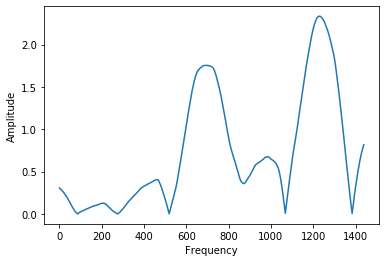

In [0]:
plt.ylabel("Amplitude")
plt.xlabel("Frequency")
plt.plot(freq_5)

# Feature CO2 as univariate framework

In [0]:
url = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatraining.csv'
df = pd.read_csv(url) 

In [0]:
df['date'] = pd.to_datetime(df['date'])

In [0]:
df = df.set_index(['date'])

In [0]:
df = df[['CO2','Occupancy']]
df.head()

,CO2,Occupancy
date,,
2015-02-04 17:51:00,721.25,1
2015-02-04 17:51:59,714.00,1
2015-02-04 17:53:00,713.50,1
2015-02-04 17:54:00,708.25,1
2015-02-04 17:55:00,704.50,1


## Trasformazioni

### Offset Translation

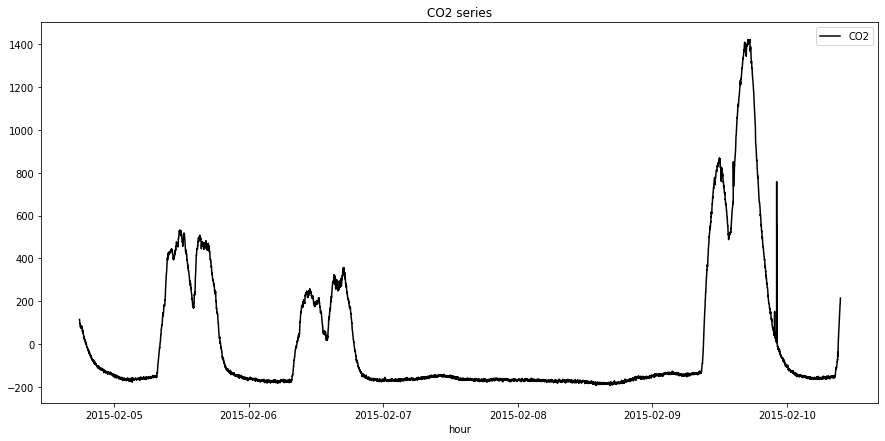

In [0]:
plt.figure(figsize=(15,7))
plt.plot(df['CO2'] - df['CO2'].mean(), c='k')
#plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['CO2'])
plt.title('CO2 series')
plt.show()

### Amplitude Scaling

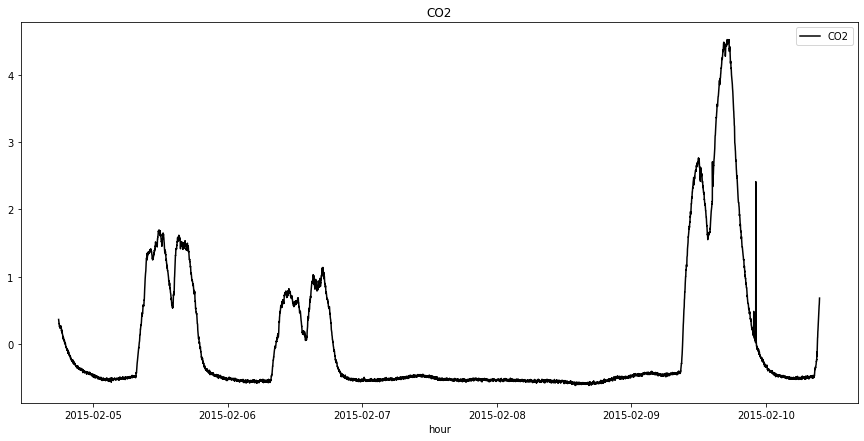

In [0]:
plt.figure(figsize=(15,7))
plt.plot((df['CO2']-df['CO2'].mean())/df['CO2'].std(), c = 'k')
#plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['CO2'])
plt.title('CO2')
plt.show()

### Noise

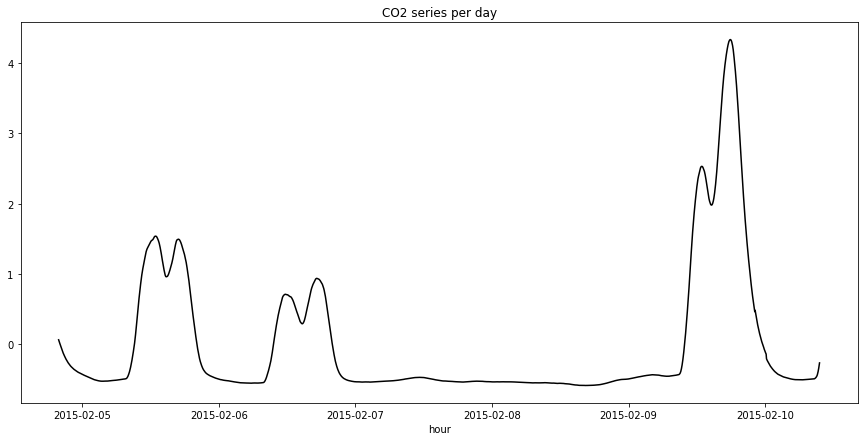

In [0]:
w = 120
plt.figure(figsize=(15,7))
df_denoised = ((df['CO2']-df['CO2'].mean())/df['CO2'].std()).rolling(window=w).mean()
plt.plot(df_denoised, c = 'k')
#plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.title('CO2 series per day')
plt.show()

### Linear Trend

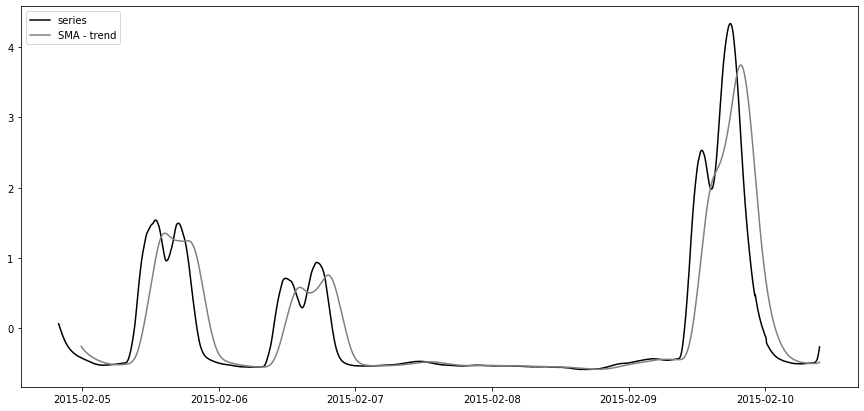

In [0]:
ts = df_denoised.loc['2015-02-04':'2015-02-10']
sma = ts.rolling(window = 240).mean()       #simple moving average
plt.figure(figsize=(15,7))
plt.plot(ts, c ='k')
plt.plot(sma, c = 'grey')
plt.legend(['series','SMA - trend'], loc = 'upper left')   # perchè in un giorno ci sono 1440 min
plt.show()

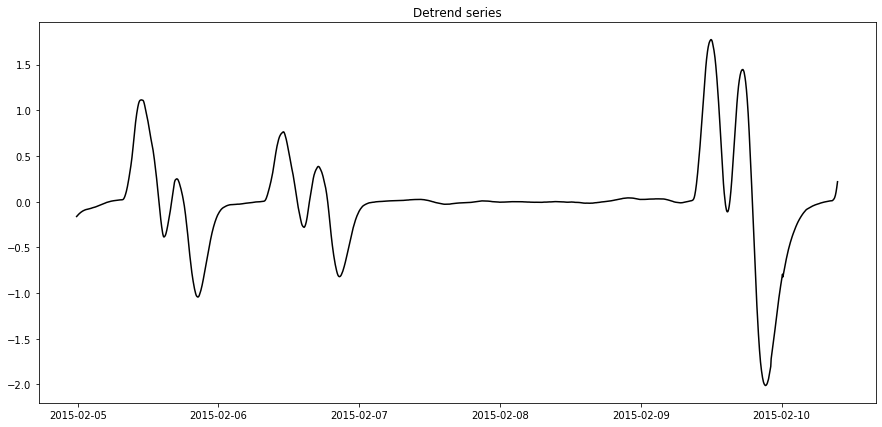

In [0]:
plt.figure(figsize=(15,7))
ts_shift = ts - sma
plt.plot(ts_shift, c = 'k')
plt.title('Detrend series')
plt.show()

### Time Series CO2 per days

In [0]:
day_4_02 = ts_shift['2015-02-04']
day_5_02 = ts_shift['2015-02-05']
day_6_02 = ts_shift['2015-02-06']
day_7_02 = ts_shift['2015-02-07']
day_8_02 = ts_shift['2015-02-08']
day_9_02 = ts_shift['2015-02-09']
day_10_02 = ts_shift['2015-02-10']

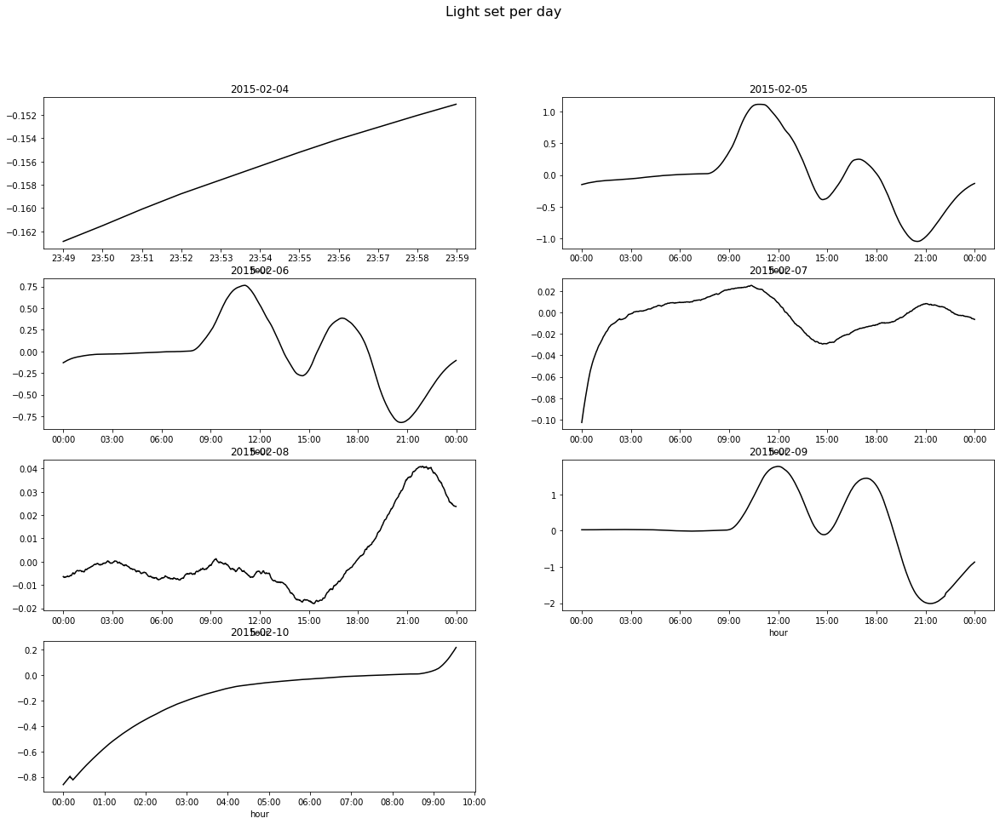

In [0]:
import matplotlib.dates as mdates

fig, axs = plt.subplots(4, 2, figsize=(20,15))
axs[-1, -1].axis('off')
fig.suptitle('Light set per day', fontsize=16)
xfmt = mdates.DateFormatter('%H:%M')

axs[0,0].plot(day_4_02,c ='k')
axs[0,0].xaxis.set_major_formatter(xfmt)
axs[0,0].set_xlabel('hour')
axs[0,0].set_title('2015-02-04')

axs[0,1].plot(day_5_02,c ='k')
axs[0,1].xaxis.set_major_formatter(xfmt)
axs[0,1].set_xlabel('hour')
axs[0,1].set_title('2015-02-05')

axs[1,0].plot(day_6_02,c ='k')
axs[1,0].xaxis.set_major_formatter(xfmt)
axs[1,0].set_xlabel('hour')
axs[1,0].set_title('2015-02-06')

axs[1,1].plot(day_7_02,c ='k')
axs[1,1].xaxis.set_major_formatter(xfmt)
axs[1,1].set_xlabel('hour')
axs[1,1].set_title('2015-02-07')

axs[2,0].plot(day_8_02,c ='k')
axs[2,0].xaxis.set_major_formatter(xfmt)
axs[2,0].set_xlabel('hour')
axs[2,0].set_title('2015-02-08')

axs[2,1].plot(day_9_02,c ='k')
axs[2,1].xaxis.set_major_formatter(xfmt)
axs[2,1].set_xlabel('hour')
axs[2,1].set_title('2015-02-09')

axs[3,0].plot(day_10_02,c ='k')
axs[3,0].xaxis.set_major_formatter(xfmt)
axs[3,0].set_xlabel('hour')
axs[3,0].set_title('2015-02-10')

plt.show()

## Euclidean Distance

In [0]:
from scipy.spatial.distance import euclidean

In [0]:
dist_eucl_day5_day6 = euclidean(day_5_02, day_6_02)

dist_eucl_day5_day7 = euclidean(day_5_02, day_7_02)

dist_eucl_day5_day8 = euclidean(day_5_02, day_8_02)

dist_eucl_day5_day9 = euclidean(day_5_02, day_9_02)

dist_eucl_day6_day7 = euclidean(day_6_02, day_7_02)

dist_eucl_day6_day8 = euclidean(day_6_02, day_8_02)

dist_eucl_day6_day9 = euclidean(day_6_02, day_9_02)

dist_eucl_day7_day8 = euclidean(day_7_02, day_8_02)

dist_eucl_day7_day9 = euclidean(day_7_02, day_9_02)

dist_eucl_day8_day9 = euclidean(day_8_02, day_9_02)

In [0]:
from prettytable import PrettyTable

table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_eucl_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_eucl_day5_day7, dist_eucl_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_eucl_day5_day8, dist_eucl_day6_day8, dist_eucl_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_eucl_day5_day9, dist_eucl_day6_day9, dist_eucl_day7_day9,dist_eucl_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+-------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02     | day_9_02 |
+----------+--------------------+--------------------+--------------------+-------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -         |    -     |
| day_6_02 | 6.840463578177902  |         0          |         -          |         -         |    -     |
| day_7_02 | 19.047014036878263 | 13.863773085613513 |         0          |         -         |    -     |
| day_8_02 | 19.59563525851181  | 14.38381095793105  | 0.8520420947388674 |         0         |    -     |
| day_9_02 | 24.18937218822273  | 25.590817624019987 | 36.98504414087658  | 37.38218237633649 |    0     |
+----------+--------------------+--------------------+--------------------+-------------------+----------+


## Manhattan Distance

In [0]:
from scipy.spatial.distance import cityblock

In [0]:
dist_city_day5_day6 = cityblock(day_5_02, day_6_02)

dist_city_day5_day7 = cityblock(day_5_02, day_7_02)

dist_city_day5_day8 = cityblock(day_5_02, day_8_02)

dist_city_day5_day9 = cityblock(day_5_02, day_9_02)

dist_city_day6_day7 = cityblock(day_6_02, day_7_02)

dist_city_day6_day8 = cityblock(day_6_02, day_8_02)

dist_city_day6_day9 = cityblock(day_6_02, day_9_02)

dist_city_day7_day8 = cityblock(day_7_02, day_8_02)

dist_city_day7_day9 = cityblock(day_7_02, day_9_02)

dist_city_day8_day9 = cityblock(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_city_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_city_day5_day7, dist_city_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_city_day5_day8, dist_city_day6_day8, dist_city_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_city_day5_day9, dist_city_day6_day9, dist_city_day7_day9,dist_city_day8_day9,0])

print(table)

+----------+--------------------+-------------------+--------------------+-------------------+----------+
|   Days   |      day_5_02      |      day_6_02     |      day_7_02      |      day_8_02     | day_9_02 |
+----------+--------------------+-------------------+--------------------+-------------------+----------+
| day_5_02 |         0          |         -         |         -          |         -         |    -     |
| day_6_02 | 197.18020051149068 |         0         |         -          |         -         |    -     |
| day_7_02 | 502.7170505213648  | 372.1218320910367 |         0          |         -         |    -     |
| day_8_02 | 524.1520244142378  | 388.7880145325695 | 26.551633933275966 |         0         |    -     |
| day_9_02 | 692.5230371688066  | 700.5641202191684 | 976.6538060204867  | 981.5377896839663 |    0     |
+----------+--------------------+-------------------+--------------------+-------------------+----------+


## Dynamic Time Warping

In [0]:
from tslearn.metrics import dtw, dtw_path, cdist_dtw, subsequence_cost_matrix

In [0]:
dist_dtw_day5_day6 = dtw(day_5_02, day_6_02)

dist_dtw_day5_day7 = dtw(day_5_02, day_7_02)

dist_dtw_day5_day8 = dtw(day_5_02, day_8_02)

dist_dtw_day5_day9 = dtw(day_5_02, day_9_02)

dist_dtw_day6_day7 = dtw(day_6_02, day_7_02)

dist_dtw_day6_day8 = dtw(day_6_02, day_8_02)

dist_dtw_day6_day9 = dtw(day_6_02, day_9_02)

dist_dtw_day7_day8 = dtw(day_7_02, day_8_02)

dist_dtw_day7_day9 = dtw(day_7_02, day_9_02)

dist_dtw_day8_day9 = dtw(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_dtw_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_dtw_day5_day7, dist_dtw_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_dtw_day5_day8, dist_dtw_day6_day8, dist_dtw_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_dtw_day5_day9, dist_dtw_day6_day9, dist_dtw_day7_day9,dist_dtw_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+--------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02      | day_9_02 |
+----------+--------------------+--------------------+--------------------+--------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -          |    -     |
| day_6_02 | 3.8025765879511995 |         0          |         -          |         -          |    -     |
| day_7_02 | 18.769851666303964 | 13.53407154738793  |         0          |         -          |    -     |
| day_8_02 | 19.053484479169235 | 13.827385274302744 | 0.7539907456441635 |         0          |    -     |
| day_9_02 | 16.94061177570248  | 20.947482758741568 | 36.49985718212554  | 36.631987931352825 |    0     |
+----------+--------------------+--------------------+--------------------+--------------------+----------+


###### Day 5 and Day 6

In [0]:
path, dist = dtw_path(day_5_02[::30], day_6_02[::30])

In [0]:
from scipy.spatial.distance import cdist

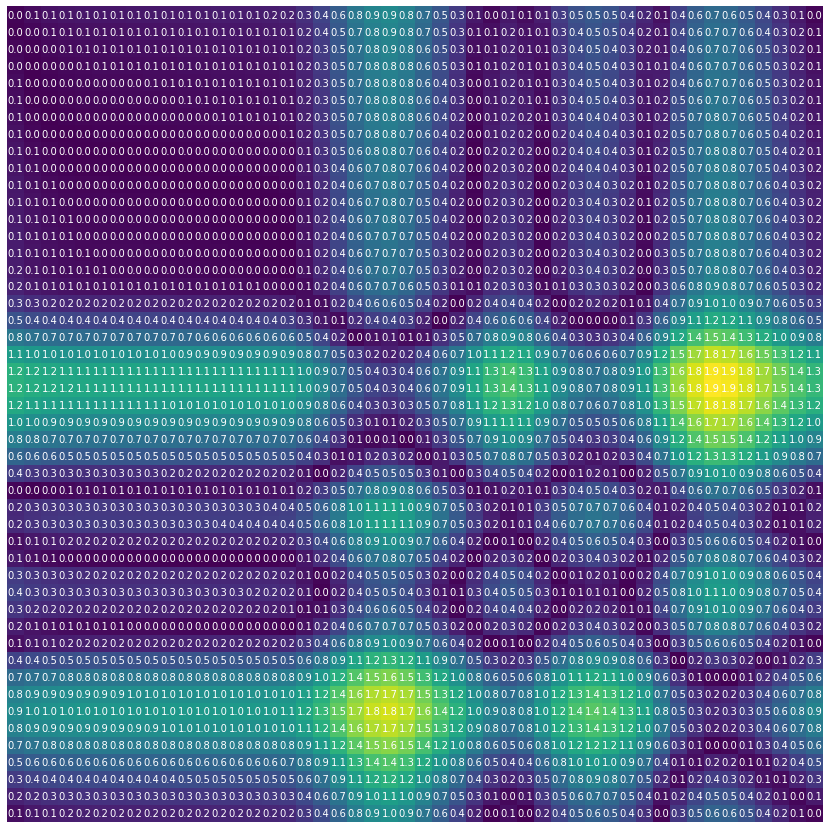

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

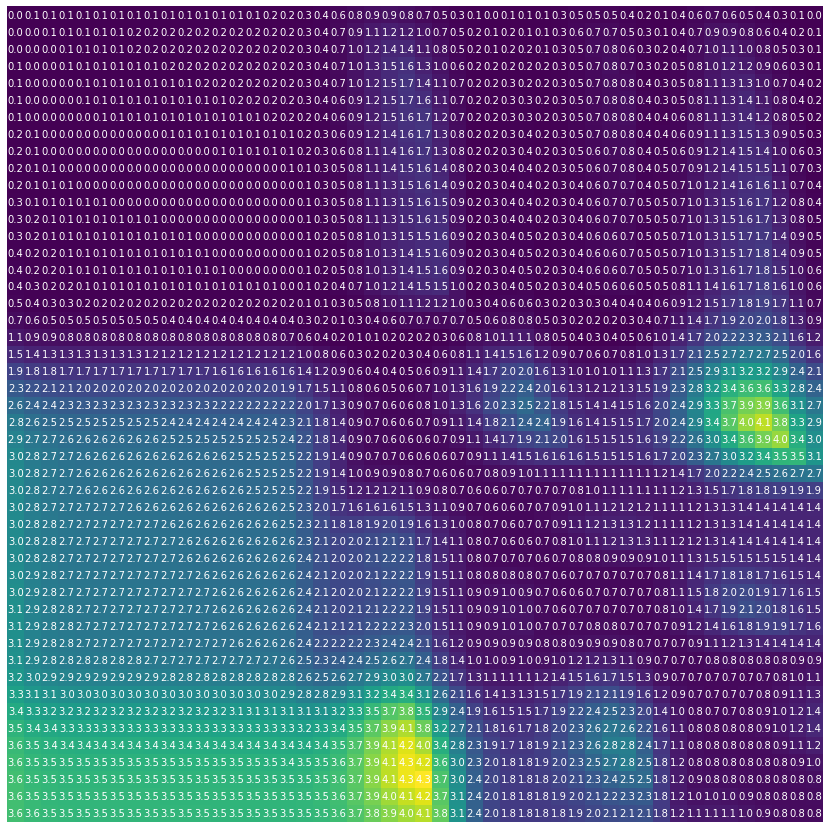

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

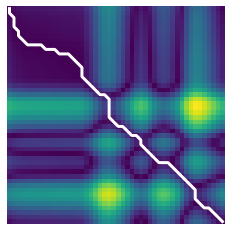

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 7

In [0]:
path, dist = dtw_path(day_5_02[::30], day_7_02[::30])

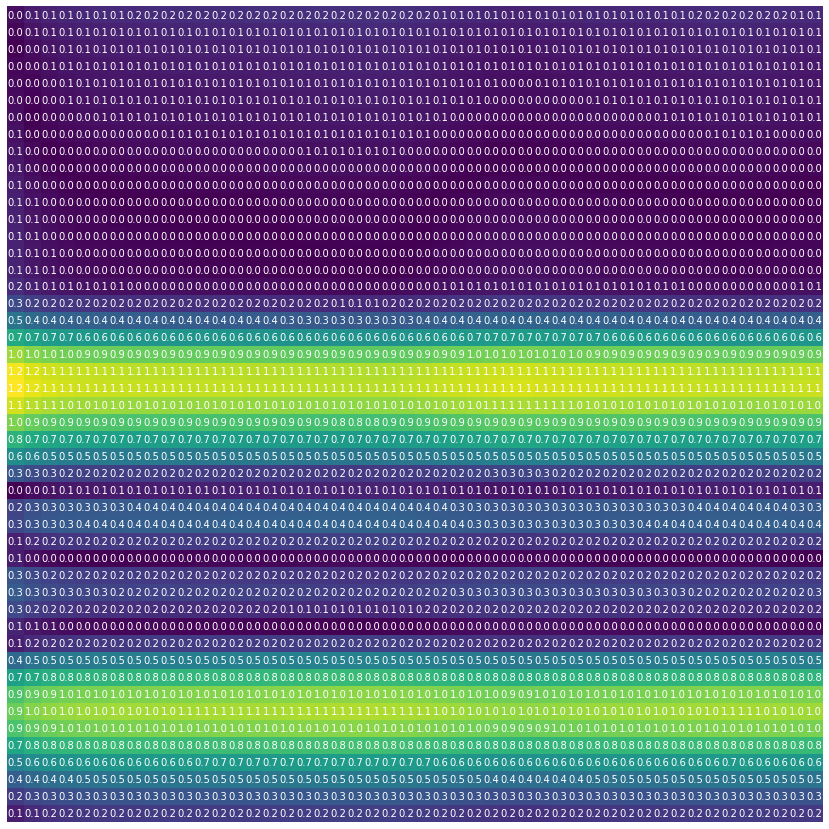

In [0]:
mat = cdist(day_5_02[::30].values.reshape(-1,1),  day_7_02[::30].values.reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

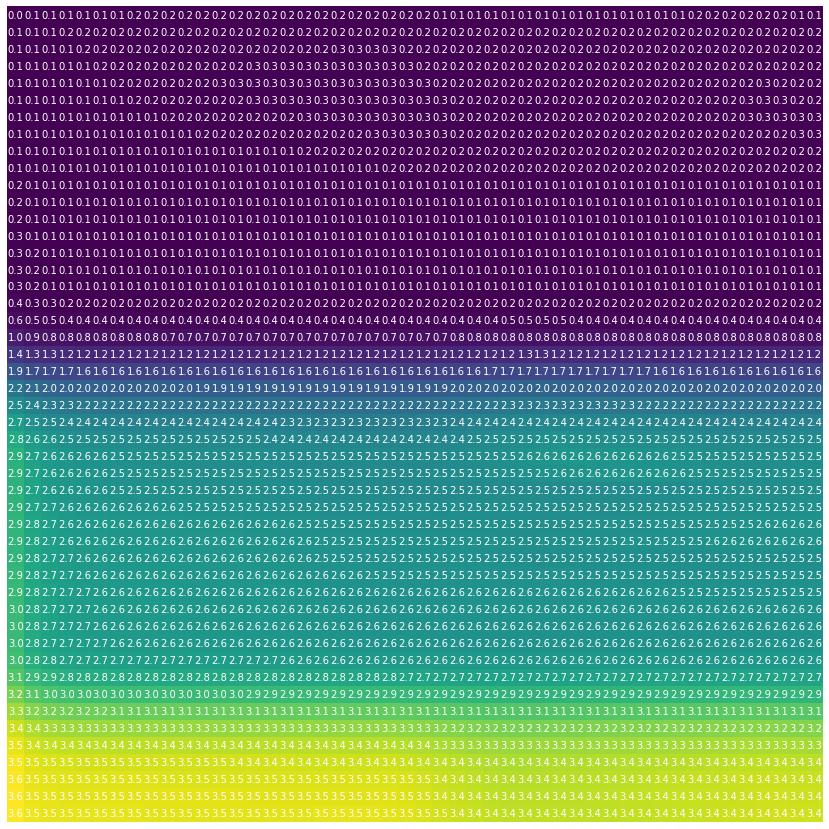

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

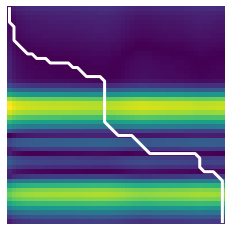

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 8

In [0]:
path, dist = dtw_path(day_5_02[::30], day_8_02[::30])

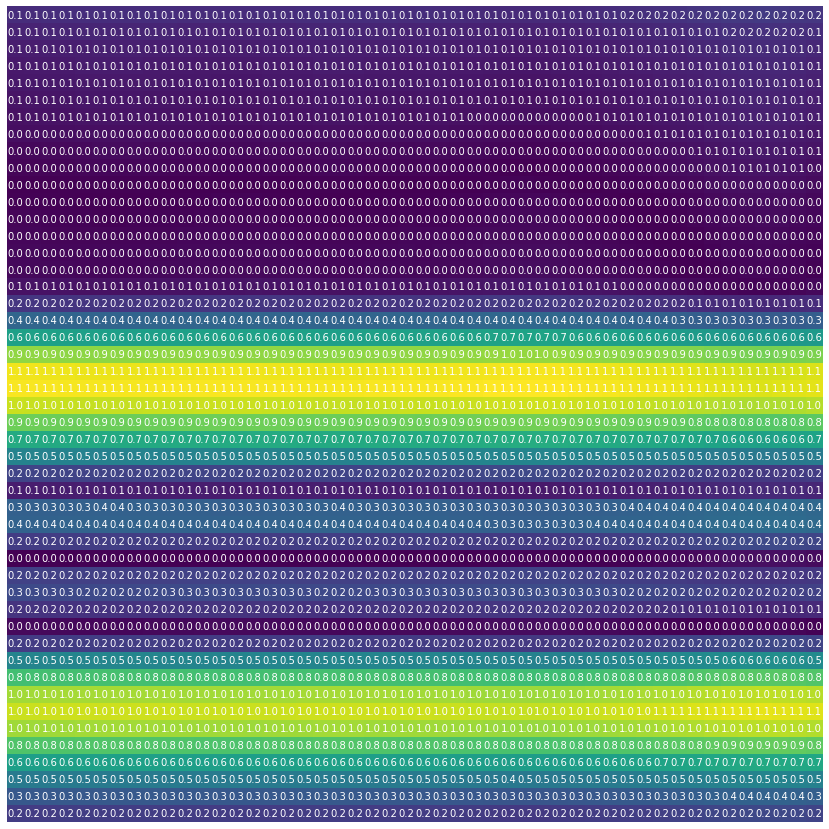

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

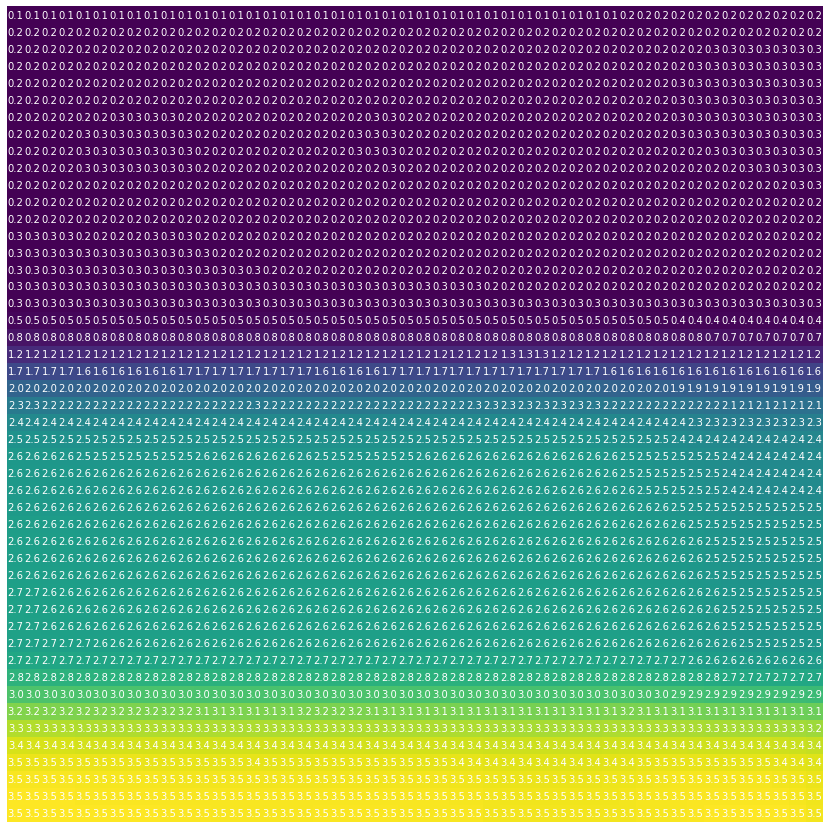

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

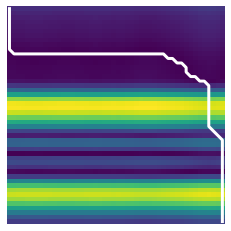

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 9

In [0]:
path, dist = dtw_path(day_5_02[::30], day_9_02[::30])

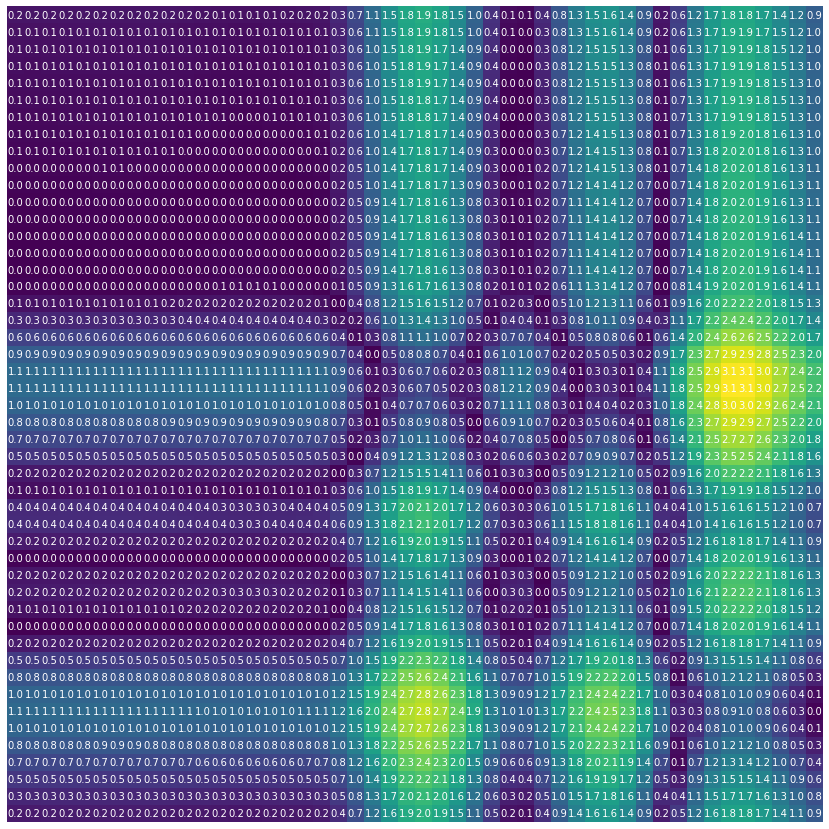

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

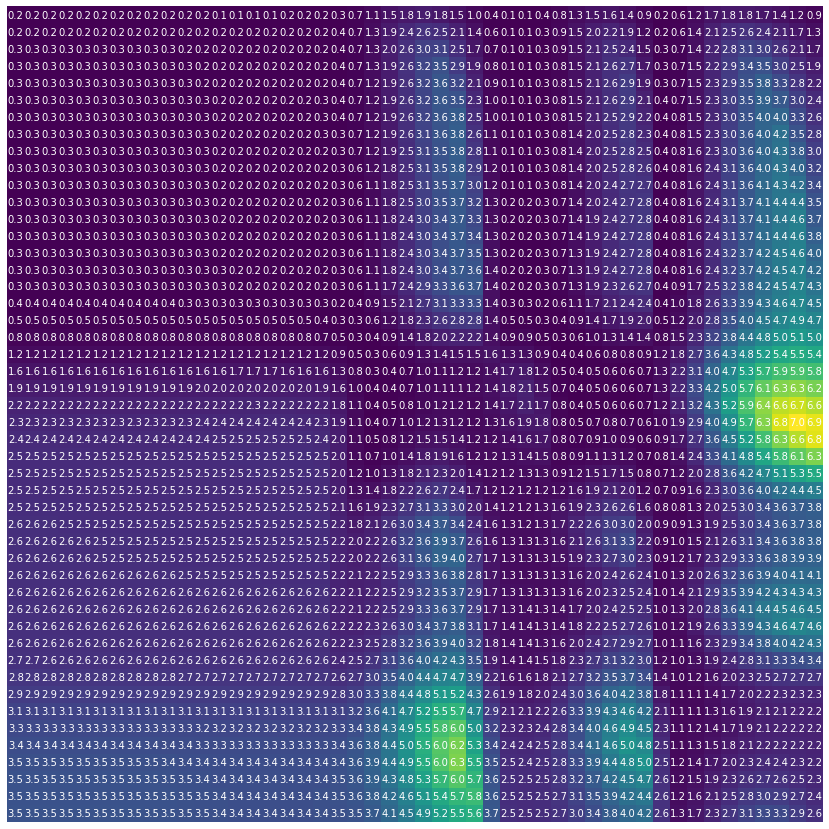

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

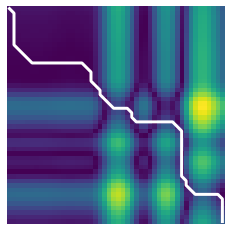

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 7

In [0]:
path, dist = dtw_path(day_6_02[::30], day_7_02[::30])

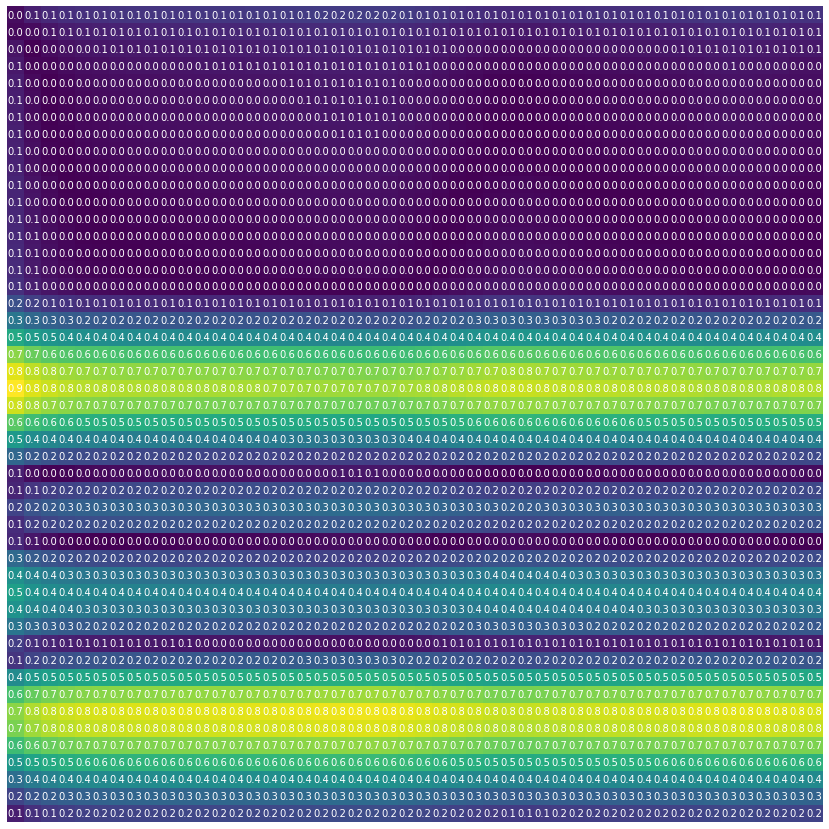

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

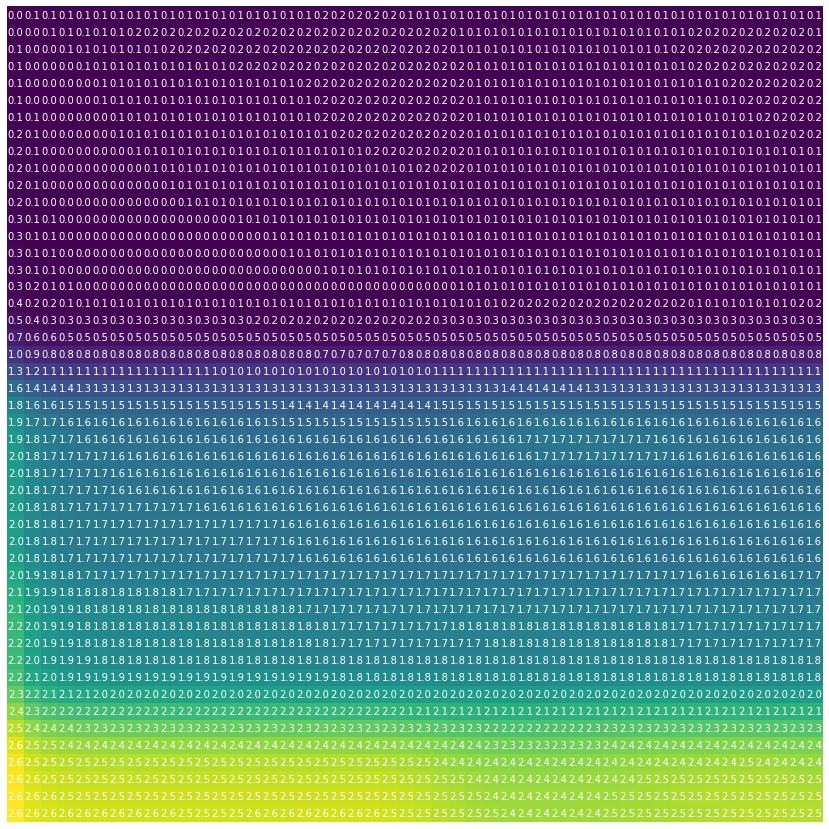

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

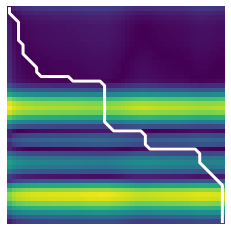

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 8

In [0]:
path, dist = dtw_path(day_6_02[::30], day_8_02[::30])

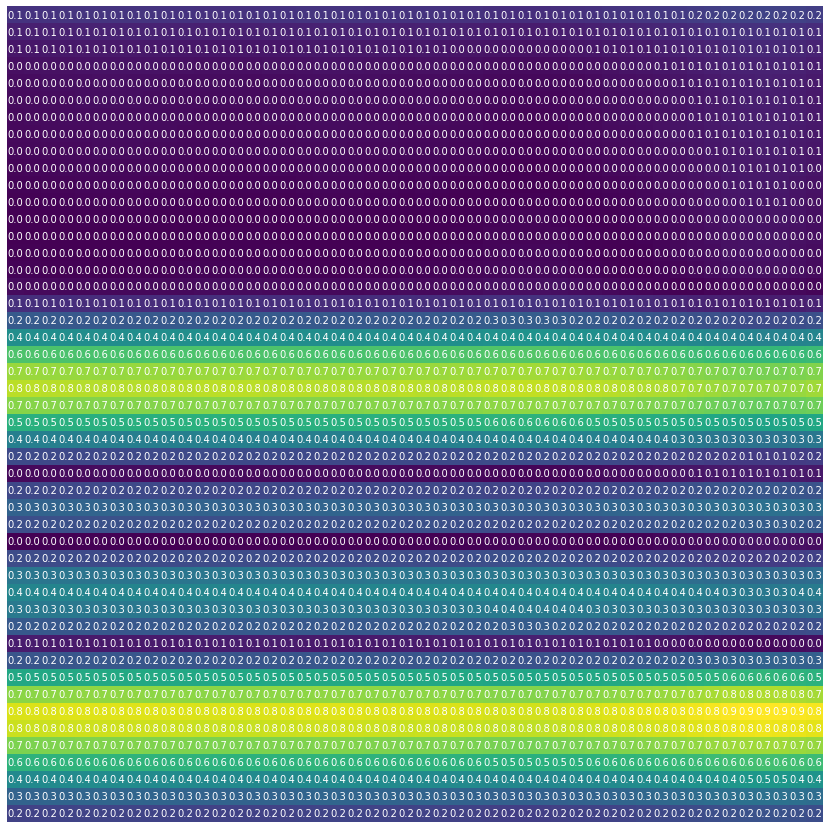

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

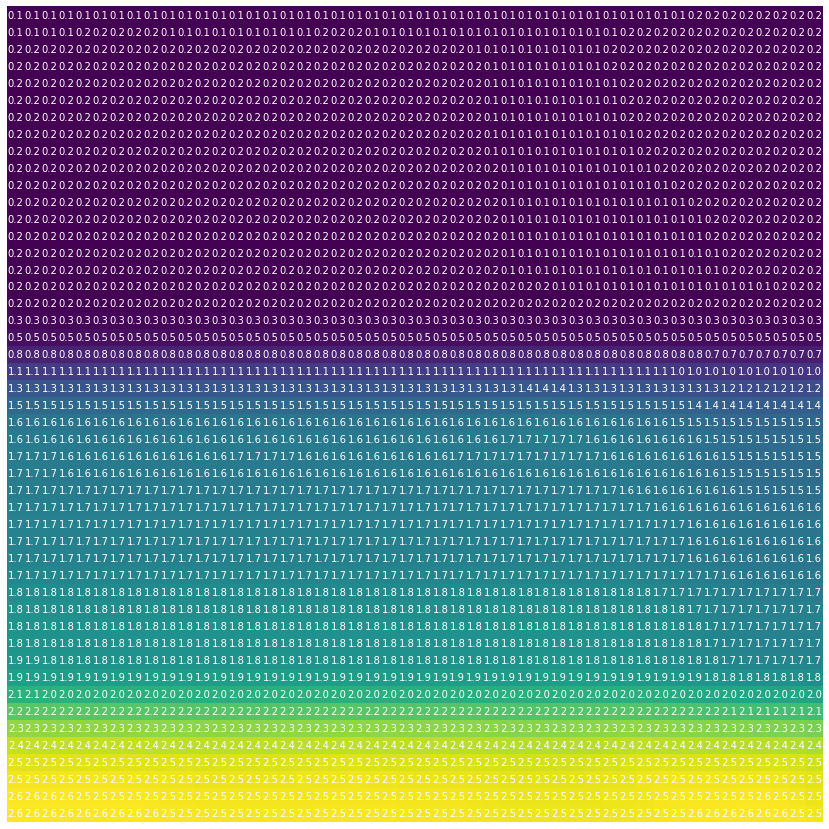

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

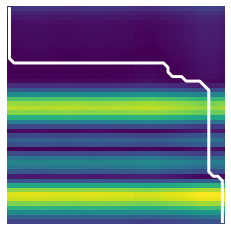

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 9

In [0]:
path, dist = dtw_path(day_6_02[::30], day_9_02[::30])

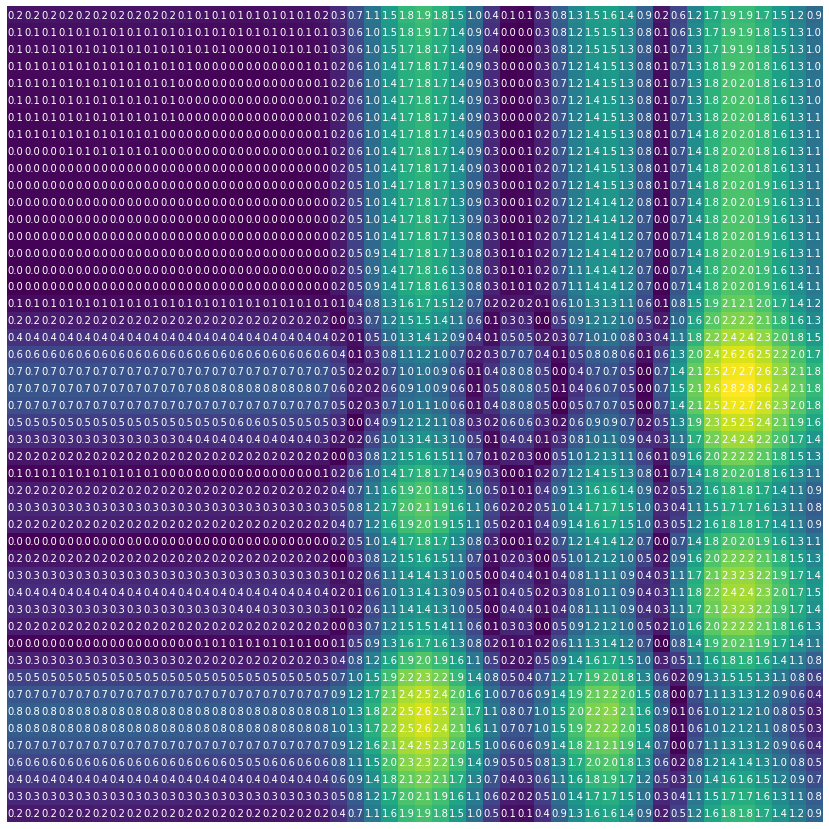

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

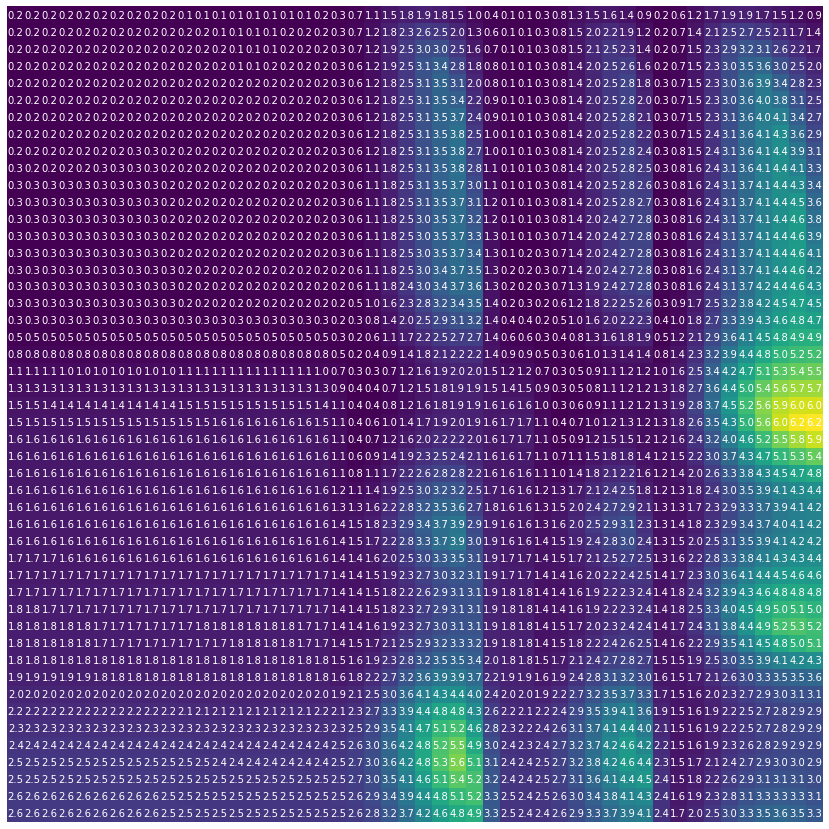

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

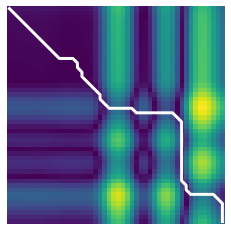

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 8

In [0]:
path, dist = dtw_path(day_7_02[::30], day_8_02[::30])

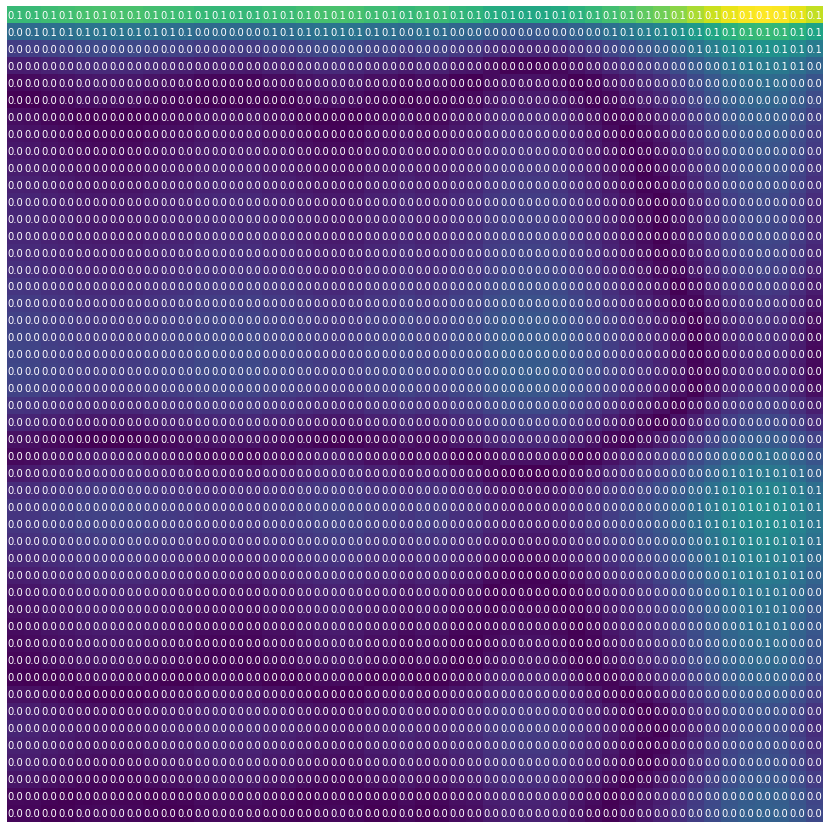

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

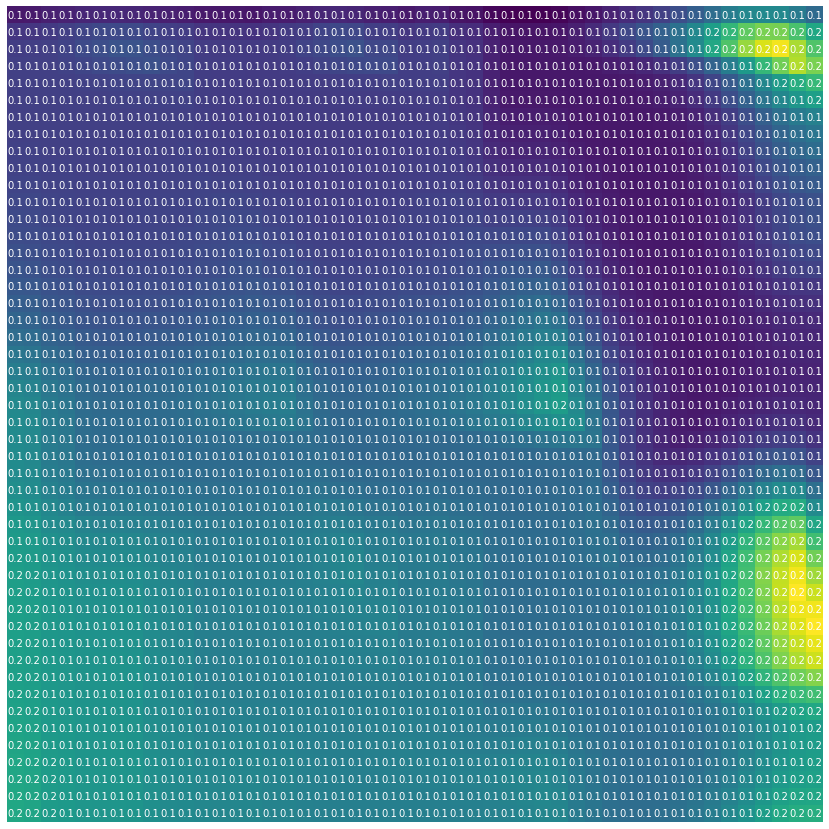

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

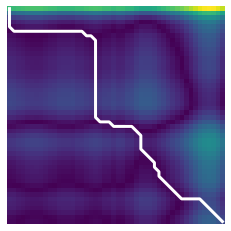

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 9

In [0]:
path, dist = dtw_path(day_7_02[::30], day_9_02[::30])

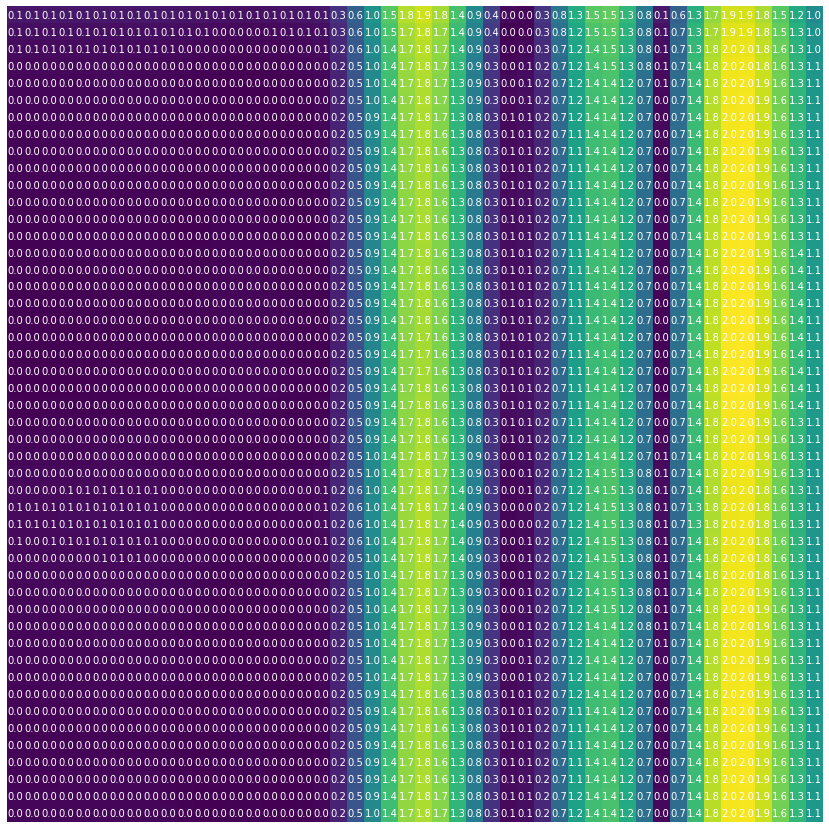

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

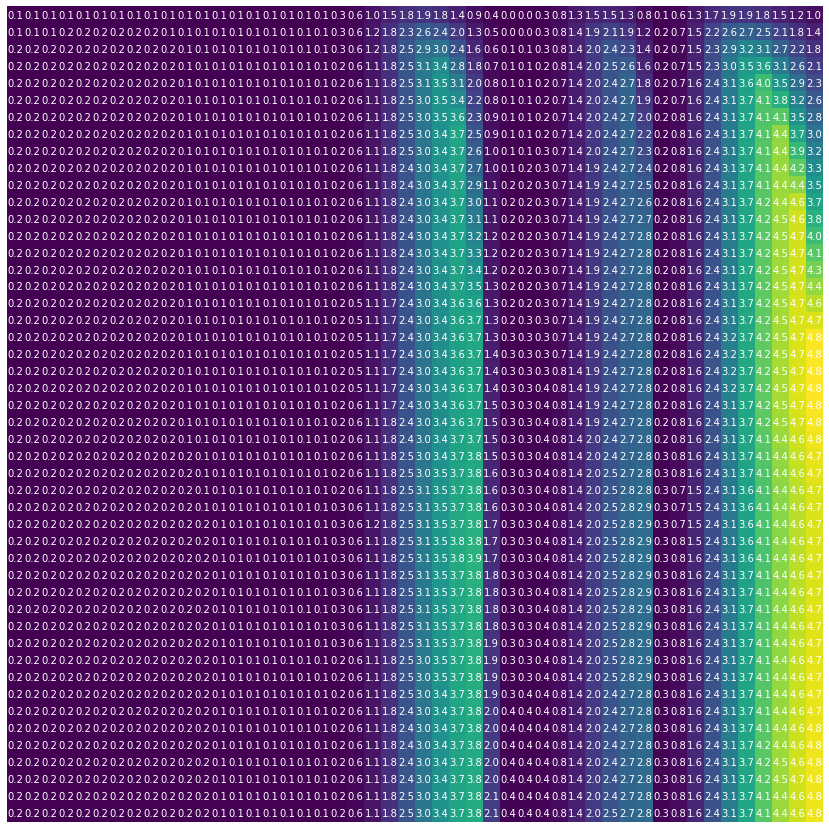

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

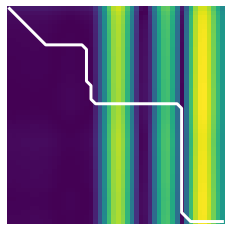

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 8 and Day 9

In [0]:
path, dist = dtw_path(day_8_02[::30], day_9_02[::30])

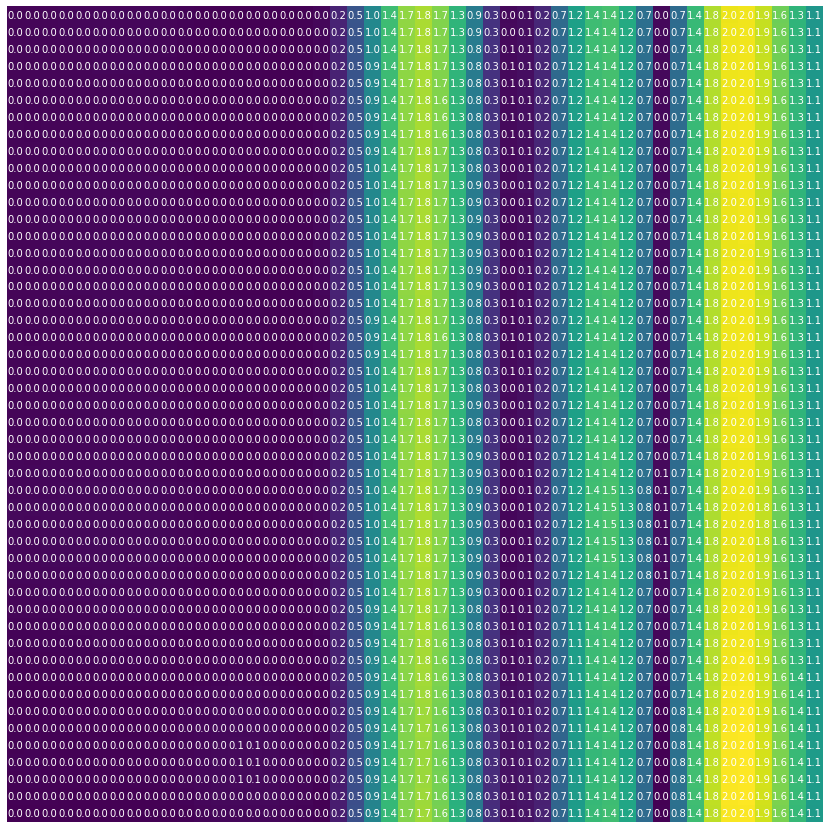

In [0]:
mat = cdist(day_8_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

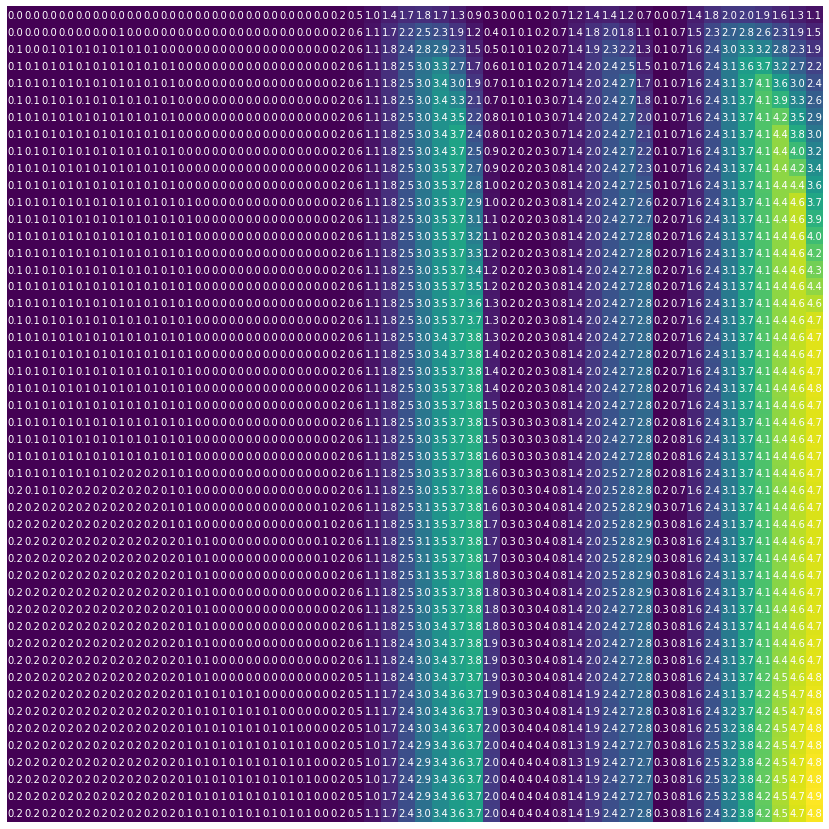

In [0]:
acc = subsequence_cost_matrix(day_8_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

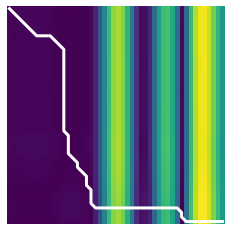

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

# Feature Temperature as  univariate framework

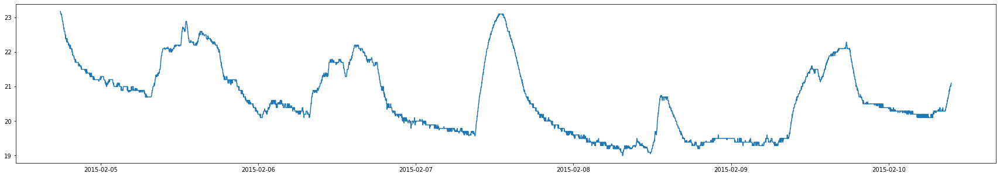

In [0]:
fig = plt.figure( figsize = (30,5))
ax = fig.add_subplot(1, 1, 1, aspect='auto')
ts = df['Temperature']
ax.plot(ts)
plt.show()

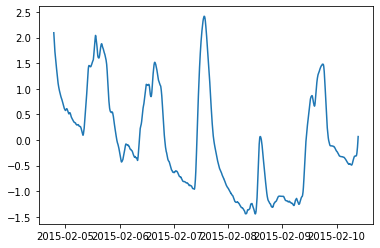

In [0]:
w = 60
ts_noise=((ts - ts.mean())/ts.std()).rolling(window=w).mean()
plt.plot(ts_noise)

plt.show()

In [0]:
plt.figure(figsize=(35,15))
plt.plot(ts_noise)
plt.plot(ts_noise.rolling(window=1440).mean())
plt.show()

In [0]:
ts_shift = ts_noise - ts_noise.rolling(window=60).mean()
plt.plot(ts_shift)
plt.show()

In [0]:
day1 = ts_shift['2015-02-05']
day2 = ts_shift['2015-02-06']
day3 = ts_shift['2015-02-07']
day4 = ts_shift['2015-02-08']
day5 = ts_shift['2015-02-09']

day1.reset_index(drop=True, inplace=True)
day2.reset_index(drop=True, inplace=True)
day3.reset_index(drop=True, inplace=True)
day4.reset_index(drop=True, inplace=True)
day5.reset_index(drop=True, inplace=True)

## Euclidian Distance

In [0]:
from scipy.spatial.distance import euclidean

In [0]:
dist1 = euclidean(day1, day2)
dist2 = euclidean(day1, day3)
dist3 = euclidean(day1, day4)
dist4 = euclidean(day1, day5)
dist5 = euclidean(day2, day3)
dist6 = euclidean(day2, day4)
dist7 = euclidean(day2, day5)
dist8 = euclidean(day3, day4)
dist9 = euclidean(day3, day5)
dist10 = euclidean(day4, day5)

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

In [0]:
dist1 = euclidean(day1[:600], day2[:600])
dist2 = euclidean(day1[:600], day3[:600])
dist3 = euclidean(day1[:600], day4[:600])
dist4 = euclidean(day1[:600], day5[:600])
dist5 = euclidean(day2[:600], day3[:600])
dist6 = euclidean(day2[:600], day4[:600])
dist7 = euclidean(day2[:600], day5[:600])
dist8 = euclidean(day3[:600], day4[:600])
dist9 = euclidean(day3[:600], day5[:600])
dist10 = euclidean(day4[:600], day5[:600])

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

## Manhattan Distance

In [0]:
from scipy.spatial.distance import cityblock

In [0]:
dist1 = cityblock(day1, day2)
dist2 = cityblock(day1, day3)
dist3 = cityblock(day1, day4)
dist4 = cityblock(day1, day5)
dist5 = cityblock(day2, day3)
dist6 = cityblock(day2, day4)
dist7 = cityblock(day2, day5)
dist8 = cityblock(day3, day4)
dist9 = cityblock(day3, day5)
dist10 = cityblock(day4, day5)

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

In [0]:
dist1 = cityblock(day1[:10], day2[:10])
dist2 = cityblock(day1[:10], day3[:10])
dist3 = cityblock(day1[:10], day4[:10])
dist4 = cityblock(day1[:10], day5[:10])
dist5 = cityblock(day2[:10], day3[:10])
dist6 = cityblock(day2[:10], day4[:10])
dist7 = cityblock(day2[:10], day5[:10])
dist8 = cityblock(day3[:10], day4[:10])
dist9 = cityblock(day3[:10], day5[:10])
dist10 = cityblock(day4[:10], day5[:10])

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

## Dynamic Time Warping

In [0]:
from tslearn.metrics import dtw, dtw_path, cdist_dtw, subsequence_cost_matrix

In [0]:
dist1 = dtw(day1, day2)
dist2 = dtw(day1, day3)
dist3 = dtw(day1, day4)
dist4 = dtw(day1, day5)
dist5 = dtw(day2, day3)
dist6 = dtw(day2, day4)
dist7 = dtw(day2, day5)
dist8 = dtw(day3, day4)
dist9 = dtw(day3, day5)
dist10 = dtw(day4, day5)

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

In [0]:
dist1 = dtw(day1[:600], day2[:600])
dist2 = dtw(day1[:600], day3[:600])
dist3 = dtw(day1[:600], day4[:600])
dist4 = dtw(day1[:600], day5[:600])
dist5 = dtw(day2[:600], day3[:600])
dist6 = dtw(day2[:600], day4[:600])
dist7 = dtw(day2[:600], day5[:600])
dist8 = dtw(day3[:600], day4[:600])
dist9 = dtw(day3[:600], day5[:600])
dist10 = dtw(day4[:600], day5[:600])

In [0]:
print(dist1,'\n',dist2,'\n',dist3,'\n',dist4,'\n',dist5,'\n',dist6,'\n',dist7,'\n',dist8,'\n',dist9,'\n',dist10)

In [0]:
path1, dist1 = dtw_path(day1[::60], day2[::60])
path1

In [0]:
from scipy.spatial.distance import cdist

In [0]:
mat = cdist(day1.values[::60].reshape(-1,1), day2.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

In [0]:
acc = subsequence_cost_matrix(day1.values[::60].reshape(-1,1), day2.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

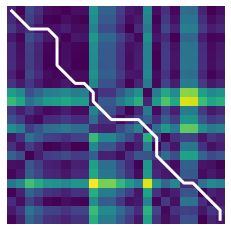

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path1], [i for (i, j) in path1], "w-", linewidth=3.)
plt.show()

In [0]:
path2, dist2 = dtw_path(day1[::60], day3[::60])

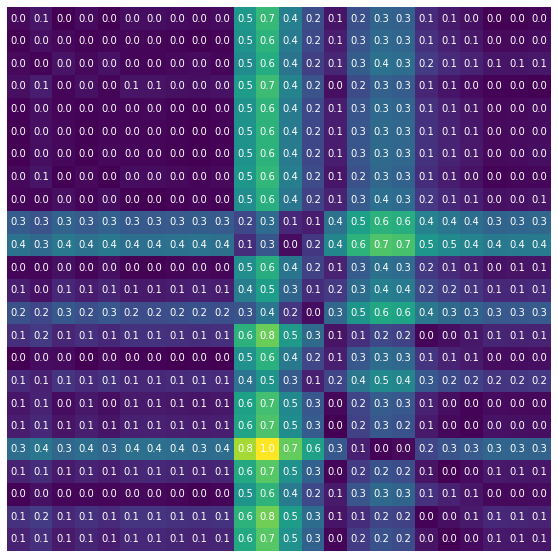

In [0]:
mat = cdist(day1.values[::60].reshape(-1,1), day3.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

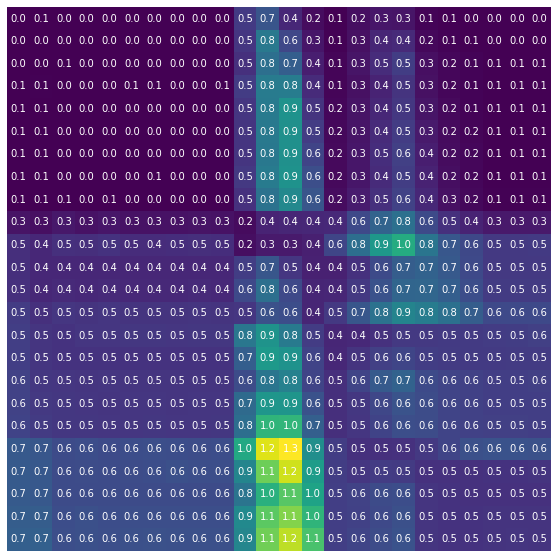

In [0]:
acc = subsequence_cost_matrix(day1.values[::60].reshape(-1,1), day3.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

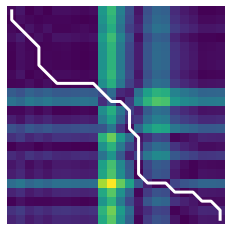

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path2], [i for (i, j) in path2], "w-", linewidth=3.)
plt.show()

In [0]:
path3, dist3 = dtw_path(day1[::60], day4[::60])

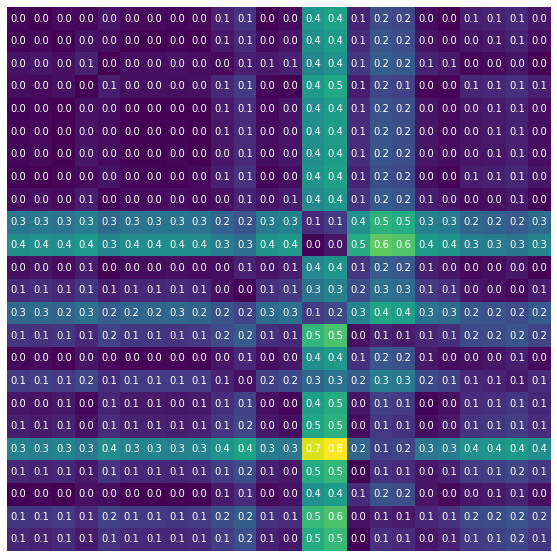

In [0]:
mat = cdist(day1.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

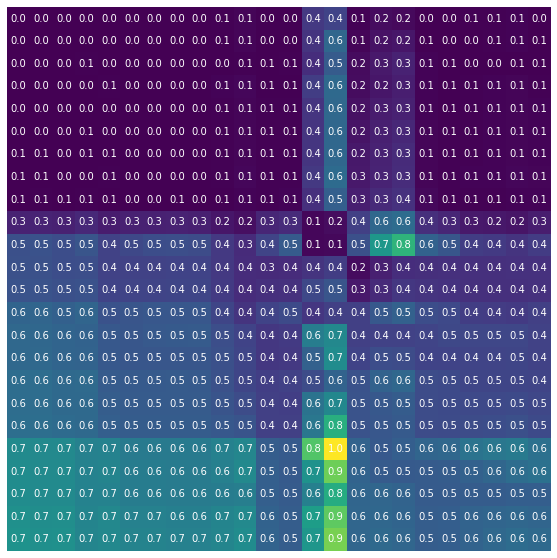

In [0]:
acc = subsequence_cost_matrix(day1.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

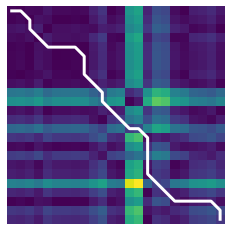

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path3], [i for (i, j) in path3], "w-", linewidth=3.)
plt.show()

In [0]:
path4, dist4 = dtw_path(day1[::60], day5[::60])

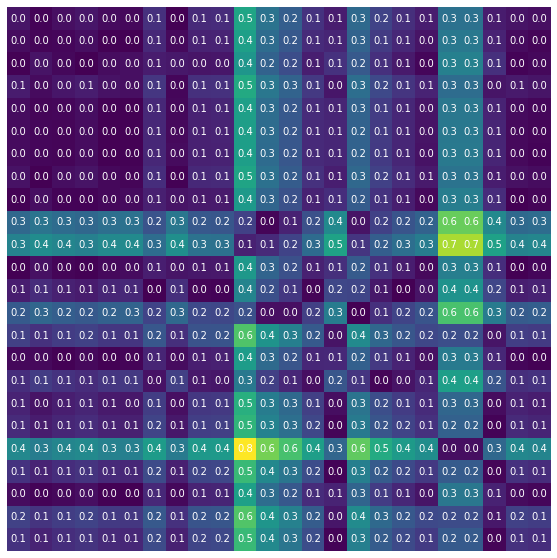

In [0]:
mat = cdist(day1.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

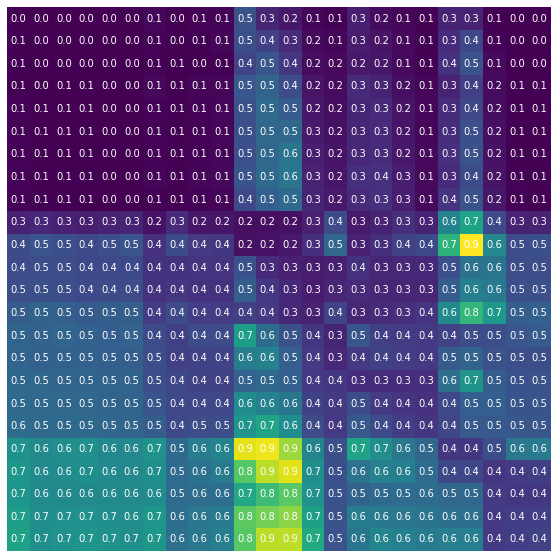

In [0]:
acc = subsequence_cost_matrix(day1.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

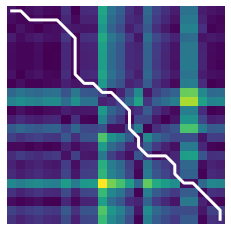

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path4], [i for (i, j) in path4], "w-", linewidth=3.)
plt.show()

In [0]:
path5, dist5 = dtw_path(day2[::60], day3[::60])

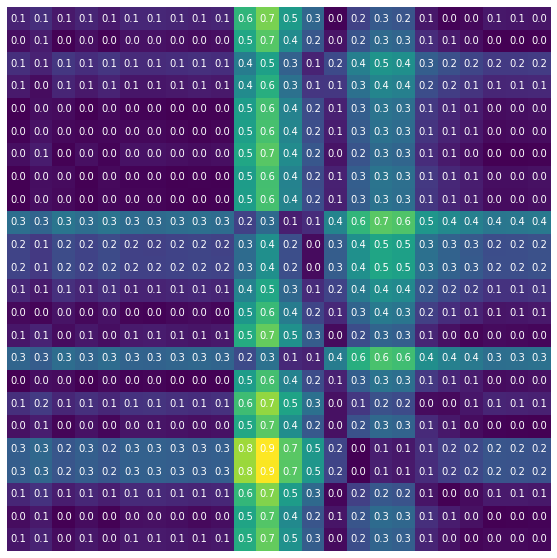

In [0]:
mat = cdist(day2.values[::60].reshape(-1,1), day3.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

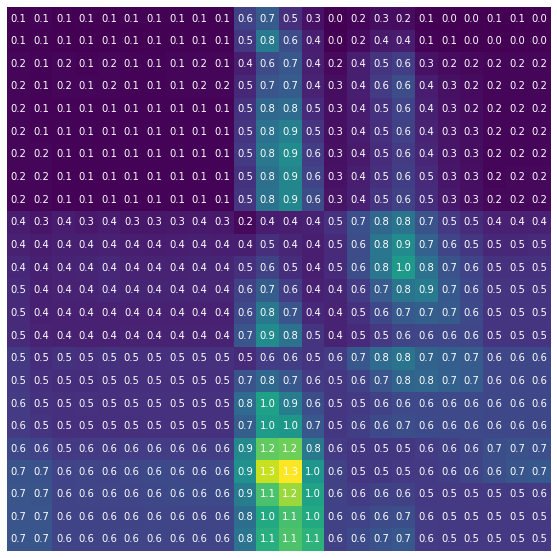

In [0]:
acc = subsequence_cost_matrix(day2.values[::60].reshape(-1,1), day3.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

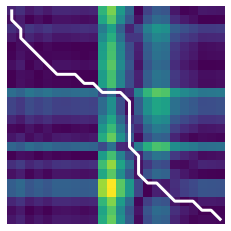

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path5], [i for (i, j) in path5], "w-", linewidth=3.)
plt.show()

In [0]:
path6, dist6 = dtw_path(day2[::60], day4[::60])

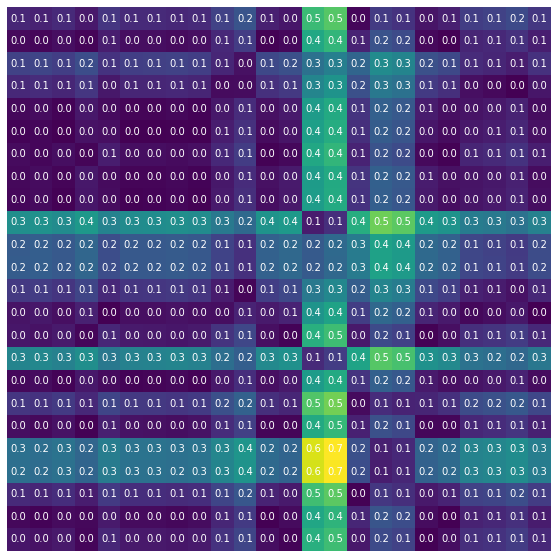

In [0]:
mat = cdist(day2.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

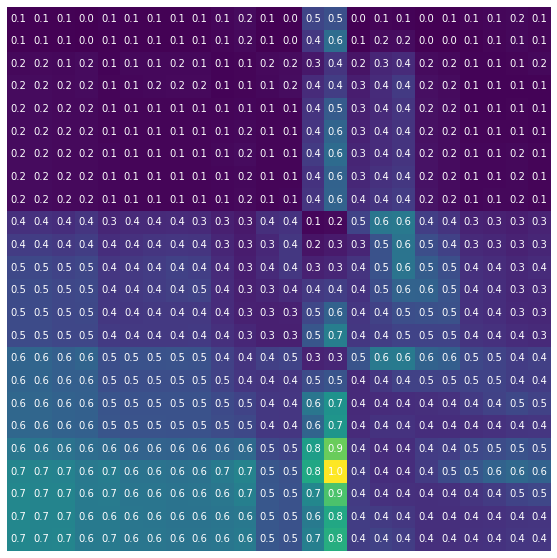

In [0]:
acc = subsequence_cost_matrix(day2.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

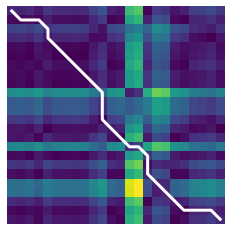

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path6], [i for (i, j) in path6], "w-", linewidth=3.)
plt.show()

In [0]:
path7, dist7 = dtw_path(day2[::60], day5[::60])

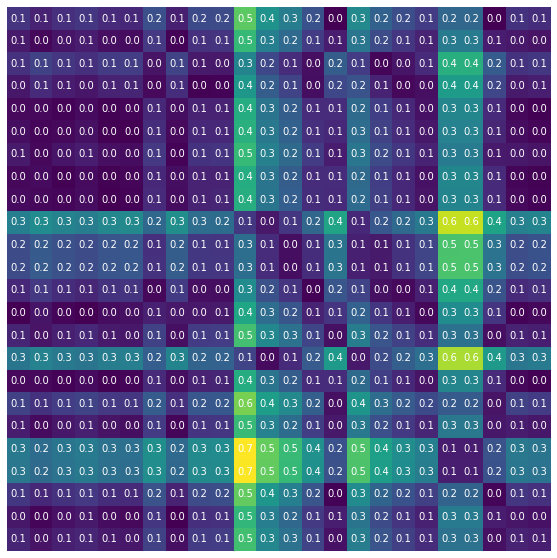

In [0]:
mat = cdist(day2.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

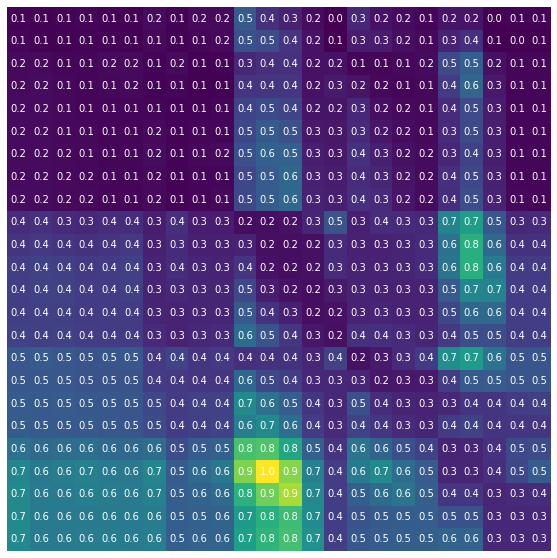

In [0]:
acc = subsequence_cost_matrix(day2.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

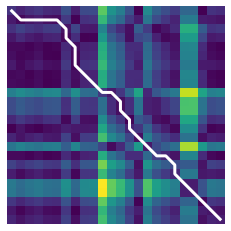

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path7], [i for (i, j) in path7], "w-", linewidth=3.)
plt.show()

In [0]:
path8, dist8 = dtw_path(day3[::60], day4[::60])

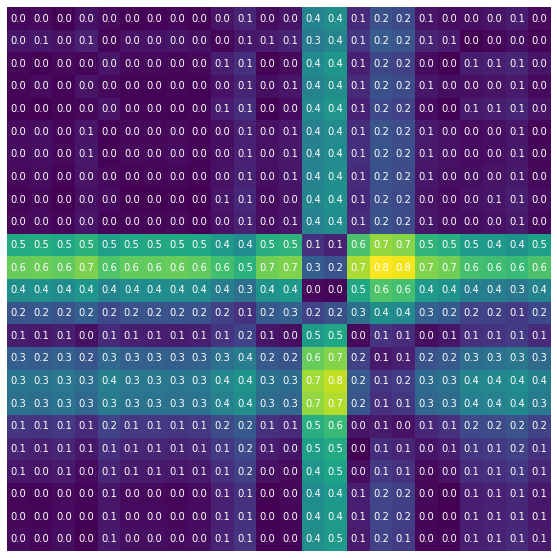

In [0]:
mat = cdist(day3.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

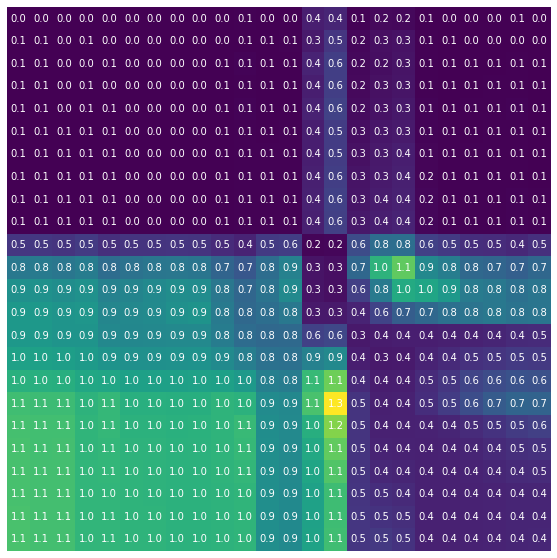

In [0]:
acc = subsequence_cost_matrix(day3.values[::60].reshape(-1,1), day4.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

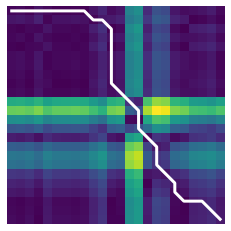

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path8], [i for (i, j) in path8], "w-", linewidth=3.)
plt.show()

In [0]:
path9, dist9 = dtw_path(day3[::60], day5[::60])

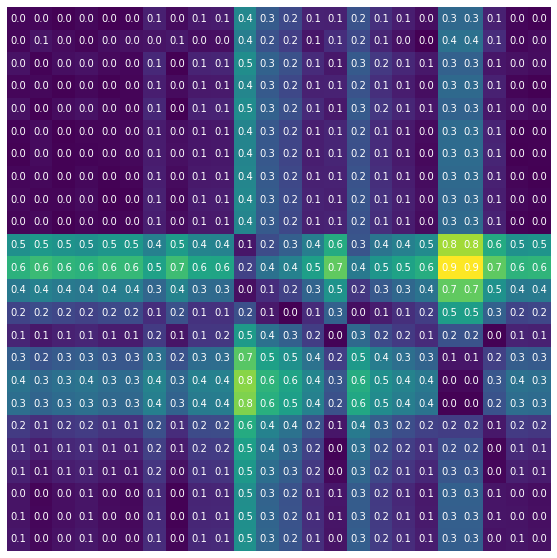

In [0]:
mat = cdist(day3.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

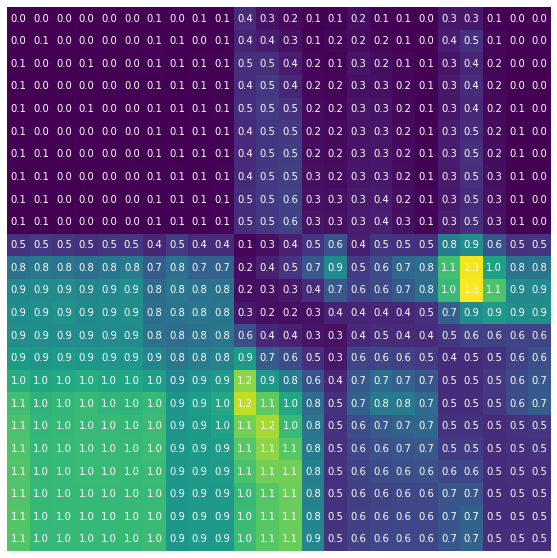

In [0]:
acc = subsequence_cost_matrix(day3.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

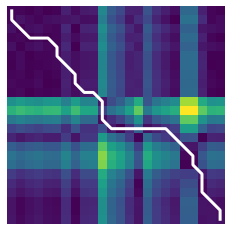

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path9], [i for (i, j) in path9], "w-", linewidth=3.)
plt.show()

In [0]:
path10, dist10 = dtw_path(day4[::60], day5[::60])

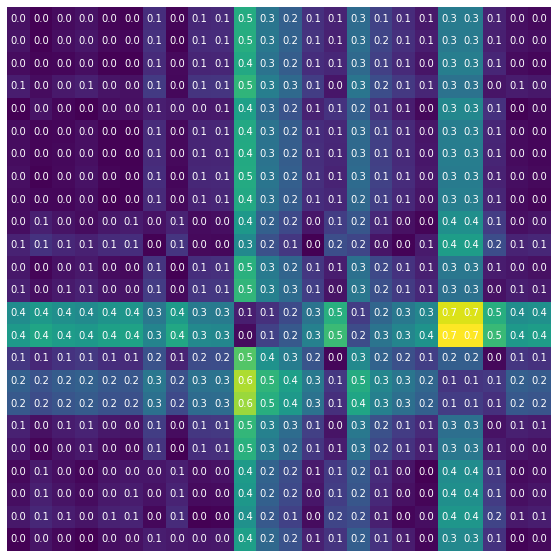

In [0]:
mat = cdist(day4.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

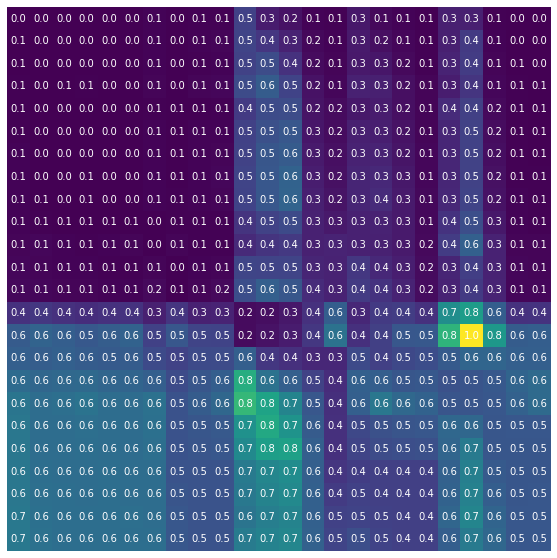

In [0]:
acc = subsequence_cost_matrix(day4.values[::60].reshape(-1,1), day5.values[::60].reshape(-1,1))
plt.figure(figsize=(10,10))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

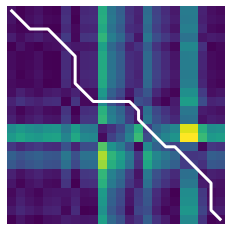

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path10], [i for (i, j) in path10], "w-", linewidth=3.)
plt.show()

# Feature Light as univariate framework

In [0]:
url = 'https://raw.githubusercontent.com/ZioTrib/dm2proj/master/datatraining.csv'
df = pd.read_csv(url) 

In [0]:
df['date'] = pd.to_datetime(df['date'])

In [0]:
df = df.set_index(['date'])

In [0]:
df = df[['Light','Occupancy']]
df.head()

,Light,Occupancy
date,,
2015-02-04 17:51:00,426.0,1
2015-02-04 17:51:59,429.5,1
2015-02-04 17:53:00,426.0,1
2015-02-04 17:54:00,426.0,1
2015-02-04 17:55:00,426.0,1


In [0]:
day_4_02 = df['2015-02-04']
day_5_02 = df['2015-02-05']
day_6_02 = df['2015-02-06']
day_7_02 = df['2015-02-07']
day_8_02 = df['2015-02-08']
day_9_02 = df['2015-02-09']
day_10_02 = df['2015-02-10']

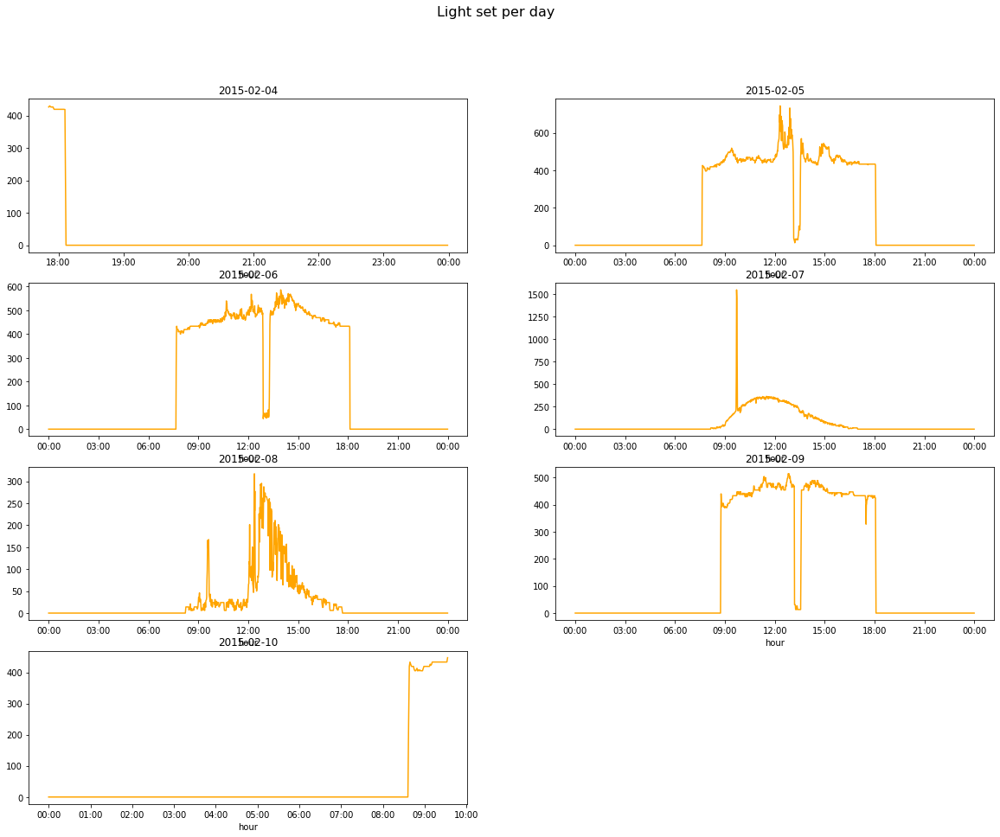

In [0]:
import matplotlib.dates as mdates

fig, axs = plt.subplots(4, 2, figsize=(20,15))
axs[-1, -1].axis('off')
fig.suptitle('Light set per day', fontsize=16)
xfmt = mdates.DateFormatter('%H:%M')

axs[0,0].plot(day_4_02['Light'],c ='orange')
axs[0,0].xaxis.set_major_formatter(xfmt)
axs[0,0].set_xlabel('hour')
axs[0,0].set_title('2015-02-04')

axs[0,1].plot(day_5_02['Light'],c ='orange')
axs[0,1].xaxis.set_major_formatter(xfmt)
axs[0,1].set_xlabel('hour')
axs[0,1].set_title('2015-02-05')

axs[1,0].plot(day_6_02['Light'],c ='orange')
axs[1,0].xaxis.set_major_formatter(xfmt)
axs[1,0].set_xlabel('hour')
axs[1,0].set_title('2015-02-06')

axs[1,1].plot(day_7_02['Light'],c ='orange')
axs[1,1].xaxis.set_major_formatter(xfmt)
axs[1,1].set_xlabel('hour')
axs[1,1].set_title('2015-02-07')

axs[2,0].plot(day_8_02['Light'],c ='orange')
axs[2,0].xaxis.set_major_formatter(xfmt)
axs[2,0].set_xlabel('hour')
axs[2,0].set_title('2015-02-08')

axs[2,1].plot(day_9_02['Light'],c ='orange')
axs[2,1].xaxis.set_major_formatter(xfmt)
axs[2,1].set_xlabel('hour')
axs[2,1].set_title('2015-02-09')

axs[3,0].plot(day_10_02['Light'],c ='orange')
axs[3,0].xaxis.set_major_formatter(xfmt)
axs[3,0].set_xlabel('hour')
axs[3,0].set_title('2015-02-10')

plt.show()

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

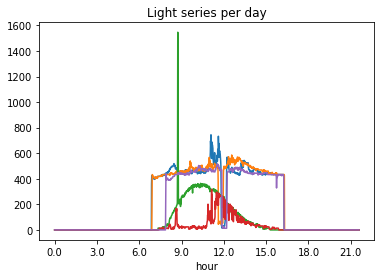

In [0]:
plt.plot(day_5_02['Light'])
plt.plot(day_6_02['Light'])
plt.plot(day_7_02['Light'])
plt.plot(day_8_02['Light'])
plt.plot(day_9_02['Light'])
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.title('Light series per day')
plt.show()

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

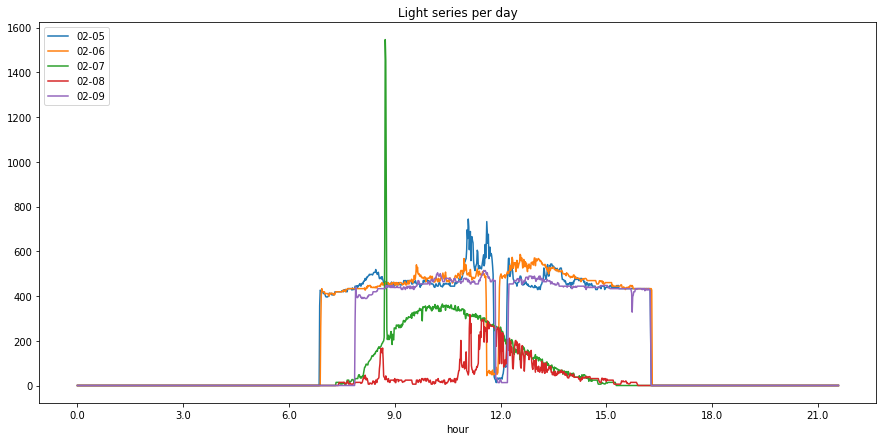

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02['Light'])
plt.plot(day_6_02['Light'])
plt.plot(day_7_02['Light'])
plt.plot(day_8_02['Light'])
plt.plot(day_9_02['Light'])
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'], loc = 'upper left')
plt.title('Light series per day')
plt.show()

### Offset Translation : non è una buona trasformazione

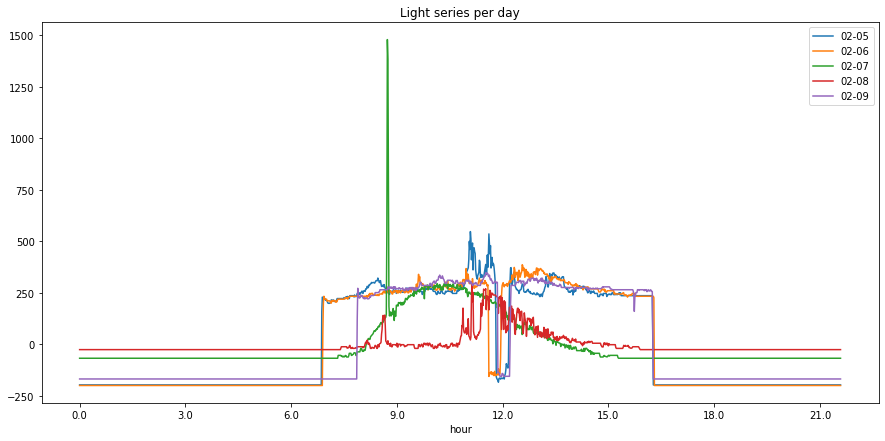

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02['Light']-day_5_02['Light'].mean())
plt.plot(day_6_02['Light']-day_6_02['Light'].mean())
plt.plot(day_7_02['Light']-day_7_02['Light'].mean())
plt.plot(day_8_02['Light']-day_8_02['Light'].mean())
plt.plot(day_9_02['Light']-day_9_02['Light'].mean())
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Light series per day')
plt.show()

### Amplitude Scaling : non è una buona trasformazione

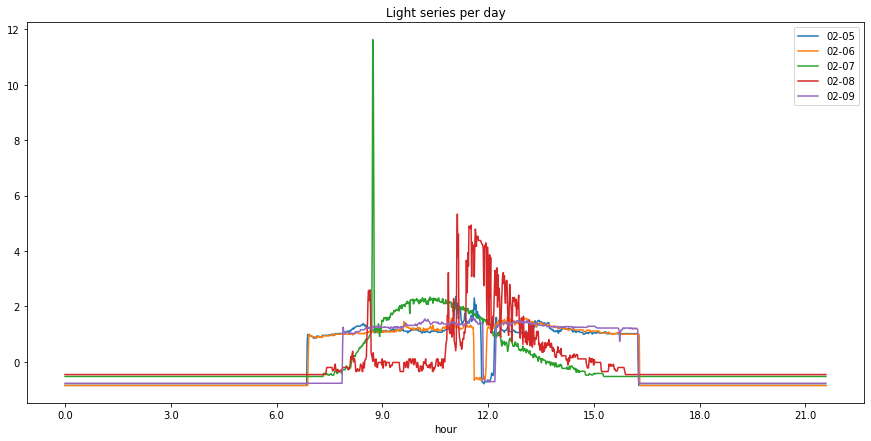

In [0]:
plt.figure(figsize=(15,7))
plt.plot((day_5_02['Light']-day_5_02['Light'].mean())/day_5_02['Light'].std())
plt.plot((day_6_02['Light']-day_6_02['Light'].mean())/day_6_02['Light'].std())
plt.plot((day_7_02['Light']-day_7_02['Light'].mean())/day_7_02['Light'].std())
plt.plot((day_8_02['Light']-day_8_02['Light'].mean())/day_8_02['Light'].std())
plt.plot((day_9_02['Light']-day_9_02['Light'].mean())/day_9_02['Light'].std())
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Light series per day')
plt.show()

### Linear Trend

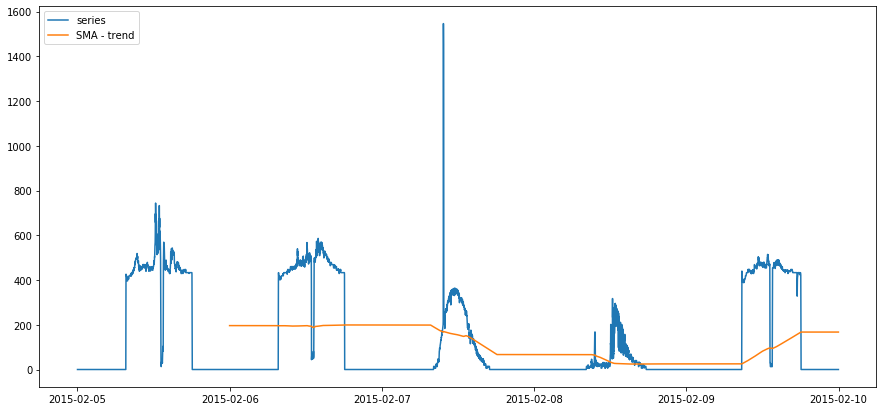

In [0]:
ts = df['Light'].loc['2015-02-05':'2015-02-09']
sma = ts.rolling(window = 1440).mean()       #simple moving average
plt.figure(figsize=(15,7))
plt.plot(ts)
plt.plot(sma)
plt.legend(['series','SMA - trend'], loc = 'upper left')   # perchè in un giorno ci sono 1440 min
plt.show()

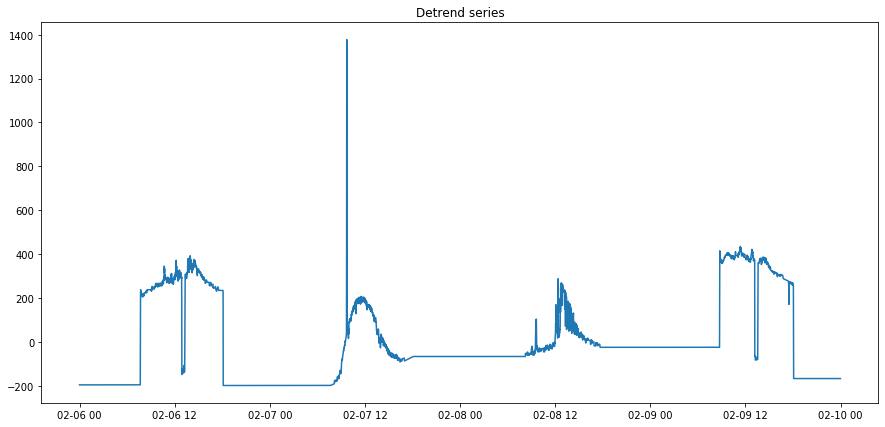

In [0]:
plt.figure(figsize=(15,7))
ts_shift = ts - sma
plt.plot(ts_shift)
plt.title('Detrend series')
plt.show()

### Noise

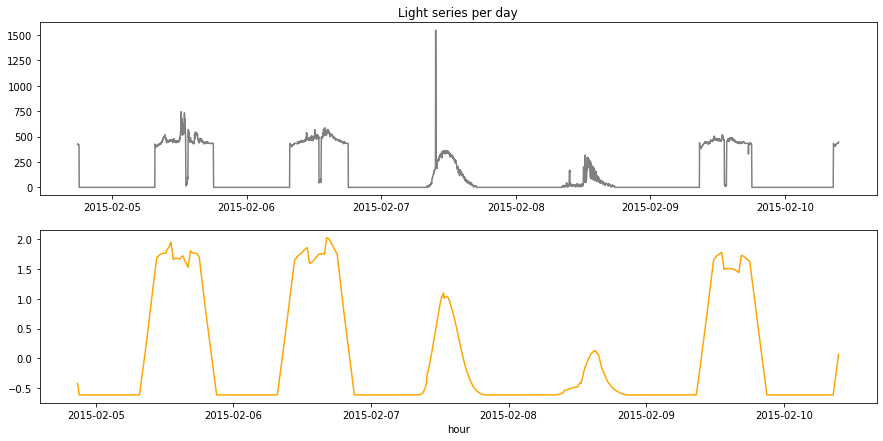

In [0]:
w = 180
plt.figure(figsize=(15,7))
plt.subplot(212)
df_denoised = ((df['Light']-df['Light'].mean())/df['Light'].std()).rolling(window=w).mean()
plt.plot(df_denoised, c = 'orange')
plt.xlabel('hour')

plt.subplot(211)
plt.plot(df['Light'], c = 'grey')

plt.title('Light series per day')
plt.show()

#### Trend on Denoised

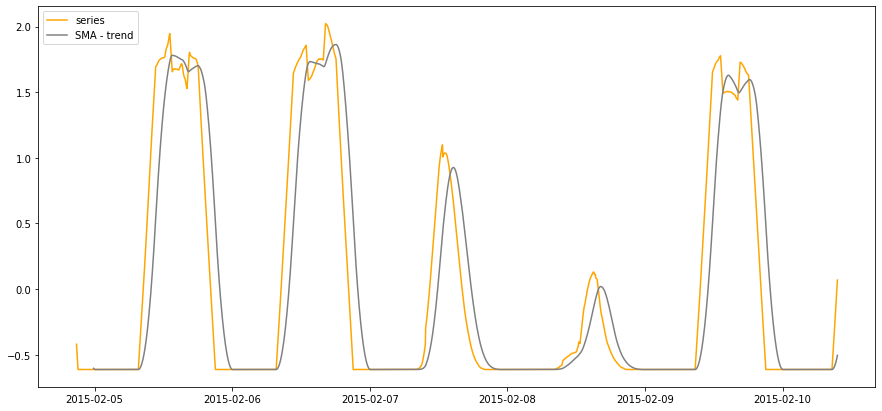

In [0]:
ts = df_denoised.loc['2015-02-04':'2015-02-10']
sma = ts.rolling(window = 180).mean()       #simple moving average
plt.figure(figsize=(15,7))
plt.plot(ts, c ='orange')
plt.plot(sma, c = 'grey')
plt.legend(['series','SMA - trend'], loc = 'upper left')   
plt.show()

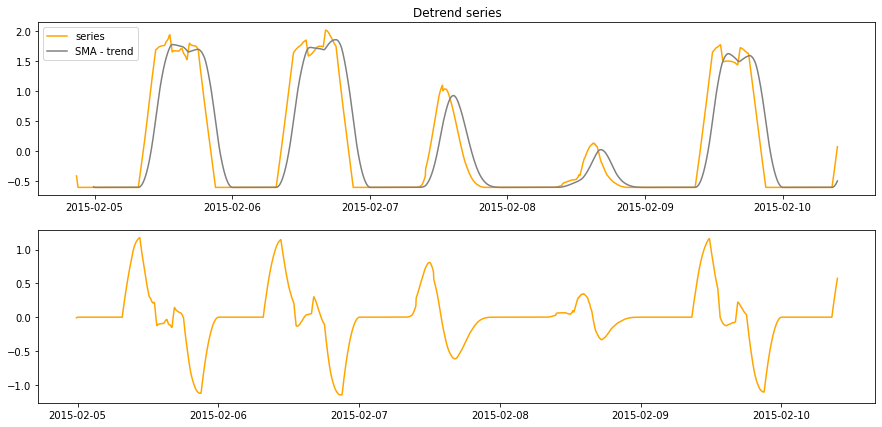

In [0]:
plt.figure(figsize=(15,7))
plt.subplot(211)
ts = df_denoised.loc['2015-02-04':'2015-02-10']
sma = ts.rolling(window = 180).mean()       #simple moving average
plt.plot(ts, c ='orange')
plt.plot(sma, c = 'grey')
plt.title('Detrend series')

plt.legend(['series','SMA - trend'], loc = 'upper left')   

plt.subplot(212)
ts_shift = ts - sma
plt.plot(ts_shift, c = 'orange')
plt.show()

In [0]:
day_4_02 = ts_shift['2015-02-04']
day_5_02 = ts_shift['2015-02-05']
day_6_02 = ts_shift['2015-02-06']
day_7_02 = ts_shift['2015-02-07']
day_8_02 = ts_shift['2015-02-08']
day_9_02 = ts_shift['2015-02-09']
day_10_02 = ts_shift['2015-02-10']

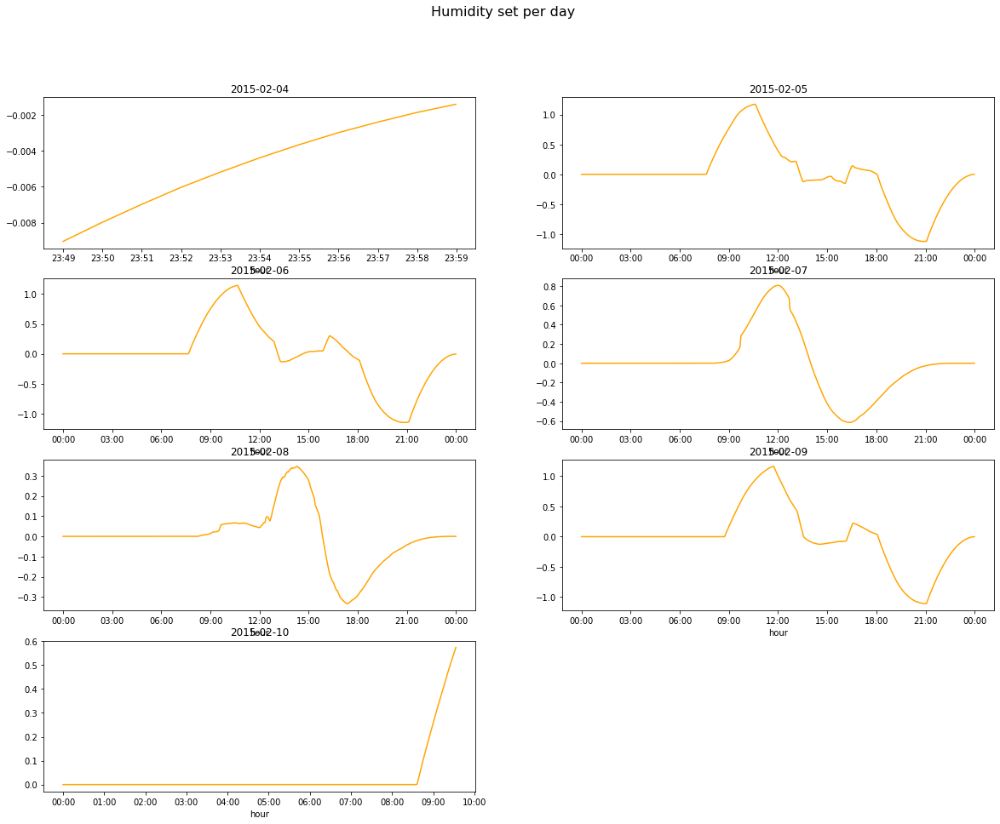

In [0]:
import matplotlib.dates as mdates

fig, axs = plt.subplots(4, 2, figsize=(20,15))
axs[-1, -1].axis('off')
fig.suptitle('Humidity set per day', fontsize=16)
xfmt = mdates.DateFormatter('%H:%M')

axs[0,0].plot(day_4_02,c ='orange')
axs[0,0].xaxis.set_major_formatter(xfmt)
axs[0,0].set_xlabel('hour')
axs[0,0].set_title('2015-02-04')

axs[0,1].plot(day_5_02,c ='orange')
axs[0,1].xaxis.set_major_formatter(xfmt)
axs[0,1].set_xlabel('hour')
axs[0,1].set_title('2015-02-05')

axs[1,0].plot(day_6_02,c ='orange')
axs[1,0].xaxis.set_major_formatter(xfmt)
axs[1,0].set_xlabel('hour')
axs[1,0].set_title('2015-02-06')

axs[1,1].plot(day_7_02,c ='orange')
axs[1,1].xaxis.set_major_formatter(xfmt)
axs[1,1].set_xlabel('hour')
axs[1,1].set_title('2015-02-07')

axs[2,0].plot(day_8_02,c ='orange')
axs[2,0].xaxis.set_major_formatter(xfmt)
axs[2,0].set_xlabel('hour')
axs[2,0].set_title('2015-02-08')

axs[2,1].plot(day_9_02,c ='orange')
axs[2,1].xaxis.set_major_formatter(xfmt)
axs[2,1].set_xlabel('hour')
axs[2,1].set_title('2015-02-09')

axs[3,0].plot(day_10_02,c ='orange')
axs[3,0].xaxis.set_major_formatter(xfmt)
axs[3,0].set_xlabel('hour')
axs[3,0].set_title('2015-02-10')

plt.show()

#### Euclidean distance

In [0]:
from scipy.spatial.distance import euclidean

In [0]:
dist_eucl_day5_day6 = euclidean(day_5_02, day_6_02)

dist_eucl_day5_day7 = euclidean(day_5_02, day_7_02)

dist_eucl_day5_day8 = euclidean(day_5_02, day_8_02)

dist_eucl_day5_day9 = euclidean(day_5_02, day_9_02)

dist_eucl_day6_day7 = euclidean(day_6_02, day_7_02)

dist_eucl_day6_day8 = euclidean(day_6_02, day_8_02)

dist_eucl_day6_day9 = euclidean(day_6_02, day_9_02)

dist_eucl_day7_day8 = euclidean(day_7_02, day_8_02)

dist_eucl_day7_day9 = euclidean(day_7_02, day_9_02)

dist_eucl_day8_day9 = euclidean(day_8_02, day_9_02)

In [0]:
from prettytable import PrettyTable

table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_eucl_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_eucl_day5_day7, dist_eucl_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_eucl_day5_day8, dist_eucl_day6_day8, dist_eucl_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_eucl_day5_day9, dist_eucl_day6_day9, dist_eucl_day7_day9,dist_eucl_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+--------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02      | day_9_02 |
+----------+--------------------+--------------------+--------------------+--------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -          |    -     |
| day_6_02 | 2.590248213324453  |         0          |         -          |         -          |    -     |
| day_7_02 | 17.49854384503271  | 18.381026489206533 |         0          |         -          |    -     |
| day_8_02 | 18.572788762723885 |  18.8954140883639  | 11.075489133923218 |         0          |    -     |
| day_9_02 | 8.199720093824903  |  8.16012970856576  | 15.18992404561067  | 18.053623556845913 |    0     |
+----------+--------------------+--------------------+--------------------+--------------------+----------+


#### Manhattan distance

In [0]:
from scipy.spatial.distance import cityblock

In [0]:
dist_city_day5_day6 = cityblock(day_5_02, day_6_02)

dist_city_day5_day7 = cityblock(day_5_02, day_7_02)

dist_city_day5_day8 = cityblock(day_5_02, day_8_02)

dist_city_day5_day9 = cityblock(day_5_02, day_9_02)

dist_city_day6_day7 = cityblock(day_6_02, day_7_02)

dist_city_day6_day8 = cityblock(day_6_02, day_8_02)

dist_city_day6_day9 = cityblock(day_6_02, day_9_02)

dist_city_day7_day8 = cityblock(day_7_02, day_8_02)

dist_city_day7_day9 = cityblock(day_7_02, day_9_02)

dist_city_day8_day9 = cityblock(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_city_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_city_day5_day7, dist_city_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_city_day5_day8, dist_city_day6_day8, dist_city_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_city_day5_day9, dist_city_day6_day9, dist_city_day7_day9,dist_city_day8_day9,0])

print(table)

+----------+--------------------+--------------------+--------------------+--------------------+----------+
|   Days   |      day_5_02      |      day_6_02      |      day_7_02      |      day_8_02      | day_9_02 |
+----------+--------------------+--------------------+--------------------+--------------------+----------+
| day_5_02 |         0          |         -          |         -          |         -          |    -     |
| day_6_02 | 56.66249152521924  |         0          |         -          |         -          |    -     |
| day_7_02 | 467.61060088336916 | 493.66082601501677 |         0          |         -          |    -     |
| day_8_02 | 482.52515672490233 | 495.0318768830631  | 232.14453412464047 |         0          |    -     |
| day_9_02 | 160.87988537680684 | 185.98482715762412 | 370.06609917365284 | 460.16074892075534 |    0     |
+----------+--------------------+--------------------+--------------------+--------------------+----------+


#### Dynamic Time Warping

In [0]:
pip install tslearn

Note: you may need to restart the kernel to use updated packages.


In [0]:
from tslearn.metrics import dtw, dtw_path, cdist_dtw, subsequence_cost_matrix

In [0]:
dist_dtw_day5_day6 = dtw(day_5_02, day_6_02)

dist_dtw_day5_day7 = dtw(day_5_02, day_7_02)

dist_dtw_day5_day8 = dtw(day_5_02, day_8_02)

dist_dtw_day5_day9 = dtw(day_5_02, day_9_02)

dist_dtw_day6_day7 = dtw(day_6_02, day_7_02)

dist_dtw_day6_day8 = dtw(day_6_02, day_8_02)

dist_dtw_day6_day9 = dtw(day_6_02, day_9_02)

dist_dtw_day7_day8 = dtw(day_7_02, day_8_02)

dist_dtw_day7_day9 = dtw(day_7_02, day_9_02)

dist_dtw_day8_day9 = dtw(day_8_02, day_9_02)

In [0]:
table = PrettyTable(['Days', 'day_5_02', 'day_6_02', 'day_7_02','day_8_02', 'day_9_02'])

table.align = 'c'
              
table.add_row(['day_5_02', 0, '-', '-','-','-'])
table.add_row(['day_6_02', dist_dtw_day5_day6, 0, '-','-','-'])
table.add_row(['day_7_02', dist_dtw_day5_day7, dist_dtw_day6_day7, 0,'-','-'])
table.add_row(['day_8_02', dist_dtw_day5_day8, dist_dtw_day6_day8, dist_dtw_day7_day8,0,'-'])
table.add_row(['day_9_02', dist_dtw_day5_day9, dist_dtw_day6_day9, dist_dtw_day7_day9,dist_dtw_day8_day9,0])

print(table)

+----------+---------------------+---------------------+-------------------+--------------------+----------+
|   Days   |       day_5_02      |       day_6_02      |      day_7_02     |      day_8_02      | day_9_02 |
+----------+---------------------+---------------------+-------------------+--------------------+----------+
| day_5_02 |          0          |          -          |         -         |         -          |    -     |
| day_6_02 |  0.8215402300437119 |          0          |         -         |         -          |    -     |
| day_7_02 |  5.792330510153647  |  6.2010559818503905 |         0         |         -          |    -     |
| day_8_02 |  11.983154018950433 |  12.29308588671748  | 5.288926851205598 |         0          |    -     |
| day_9_02 | 0.46024557841347785 | 0.38786711034940263 | 5.529632136530093 | 11.618367397725596 |    0     |
+----------+---------------------+---------------------+-------------------+--------------------+----------+


###### Day 5 and Day 6

In [0]:
path, dist = dtw_path(day_5_02[::30], day_6_02[::30])

In [0]:
from scipy.spatial.distance import cdist

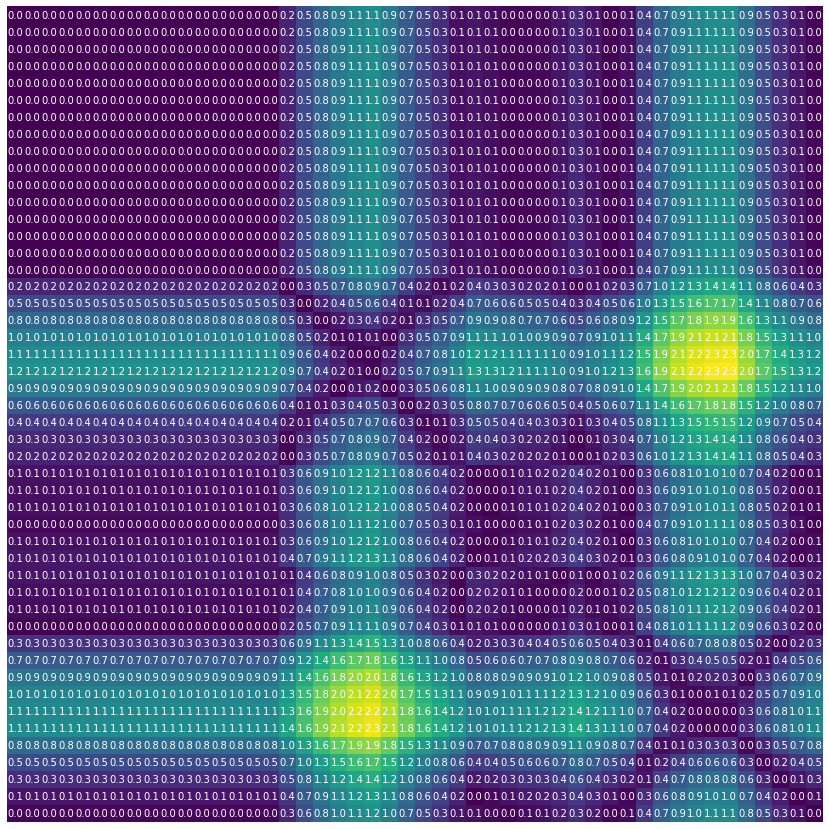

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

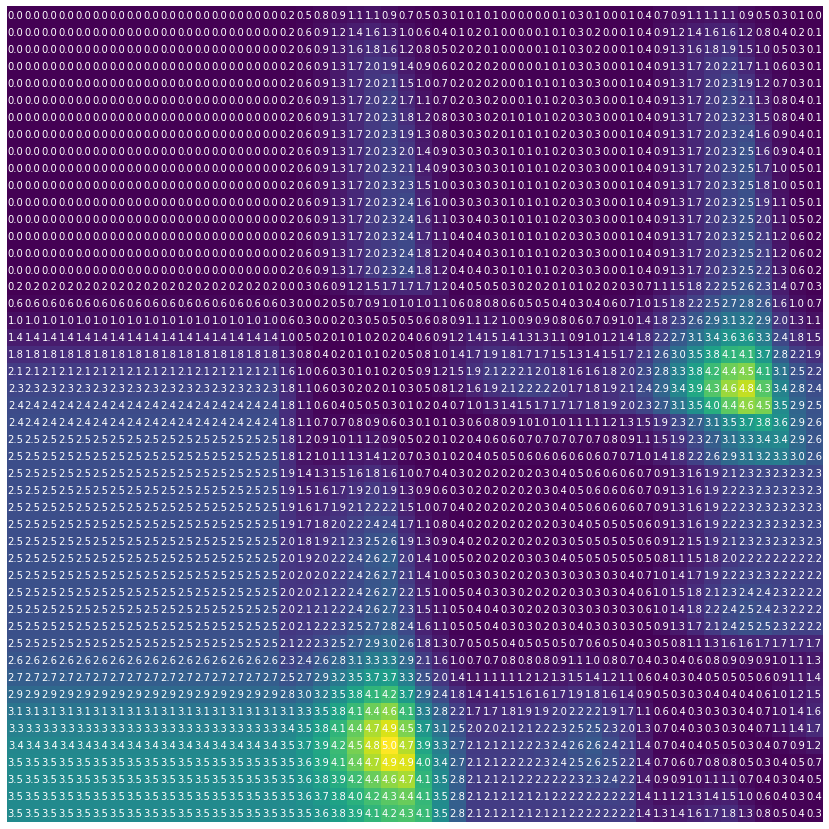

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_6_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

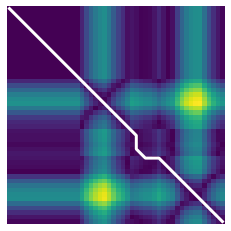

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 7

In [0]:
path, dist = dtw_path(day_5_02[::30], day_7_02[::30])

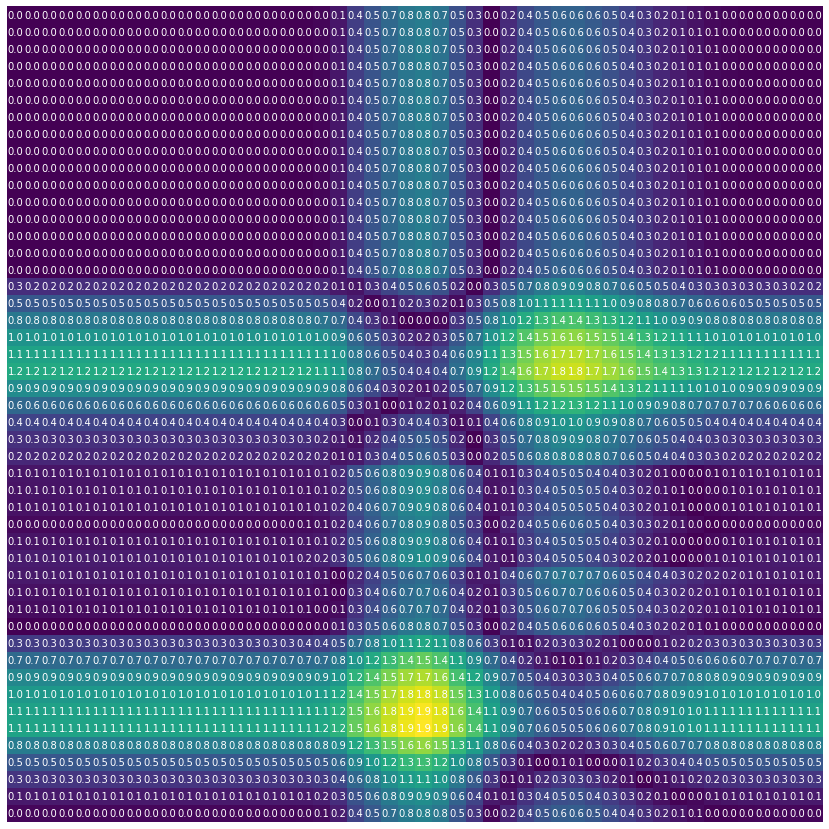

In [0]:
mat = cdist(day_5_02[::30].values.reshape(-1,1),  day_7_02[::30].values.reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

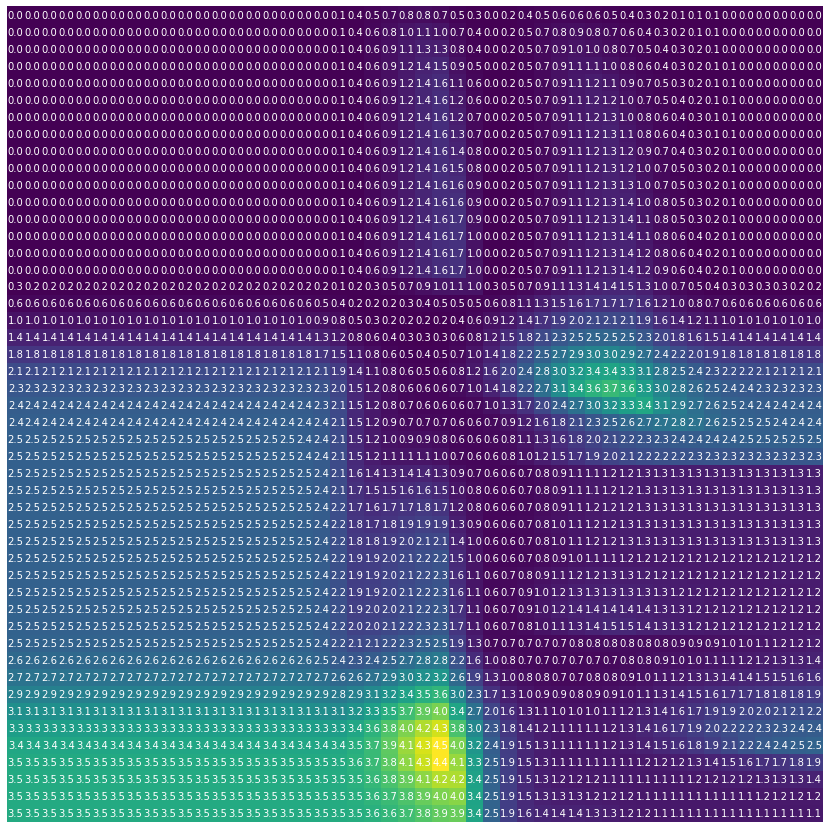

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

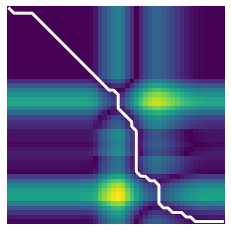

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 8

In [0]:
path, dist = dtw_path(day_5_02[::30], day_8_02[::30])

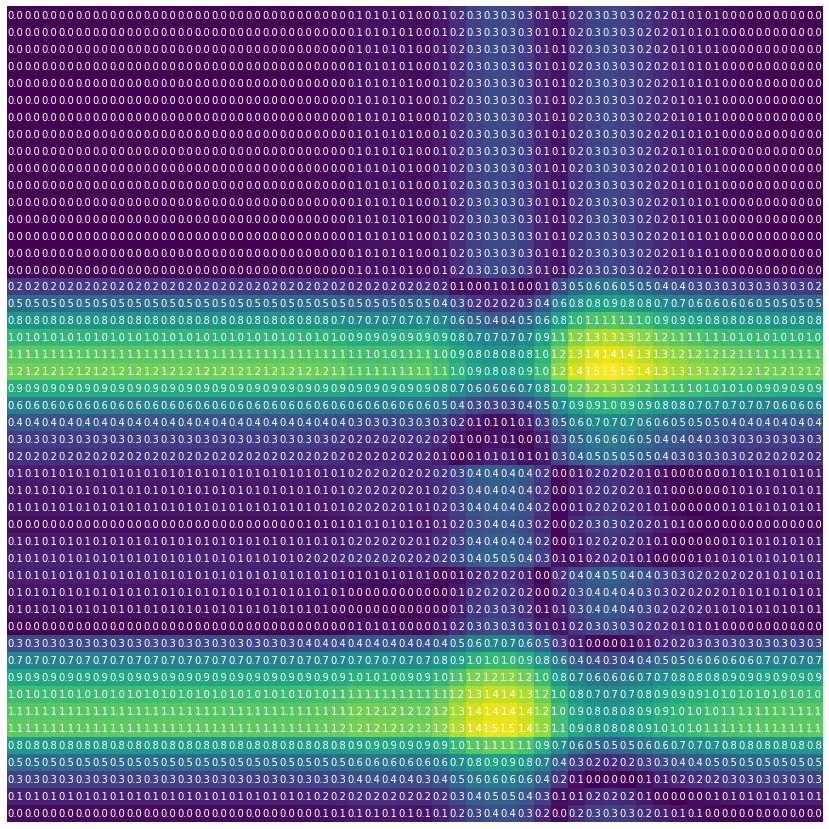

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

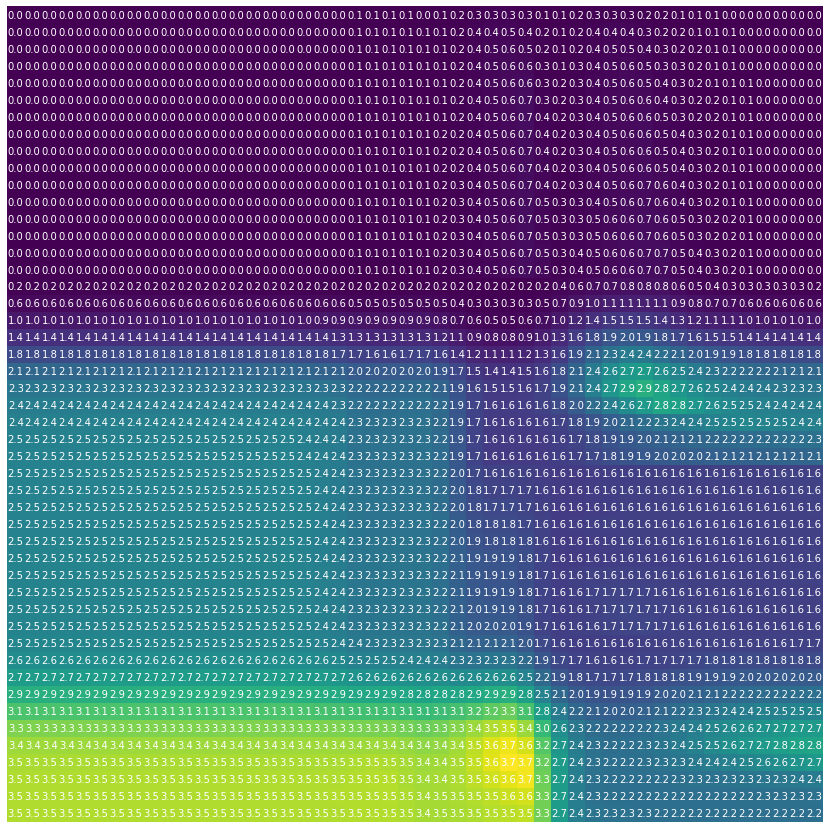

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

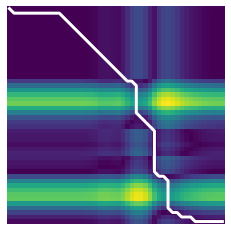

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 5 and Day 9

In [0]:
path, dist = dtw_path(day_5_02[::30], day_9_02[::30])

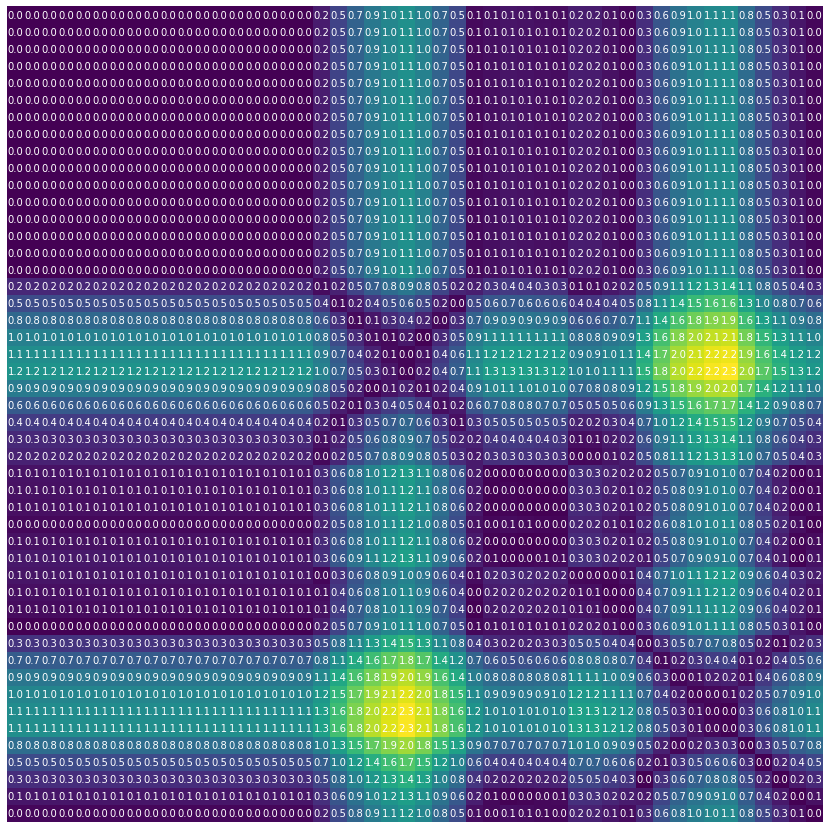

In [0]:
mat = cdist(day_5_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

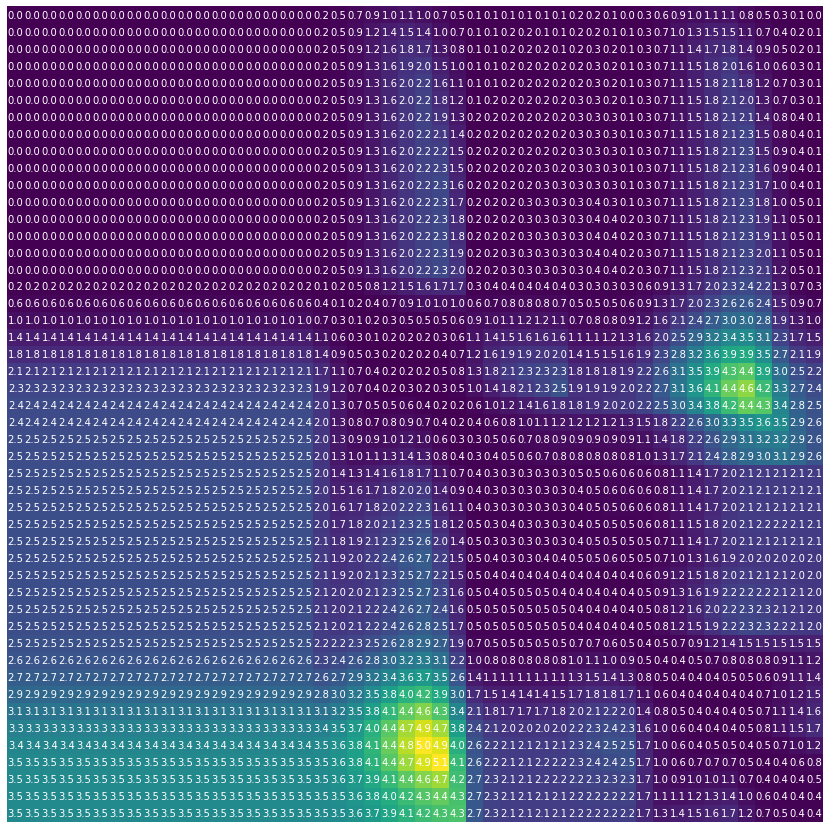

In [0]:
acc = subsequence_cost_matrix(day_5_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

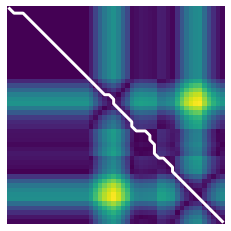

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 7

In [0]:
path, dist = dtw_path(day_6_02[::30], day_7_02[::30])

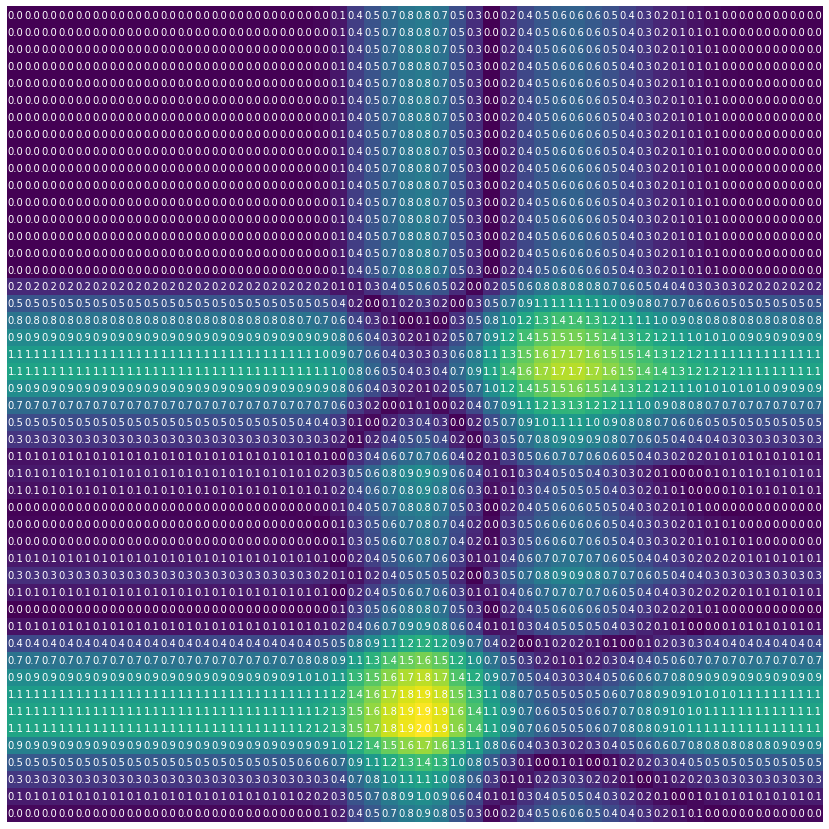

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

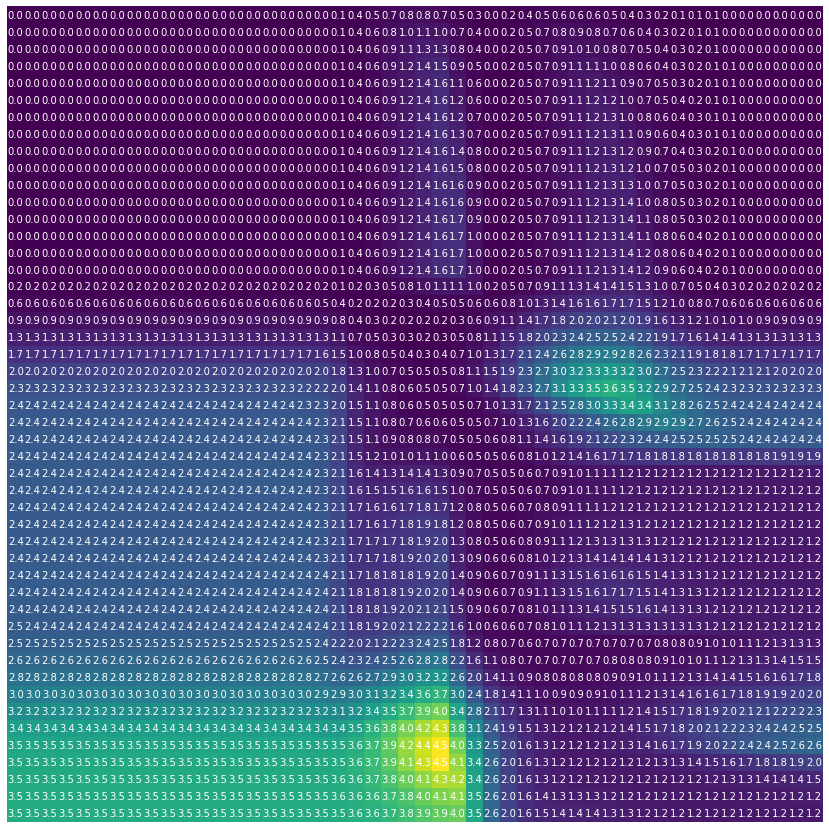

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_7_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

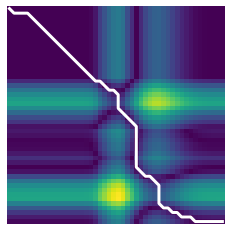

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 8

In [0]:
path, dist = dtw_path(day_6_02[::30], day_8_02[::30])

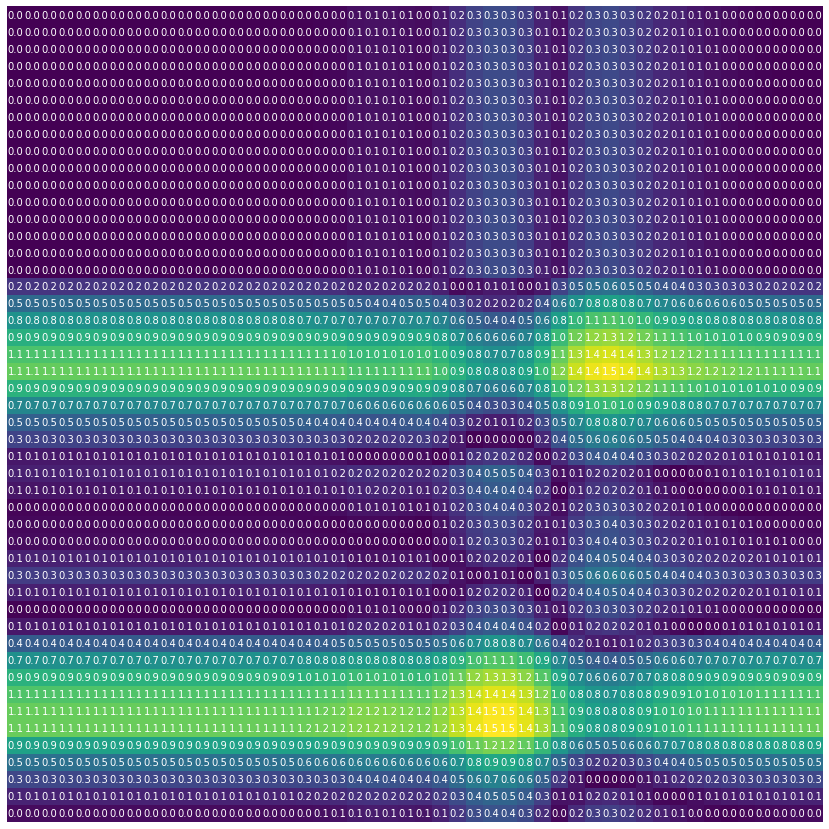

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

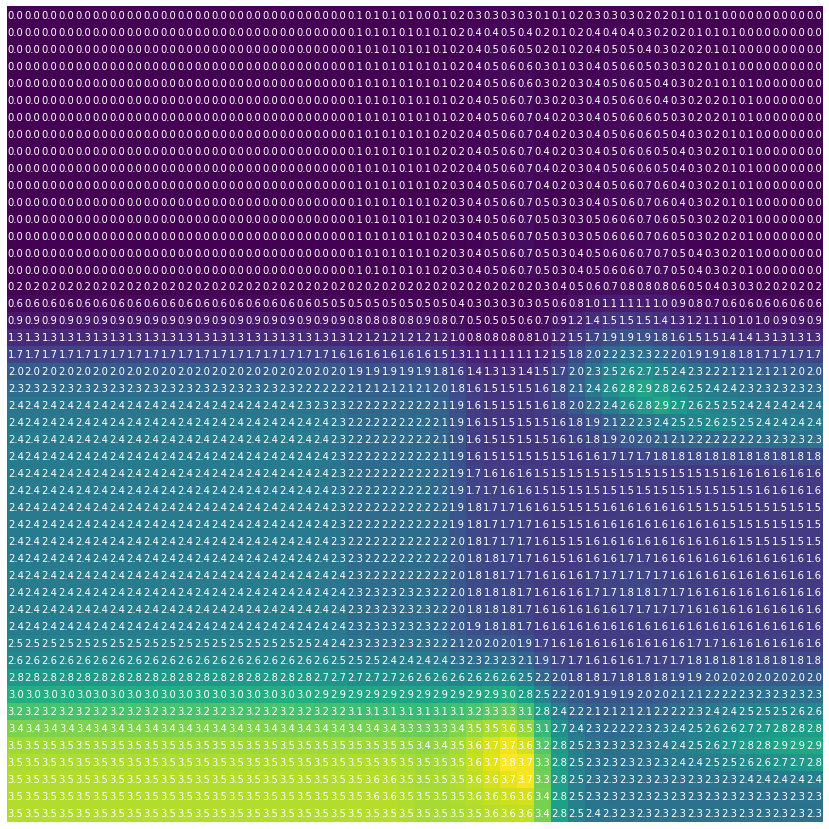

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

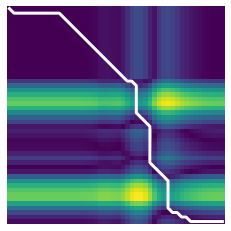

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 6 and Day 9

In [0]:
path, dist = dtw_path(day_6_02[::30], day_9_02[::30])

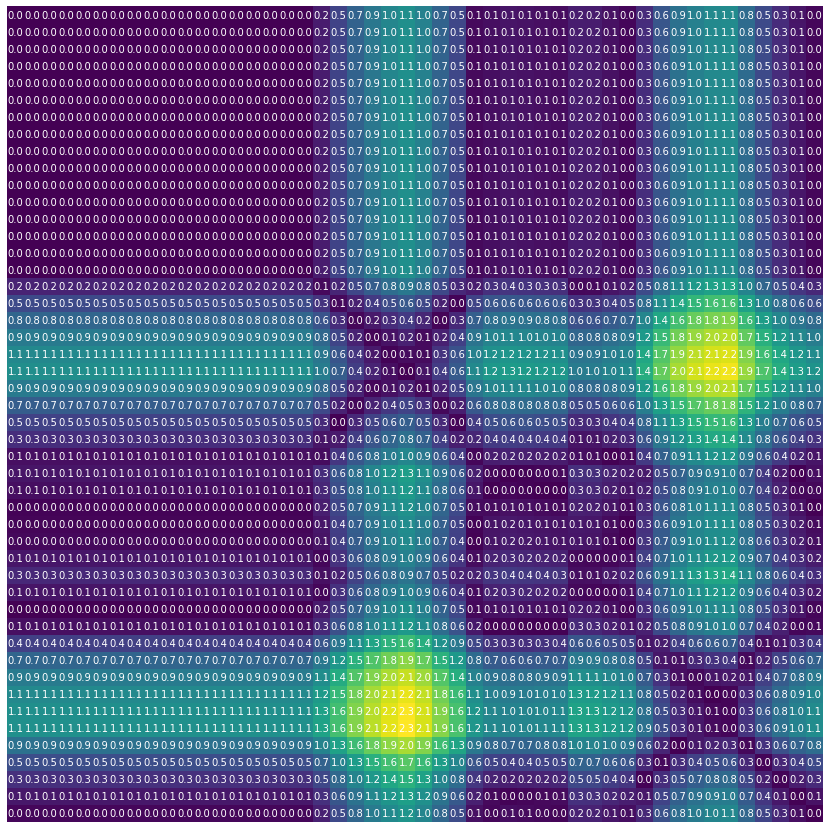

In [0]:
mat = cdist(day_6_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

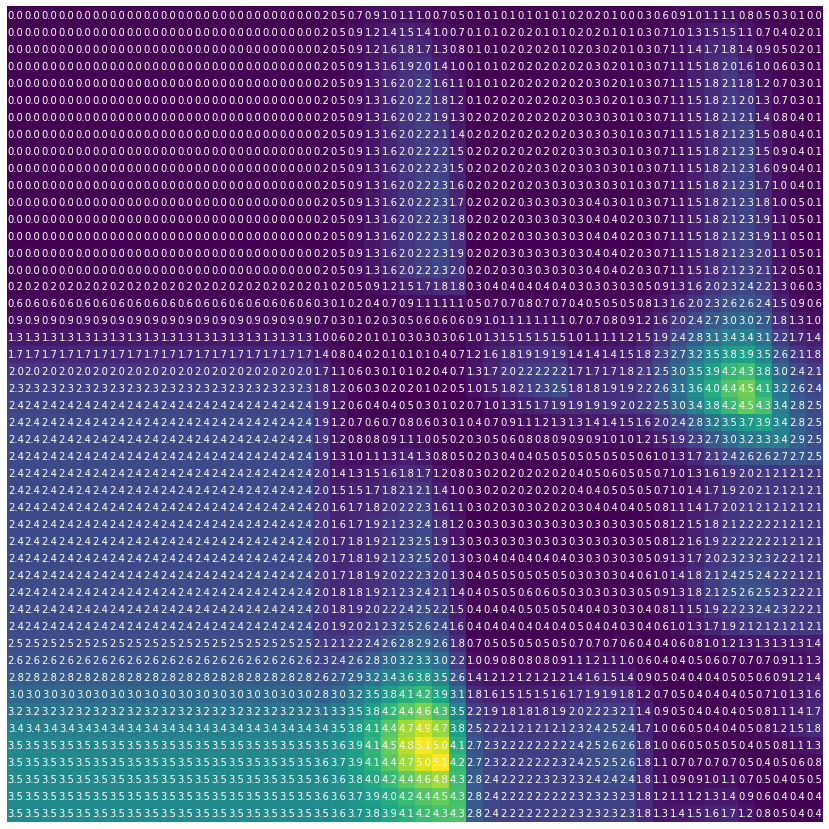

In [0]:
acc = subsequence_cost_matrix(day_6_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

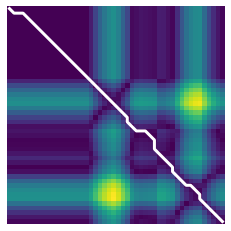

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 8

In [0]:
path, dist = dtw_path(day_7_02[::30], day_8_02[::30])

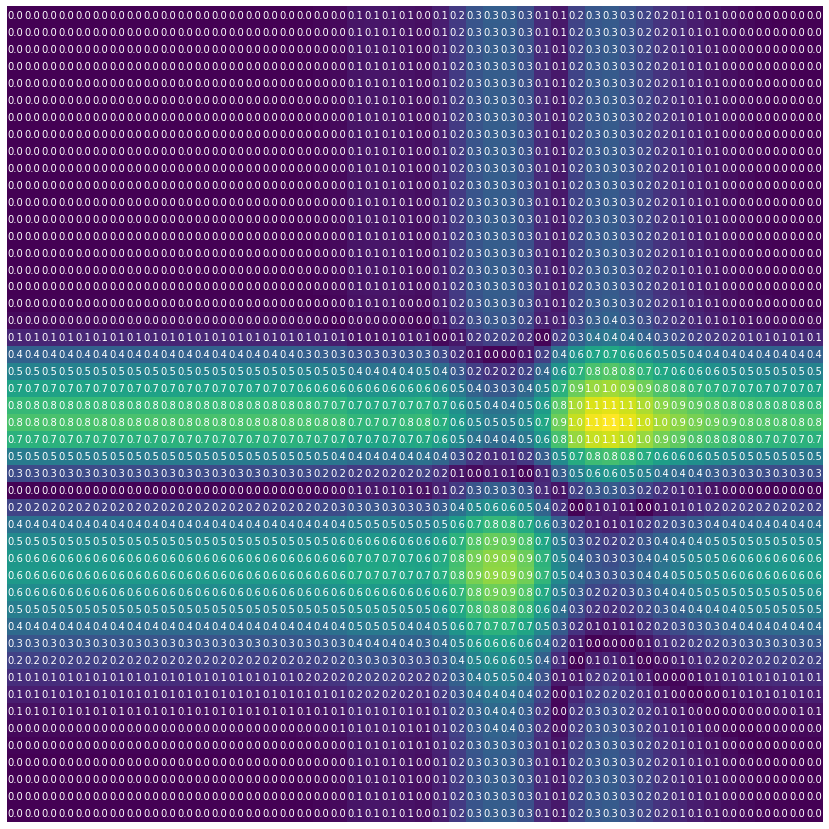

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

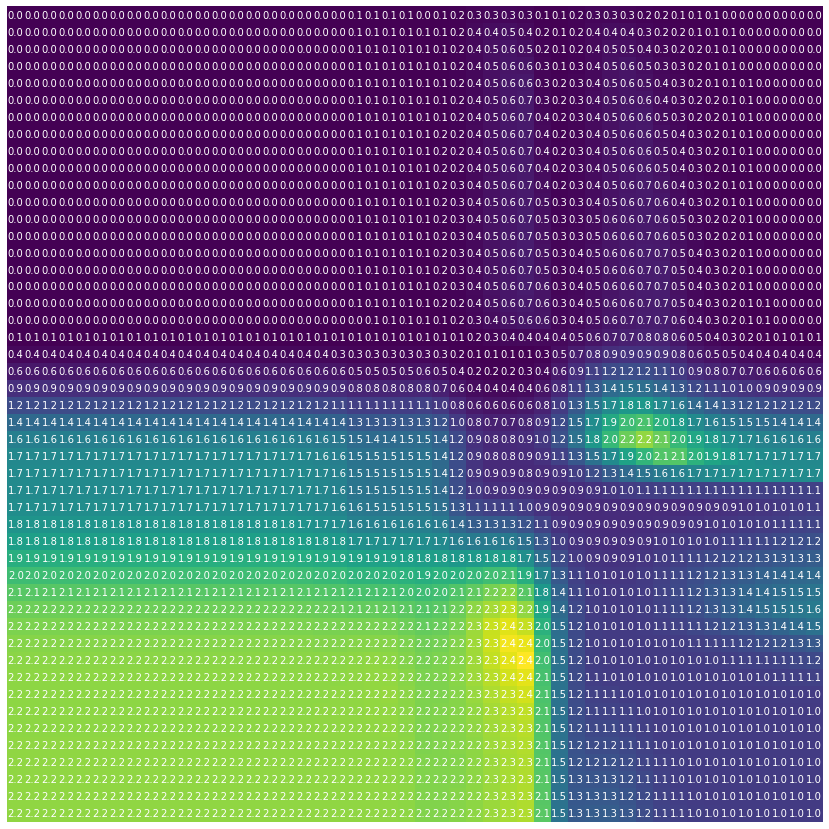

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_8_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

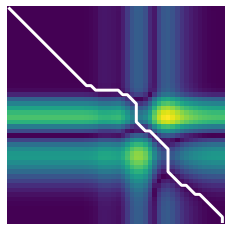

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 7 and Day 9

In [0]:
path, dist = dtw_path(day_7_02[::30], day_9_02[::30])

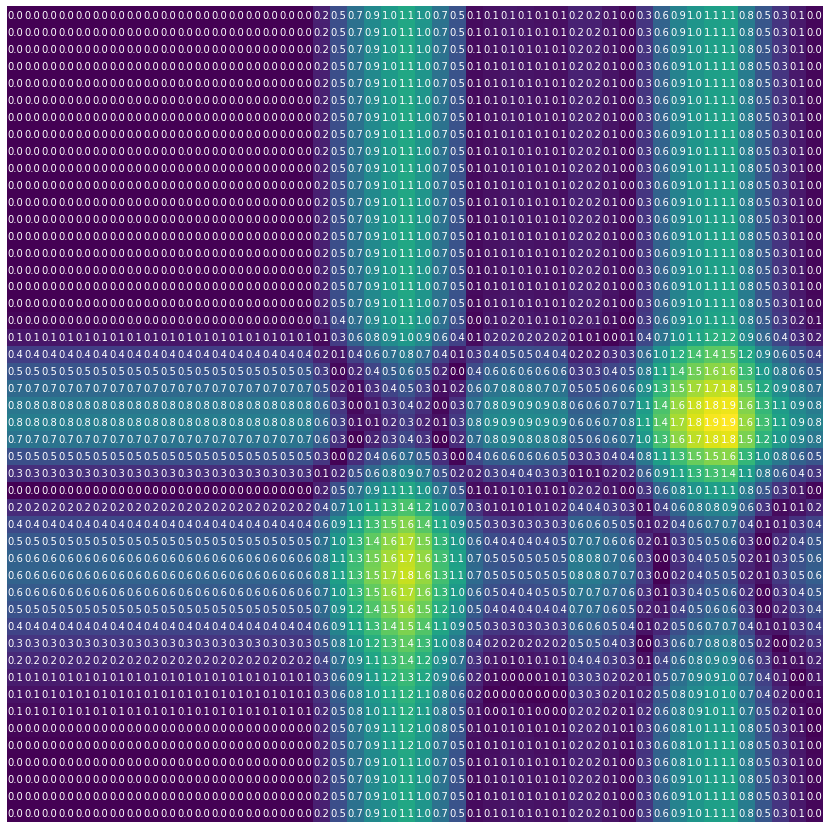

In [0]:
mat = cdist(day_7_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

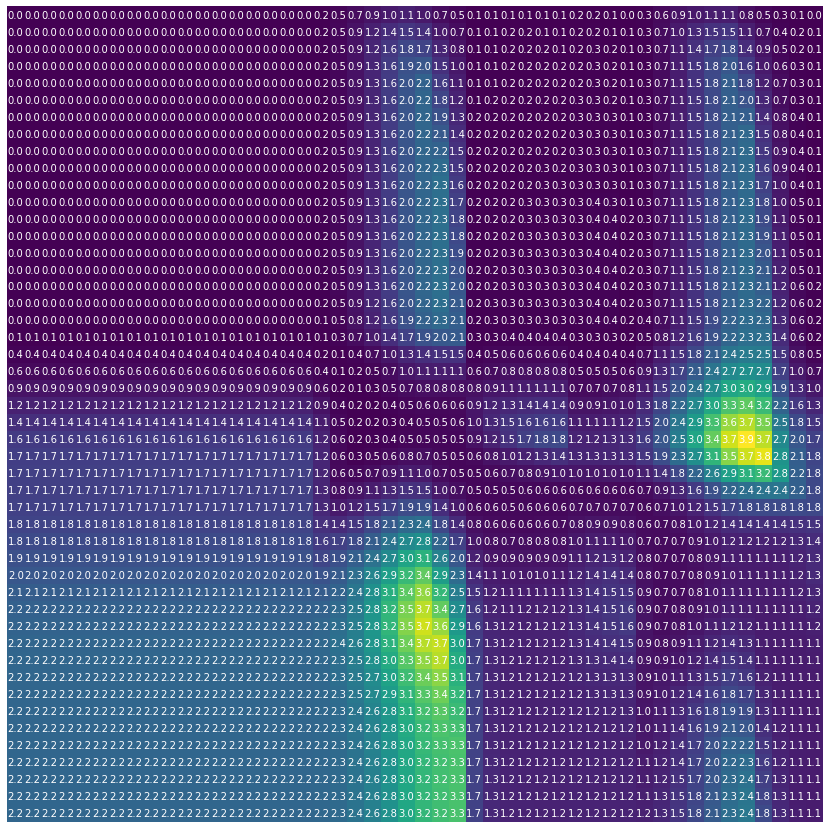

In [0]:
acc = subsequence_cost_matrix(day_7_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

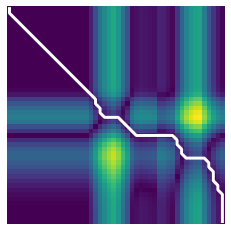

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

###### Day 8 and Day 9

In [0]:
path, dist = dtw_path(day_8_02[::30], day_9_02[::30])

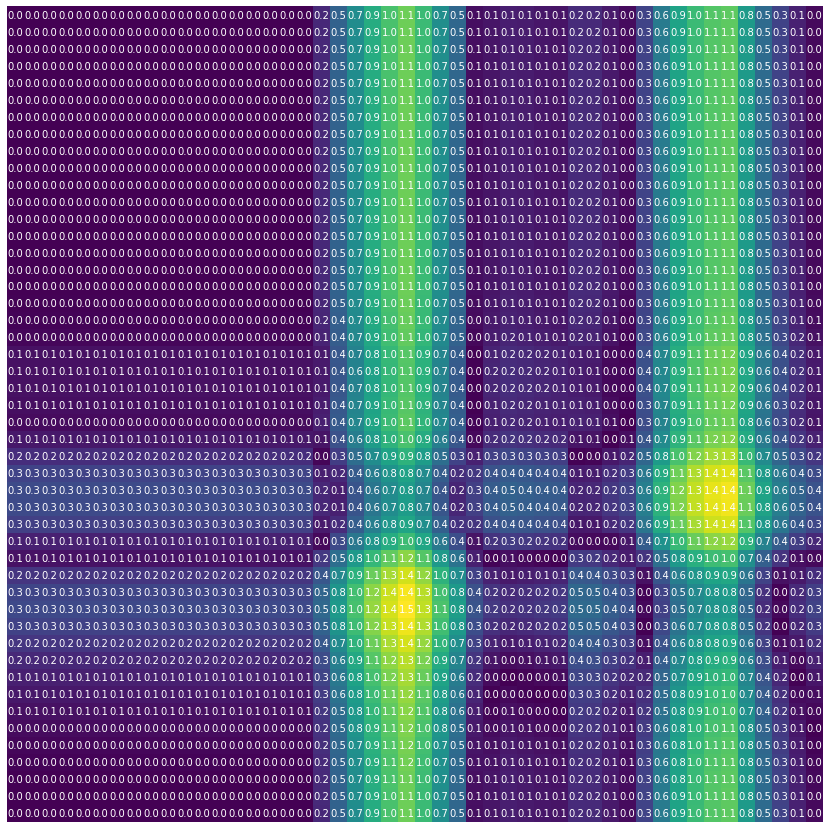

In [0]:
mat = cdist(day_8_02.values[::30].reshape(-1,1),  day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        text = plt.text(j, i, '%.1f' % mat[i, j], ha="center", va="center", color="w")
        
plt.show()

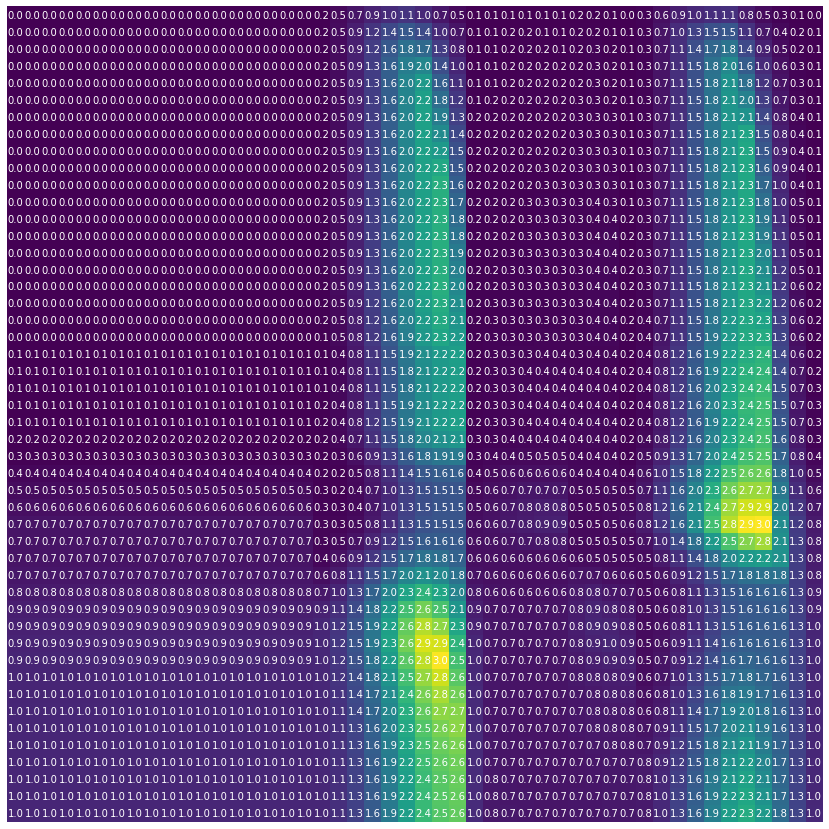

In [0]:
acc = subsequence_cost_matrix(day_8_02.values[::30].reshape(-1,1), day_9_02.values[::30].reshape(-1,1))
plt.figure(figsize=(15,15))
plt.imshow(acc)
plt.axis("off")
plt.autoscale(False)
for i in range(acc.shape[0]):
    for j in range(acc.shape[1]):
        text = plt.text(j, i, '%.1f' % np.sqrt(acc[i, j]), ha="center", va="center", color="w")
        
plt.show()

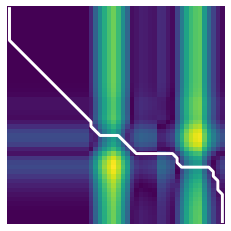

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

In [0]:
### Global constraint: Sakoe-Chiba Band
path, dist = dtw_path(day_8_02[::30], day_9_02[::30], global_constraint="sakoe_chiba", sakoe_chiba_radius=2)

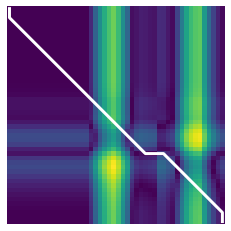

In [0]:
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in path], [i for (i, j) in path], "w-", linewidth=3.)
plt.show()

In [0]:
###
path, dist = dtw_path(day_8_02[::30], day_9_02[::30], global_constraint="itakura", itakura_max_slope=2.)

## Light per day after transformations

In [0]:
day_4_02.reset_index(drop=True, inplace=True)
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)
day_10_02.reset_index(drop=True, inplace=True)

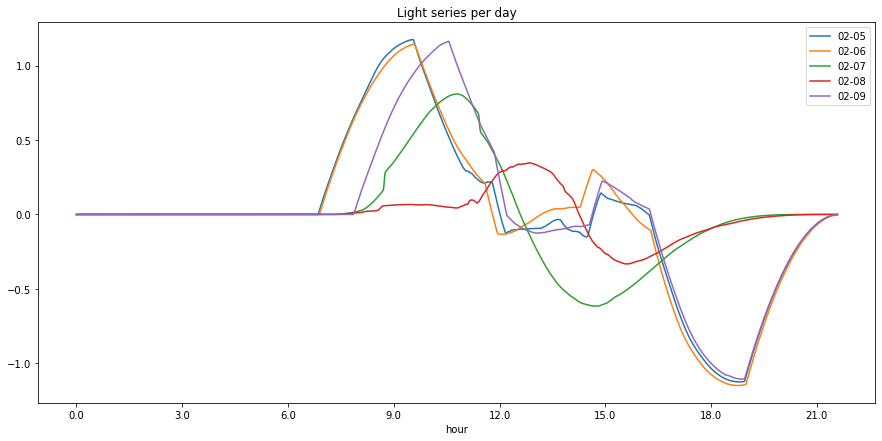

In [0]:
plt.figure(figsize=(15,7))
plt.plot(day_5_02)
plt.plot(day_6_02)
plt.plot(day_7_02)
plt.plot(day_8_02)
plt.plot(day_9_02)
plt.xticks(np.arange(0,1500,200),np.arange(0.00,25.00,3))
plt.xlabel('hour')
plt.legend(['02-05','02-06','02-07','02-08','02-09'])
plt.title('Light series per day')
plt.show()

### Feature extraction

In [0]:
pip install tsfresh

Note: you may need to restart the kernel to use updated packages.


In [0]:
from tsfresh.feature_extraction import extract_features

In [0]:
df['id'] = [0] * len(df)

In [0]:
features = extract_features(timeseries_container=df[['id','Light']], column_id='id')

Feature Extraction: 100%|██████████| 1/1 [04:42<00:00, 282.31s/it]


In [0]:
features.to_dict()

{'Light__abs_energy': {0: 425146407.9994444},
 'Light__absolute_sum_of_changes': {0: 29814.03333333332},
 'Light__agg_autocorrelation__f_agg_"mean"__maxlag_40': {0: 0.8988985485697041},
 'Light__agg_autocorrelation__f_agg_"median"__maxlag_40': {0: 0.8899178595159845},
 'Light__agg_autocorrelation__f_agg_"var"__maxlag_40': {0: 0.0020196098060198467},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"intercept"': {0: 172.65149645134125},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"rvalue"': {0: -0.11997073748677677},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"slope"': {0: -0.10552921905863082},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_10__attr_"stderr"': {0: 0.030626968892627664},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_50__attr_"intercept"': {0: 205.62572946281608},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_50__attr_"rvalue"': {0: -0.11930777349283772},
 'Light__agg_linear_trend__f_agg_"max"__chunk_len_50__attr_"slope

### Compressed-based distancies

In [0]:
import zlib
import string

In [0]:
def CDM(x, y):
    return len(zlib.compress(x + y)) / (len(zlib.compress(x)) + len(zlib.compress(y)))

In [0]:
day_5_02_str = (' '.join([str(v) for v in day_5_02])).encode('utf-8')
day_6_02_str = (' '.join([str(v) for v in day_6_02])).encode('utf-8')
day_7_02_str = (' '.join([str(v) for v in day_7_02])).encode('utf-8')
day_8_02_str = (' '.join([str(v) for v in day_8_02])).encode('utf-8')
day_9_02_str = (' '.join([str(v) for v in day_9_02])).encode('utf-8')

###### Day 5 and 6

In [0]:
print("len(day_5_02_str + day_6_02_str): ", len(day_5_02_str + day_6_02_str))
print("len(compress(day_5_02_str + day_6_02_str)): ", len(zlib.compress(day_5_02_str + day_6_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("CDM = ", CDM(day_5_02_str, day_6_02_str))

len(day_5_02_str + day_6_02_str):  60721
len(compress(day_5_02_str + day_6_02_str)):  18978
len(compress(day_5_02_str)):  9454
len(compress(day_6_02_str)):  9399
CDM =  1.006630244523418


###### Day 5 and 7

In [0]:
print("len(day_5_02_str + day_7_02_str): ", len(day_5_02_str + day_7_02_str))
print("len(compress(day_5_02_str + day_7_02_str)): ", len(zlib.compress(day_5_02_str + day_7_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("CDM = ", CDM(day_5_02_str, day_7_02_str))

len(day_5_02_str + day_7_02_str):  60894
len(compress(day_5_02_str + day_7_02_str)):  18243
len(compress(day_5_02_str)):  9454
len(compress(day_7_02_str)):  8636
CDM =  1.0084577114427862


###### Day 5 and 8

In [0]:
print("len(day_5_02_str + day_8_02_str): ", len(day_5_02_str + day_8_02_str))
print("len(compress(day_5_02_str + day_8_02_str)): ", len(zlib.compress(day_5_02_str + day_8_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_5_02_str, day_8_02_str))

len(day_5_02_str + day_8_02_str):  61057
len(compress(day_5_02_str + day_8_02_str)):  18468
len(compress(day_5_02_str)):  9454
len(compress(day_8_02_str)):  8832
CDM =  1.0099529694848517


###### Day 5 and 9

In [0]:
print("len(day_5_02_str + day_9_02_str): ", len(day_5_02_str + day_9_02_str))
print("len(compress(day_5_02_str + day_9_02_str)): ", len(zlib.compress(day_5_02_str + day_9_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_5_02_str, day_9_02_str))

len(day_5_02_str + day_9_02_str):  60509
len(compress(day_5_02_str + day_9_02_str)):  18380
len(compress(day_5_02_str)):  9454
len(compress(day_9_02_str)):  8747
CDM =  1.0098346244711829


###### Day 6 and 7

In [0]:
print("len(day_6_02_str + day_7_02_str): ", len(day_6_02_str + day_7_02_str))
print("len(compress(day_6_02_str + day_7_02_str)): ", len(zlib.compress(day_6_02_str + day_7_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("CDM = ", CDM(day_6_02_str, day_7_02_str))

len(day_6_02_str + day_7_02_str):  61307
len(compress(day_6_02_str + day_7_02_str)):  18169
len(compress(day_6_02_str)):  9399
len(compress(day_7_02_str)):  8636
CDM =  1.007429997227613


###### Day 6 and 8

In [0]:
print("len(day_6_02_str + day_8_02_str): ", len(day_6_02_str + day_8_02_str))
print("len(compress(day_6_02_str + day_8_02_str)): ", len(zlib.compress(day_6_02_str + day_8_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_6_02_str, day_8_02_str))

len(day_6_02_str + day_8_02_str):  61470
len(compress(day_6_02_str + day_8_02_str)):  18420
len(compress(day_6_02_str)):  9399
len(compress(day_8_02_str)):  8832
CDM =  1.0103669573802863


###### Day 6 and 9

In [0]:
print("len(day_6_02_str + day_9_02_str): ", len(day_6_02_str + day_9_02_str))
print("len(compress(day_6_02_str + day_9_02_str)): ", len(zlib.compress(day_6_02_str + day_9_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_6_02_str, day_9_02_str))

len(day_6_02_str + day_9_02_str):  60922
len(compress(day_6_02_str + day_9_02_str)):  18283
len(compress(day_6_02_str)):  9399
len(compress(day_9_02_str)):  8747
CDM =  1.0075498732503032


###### Day 7 and 8

In [0]:
print("len(day_7_02_str + day_8_02_str): ", len(day_7_02_str + day_8_02_str))
print("len(compress(day_7_02_str + day_8_02_str)): ", len(zlib.compress(day_7_02_str + day_8_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("CDM = ", CDM(day_7_02_str, day_8_02_str))

len(day_7_02_str + day_8_02_str):  61643
len(compress(day_7_02_str + day_8_02_str)):  17631
len(compress(day_7_02_str)):  8636
len(compress(day_8_02_str)):  8832
CDM =  1.0093313487520037


###### Day 7 and 9

In [0]:
print("len(day_7_02_str + day_9_02_str): ", len(day_7_02_str + day_9_02_str))
print("len(compress(day_7_02_str + day_9_02_str)): ", len(zlib.compress(day_7_02_str + day_9_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_7_02_str, day_9_02_str))

len(day_7_02_str + day_9_02_str):  61095
len(compress(day_7_02_str + day_9_02_str)):  17517
len(compress(day_7_02_str)):  8636
len(compress(day_9_02_str)):  8747
CDM =  1.0077086808951274


###### Day 8 and 9

In [0]:
print("len(day_8_02_str + day_9_02_str): ", len(day_8_02_str + day_9_02_str))
print("len(compress(day_8_02_str + day_9_02_str)): ", len(zlib.compress(day_8_02_str + day_9_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))
print("CDM = ", CDM(day_8_02_str, day_9_02_str))

len(day_8_02_str + day_9_02_str):  61258
len(compress(day_8_02_str + day_9_02_str)):  17705
len(compress(day_8_02_str)):  8832
len(compress(day_9_02_str)):  8747
CDM =  1.007167643210649


### Time series Approximation

In [0]:
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

from tslearn.piecewise import PiecewiseAggregateApproximation
from tslearn.piecewise import SymbolicAggregateApproximation
from tslearn.piecewise import OneD_SymbolicAggregateApproximation
from numpy.fft import fft,fftfreq

In [0]:
scaler = TimeSeriesScalerMeanVariance(mu=0., std=1.)  # Rescale time series
day_5_02_scl = scaler.fit_transform(day_5_02)
day_6_02_scl = scaler.fit_transform(day_6_02)
day_7_02_scl = scaler.fit_transform(day_7_02)
day_8_02_scl = scaler.fit_transform(day_8_02)
day_9_02_scl = scaler.fit_transform(day_9_02)

#### Day5

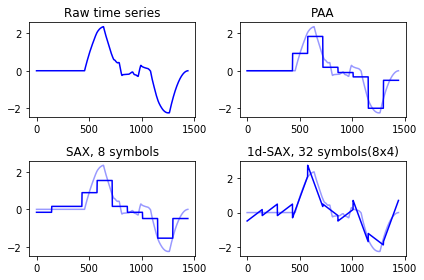

In [0]:
# PAA transform (and inverse transform) of the data
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = paa.fit_transform(day_5_02_scl)
paa_dataset_inv = paa.inverse_transform(ts_paa)

# SAX transform
n_sax_symbols = 8
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
ts_sax = sax.fit_transform(day_5_02_scl)
sax_dataset_inv = sax.inverse_transform(ts_sax)

# 1d-SAX transform
n_sax_symbols_avg = 8
n_sax_symbols_slope = 4
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = one_d_sax.fit_transform(day_5_02_scl)
one_d_sax_dataset_inv = one_d_sax.inverse_transform(ts_sax1d)

plt.figure()
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(day_5_02_scl[0].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(day_5_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[0].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(day_5_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[0].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(day_5_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[0].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

#### Day6

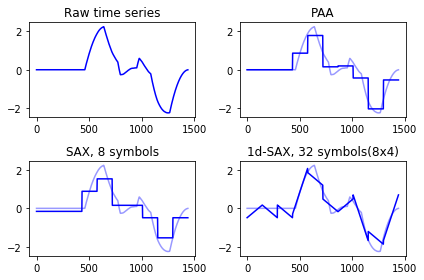

In [0]:
# PAA transform (and inverse transform) of the data
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = paa.fit_transform(day_6_02_scl)
paa_dataset_inv = paa.inverse_transform(ts_paa)

# SAX transform
n_sax_symbols = 8
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
ts_sax = sax.fit_transform(day_6_02_scl)
sax_dataset_inv = sax.inverse_transform(ts_sax)

# 1d-SAX transform
n_sax_symbols_avg = 8
n_sax_symbols_slope = 4
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = one_d_sax.fit_transform(day_6_02_scl)
one_d_sax_dataset_inv = one_d_sax.inverse_transform(ts_sax1d)

plt.figure()
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(day_6_02_scl[0].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(day_6_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[0].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(day_6_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[0].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(day_6_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[0].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

#### Day7

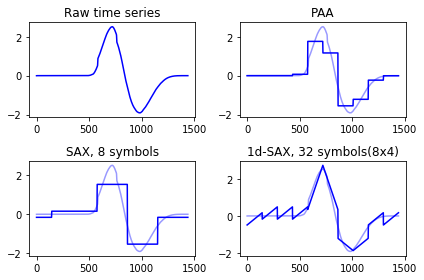

In [0]:
# PAA transform (and inverse transform) of the data
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = paa.fit_transform(day_7_02_scl)
paa_dataset_inv = paa.inverse_transform(ts_paa)

# SAX transform
n_sax_symbols = 8
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
ts_sax = sax.fit_transform(day_7_02_scl)
sax_dataset_inv = sax.inverse_transform(ts_sax)

# 1d-SAX transform
n_sax_symbols_avg = 8
n_sax_symbols_slope = 4
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = one_d_sax.fit_transform(day_7_02_scl)
one_d_sax_dataset_inv = one_d_sax.inverse_transform(ts_sax1d)

plt.figure()
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(day_7_02_scl[0].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(day_7_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[0].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(day_7_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[0].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(day_7_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[0].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

#### Day8

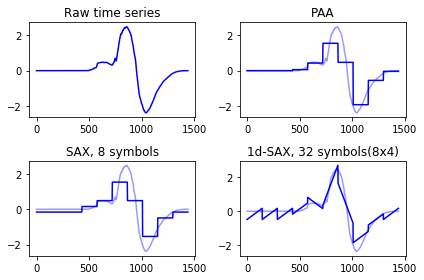

In [0]:
# PAA transform (and inverse transform) of the data
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = paa.fit_transform(day_8_02_scl)
paa_dataset_inv = paa.inverse_transform(ts_paa)

# SAX transform
n_sax_symbols = 8
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
ts_sax = sax.fit_transform(day_8_02_scl)
sax_dataset_inv = sax.inverse_transform(ts_sax)

# 1d-SAX transform
n_sax_symbols_avg = 8
n_sax_symbols_slope = 4
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = one_d_sax.fit_transform(day_8_02_scl)
one_d_sax_dataset_inv = one_d_sax.inverse_transform(ts_sax1d)

plt.figure()
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(day_8_02_scl[0].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(day_8_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[0].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(day_8_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[0].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(day_8_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[0].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

#### Day9

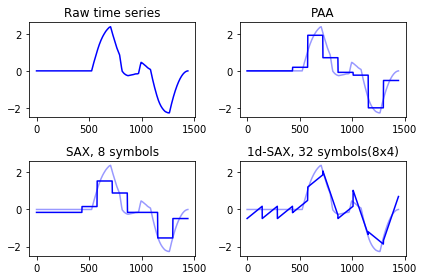

In [0]:
# PAA transform (and inverse transform) of the data
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = paa.fit_transform(day_9_02_scl)
paa_dataset_inv = paa.inverse_transform(ts_paa)

# SAX transform
n_sax_symbols = 8
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
ts_sax = sax.fit_transform(day_9_02_scl)
sax_dataset_inv = sax.inverse_transform(ts_sax)

# 1d-SAX transform
n_sax_symbols_avg = 8
n_sax_symbols_slope = 4
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = one_d_sax.fit_transform(day_9_02_scl)
one_d_sax_dataset_inv = one_d_sax.inverse_transform(ts_sax1d)

plt.figure()
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(day_9_02_scl[0].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(day_9_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[0].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(day_9_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[0].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(day_9_02_scl[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[0].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

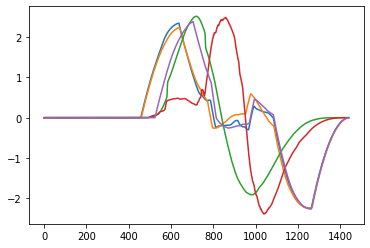

In [0]:
plt.plot(day_5_02_scl[0].ravel())
plt.plot(day_6_02_scl[0].ravel())
plt.plot(day_7_02_scl[0].ravel())
plt.plot(day_8_02_scl[0].ravel())
plt.plot(day_9_02_scl[0].ravel())

plt.show()

In [0]:
day_5_02_scl_paa = paa.fit_transform(day_5_02_scl)
day_6_02_scl_paa = paa.fit_transform(day_6_02_scl)
day_7_02_scl_paa = paa.fit_transform(day_7_02_scl)
day_8_02_scl_paa = paa.fit_transform(day_8_02_scl)
day_9_02_scl_paa = paa.fit_transform(day_9_02_scl)

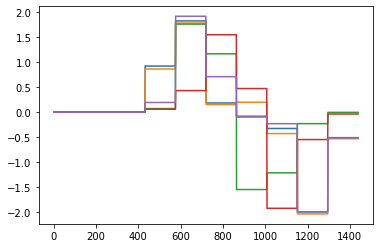

In [0]:
plt.plot(paa.inverse_transform(day_5_02_scl_paa)[0].ravel())
plt.plot(paa.inverse_transform(day_6_02_scl_paa)[0].ravel())
plt.plot(paa.inverse_transform(day_7_02_scl_paa)[0].ravel())
plt.plot(paa.inverse_transform(day_8_02_scl_paa)[0].ravel())
plt.plot(paa.inverse_transform(day_9_02_scl_paa)[0].ravel())
plt.show()

In [0]:
day_5_02_str = (' '.join([str(v) for v in day_5_02_scl_paa[0].ravel()])).encode('utf-8')
day_6_02_str = (' '.join([str(v) for v in day_6_02_scl_paa[0].ravel()])).encode('utf-8')
day_7_02_str = (' '.join([str(v) for v in day_7_02_scl_paa[0].ravel()])).encode('utf-8')
day_8_02_str = (' '.join([str(v) for v in day_8_02_scl_paa[0].ravel()])).encode('utf-8')
day_9_02_str = (' '.join([str(v) for v in day_9_02_scl_paa[0].ravel()])).encode('utf-8')

print("len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str): ", len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str))
print("len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)): ", len(zlib.compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))

print("CDM 5/6 = ", CDM(day_5_02_str, day_6_02_str))
print("CDM 5/7 = ", CDM(day_5_02_str, day_7_02_str))
print("CDM 5/8 = ", CDM(day_5_02_str, day_8_02_str))
print("CDM 5/9 = ", CDM(day_5_02_str, day_9_02_str))
print("CDM 6/7 = ", CDM(day_6_02_str, day_7_02_str))
print("CDM 6/8 = ", CDM(day_6_02_str, day_8_02_str))
print("CDM 6/9 = ", CDM(day_6_02_str, day_9_02_str))
print("CDM 7/8 = ", CDM(day_7_02_str, day_8_02_str))
print("CDM 7/9 = ", CDM(day_7_02_str, day_9_02_str))
print("CDM 8/9 = ", CDM(day_8_02_str, day_9_02_str))

len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str):  1031
len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)):  471
len(compress(day_5_02_str)):  120
len(compress(day_6_02_str)):  118
len(compress(day_7_02_str)):  120
len(compress(day_8_02_str)):  110
len(compress(day_9_02_str)):  108
CDM 5/6 =  0.8823529411764706
CDM 5/7 =  0.8833333333333333
CDM 5/8 =  0.8869565217391304
CDM 5/9 =  0.8859649122807017
CDM 6/7 =  0.8865546218487395
CDM 6/8 =  0.8859649122807017
CDM 6/9 =  0.8849557522123894
CDM 7/8 =  0.8695652173913043
CDM 7/9 =  0.881578947368421
CDM 8/9 =  0.8715596330275229


In [0]:
day_5_02_scl_sax = sax.fit_transform(day_5_02_scl)
day_6_02_scl_sax = sax.fit_transform(day_6_02_scl)
day_7_02_scl_sax = sax.fit_transform(day_7_02_scl)
day_8_02_scl_sax = sax.fit_transform(day_8_02_scl)
day_9_02_scl_sax = sax.fit_transform(day_9_02_scl)

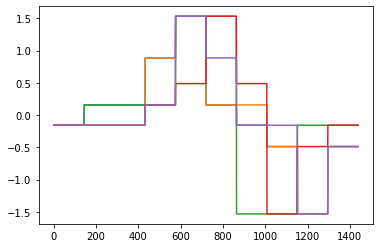

In [0]:
plt.plot(sax.inverse_transform(day_5_02_scl_sax)[0].ravel())
plt.plot(sax.inverse_transform(day_6_02_scl_sax)[0].ravel())
plt.plot(sax.inverse_transform(day_7_02_scl_sax)[0].ravel())
plt.plot(sax.inverse_transform(day_8_02_scl_sax)[0].ravel())
plt.plot(sax.inverse_transform(day_9_02_scl_sax)[0].ravel())
plt.show()

In [0]:

day_5_02_str = (' '.join([str(v) for v in day_5_02_scl_sax[0].ravel()])).encode('utf-8')
day_6_02_str = (' '.join([str(v) for v in day_6_02_scl_sax[0].ravel()])).encode('utf-8')
day_7_02_str = (' '.join([str(v) for v in day_7_02_scl_sax[0].ravel()])).encode('utf-8')
day_8_02_str = (' '.join([str(v) for v in day_8_02_scl_sax[0].ravel()])).encode('utf-8')
day_9_02_str = (' '.join([str(v) for v in day_9_02_scl_sax[0].ravel()])).encode('utf-8')

print("len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str): ", len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str))
print("len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)): ", len(zlib.compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))

print("CDM 5/6 = ", CDM(day_5_02_str, day_6_02_str))
print("CDM 5/7 = ", CDM(day_5_02_str, day_7_02_str))
print("CDM 5/8 = ", CDM(day_5_02_str, day_8_02_str))
print("CDM 5/9 = ", CDM(day_5_02_str, day_9_02_str))
print("CDM 6/7 = ", CDM(day_6_02_str, day_7_02_str))
print("CDM 6/8 = ", CDM(day_6_02_str, day_8_02_str))
print("CDM 6/9 = ", CDM(day_6_02_str, day_9_02_str))
print("CDM 7/8 = ", CDM(day_7_02_str, day_8_02_str))
print("CDM 7/9 = ", CDM(day_7_02_str, day_9_02_str))
print("CDM 8/9 = ", CDM(day_8_02_str, day_9_02_str))

len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str):  95
len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)):  56
len(compress(day_5_02_str)):  24
len(compress(day_6_02_str)):  24
len(compress(day_7_02_str)):  20
len(compress(day_8_02_str)):  24
len(compress(day_9_02_str)):  22
CDM 5/6 =  0.6666666666666666
CDM 5/7 =  0.8181818181818182
CDM 5/8 =  0.7708333333333334
CDM 5/9 =  0.7608695652173914
CDM 6/7 =  0.7954545454545454
CDM 6/8 =  0.75
CDM 6/9 =  0.7391304347826086
CDM 7/8 =  0.75
CDM 7/9 =  0.7142857142857143
CDM 8/9 =  0.717391304347826


In [0]:
day_5_02_scl_sax1d = one_d_sax.fit_transform(day_5_02_scl)
day_6_02_scl_sax1d = one_d_sax.fit_transform(day_6_02_scl)
day_7_02_scl_sax1d = one_d_sax.fit_transform(day_7_02_scl)
day_8_02_scl_sax1d = one_d_sax.fit_transform(day_8_02_scl)
day_9_02_scl_sax1d = one_d_sax.fit_transform(day_9_02_scl)

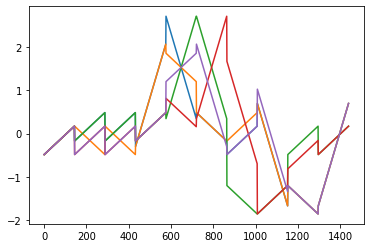

In [0]:
plt.plot(one_d_sax.inverse_transform(day_5_02_scl_sax1d)[0].ravel())
plt.plot(one_d_sax.inverse_transform(day_6_02_scl_sax1d)[0].ravel())
plt.plot(one_d_sax.inverse_transform(day_7_02_scl_sax1d)[0].ravel())
plt.plot(one_d_sax.inverse_transform(day_8_02_scl_sax1d)[0].ravel())
plt.plot(one_d_sax.inverse_transform(day_9_02_scl_sax1d)[0].ravel())
plt.show()

In [0]:
day_5_02_str = (' '.join([str(v) for v in day_5_02_scl_sax1d[0].ravel()])).encode('utf-8')
day_6_02_str = (' '.join([str(v) for v in day_6_02_scl_sax1d[0].ravel()])).encode('utf-8')
day_7_02_str = (' '.join([str(v) for v in day_7_02_scl_sax1d[0].ravel()])).encode('utf-8')
day_8_02_str = (' '.join([str(v) for v in day_8_02_scl_sax1d[0].ravel()])).encode('utf-8')
day_9_02_str = (' '.join([str(v) for v in day_9_02_scl_sax1d[0].ravel()])).encode('utf-8')

print("len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str): ", len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str))
print("len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)): ", len(zlib.compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)))
print("len(compress(day_5_02_str)): ", len(zlib.compress(day_5_02_str)))
print("len(compress(day_6_02_str)): ", len(zlib.compress(day_6_02_str)))
print("len(compress(day_7_02_str)): ", len(zlib.compress(day_7_02_str)))
print("len(compress(day_8_02_str)): ", len(zlib.compress(day_8_02_str)))
print("len(compress(day_9_02_str)): ", len(zlib.compress(day_9_02_str)))

print("CDM 5/6 = ", CDM(day_5_02_str, day_6_02_str))
print("CDM 5/7 = ", CDM(day_5_02_str, day_7_02_str))
print("CDM 5/8 = ", CDM(day_5_02_str, day_8_02_str))
print("CDM 5/9 = ", CDM(day_5_02_str, day_9_02_str))
print("CDM 6/7 = ", CDM(day_6_02_str, day_7_02_str))
print("CDM 6/8 = ", CDM(day_6_02_str, day_8_02_str))
print("CDM 6/9 = ", CDM(day_6_02_str, day_9_02_str))
print("CDM 7/8 = ", CDM(day_7_02_str, day_8_02_str))
print("CDM 7/9 = ", CDM(day_7_02_str, day_9_02_str))
print("CDM 8/9 = ", CDM(day_8_02_str, day_9_02_str))

len(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str):  195
len(compress(day_5_02_str + day_6_02_str + day_7_02_str + day_8_02_str + day_9_02_str)):  80
len(compress(day_5_02_str)):  34
len(compress(day_6_02_str)):  32
len(compress(day_7_02_str)):  28
len(compress(day_8_02_str)):  32
len(compress(day_9_02_str)):  29
CDM 5/6 =  0.7272727272727273
CDM 5/7 =  0.7741935483870968
CDM 5/8 =  0.7878787878787878
CDM 5/9 =  0.746031746031746
CDM 6/7 =  0.7833333333333333
CDM 6/8 =  0.78125
CDM 6/9 =  0.7868852459016393
CDM 7/8 =  0.75
CDM 7/9 =  0.7543859649122807
CDM 8/9 =  0.7868852459016393


## Clustering


In [0]:
df = pd.read_csv(url) 

In [0]:
columns2remove = ['HumidityRatio', 'CO2','Temperature','Occupancy','Humidity']
df.drop(columns2remove, inplace=True, axis=1)

In [0]:
df['date'] = pd.to_datetime(df['date'])

In [0]:
df = df.set_index(['date'])

In [0]:
df_denoised = ((df-df.mean())/df.std()).rolling(window=180).mean()
ts = df_denoised.loc['2015-02-04':'2015-02-10']
sma = ts.rolling(window = 180).mean()
ts_shift = ts - sma

In [0]:
day_4_02 = ts_shift['2015-02-04']
day_5_02 = ts_shift['2015-02-05']
day_6_02 = ts_shift['2015-02-06']
day_7_02 = ts_shift['2015-02-07']
day_8_02 = ts_shift['2015-02-08']
day_9_02 = ts_shift['2015-02-09']
day_10_02 = ts_shift['2015-02-10']

In [0]:
day_5_02.reset_index(drop=True, inplace=True)
day_6_02.reset_index(drop=True, inplace=True)
day_7_02.reset_index(drop=True, inplace=True)
day_8_02.reset_index(drop=True, inplace=True)
day_9_02.reset_index(drop=True, inplace=True)

In [0]:
day5=day_5_02.values
day6=day_6_02.values
day7=day_7_02.values
day8=day_8_02.values
day9=day_9_02.values

In [0]:
A=np.array(day5)
B=np.array(day6)
C=np.array(day7)
D=np.array(day8)
E=np.array(day9)

In [0]:
F=np.array([A,B,C,D,E])


In [0]:
F.shape

(5, 1440, 1)

### Shape based

In [0]:
from tslearn.clustering import TimeSeriesKMeans

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.cluster.k_means_ module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.cluster. Anything that cannot be imported from sklearn.cluster is now part of the private API.
  warnings.warn(message, FutureWarning)


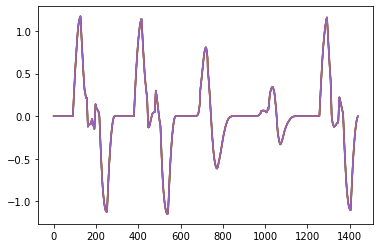

In [0]:
plt.plot(F.reshape(F.shape[1], F.shape[0]))
plt.show()

In [0]:
km = TimeSeriesKMeans(n_clusters=2, metric="euclidean",verbose=1)
km.fit(F)

39.193 --> 21.635 --> 21.635 --> 


TimeSeriesKMeans(dtw_inertia=False, init='k-means++', max_iter=50,
                 max_iter_barycenter=100, metric='euclidean',
                 metric_params=None, n_clusters=2, n_init=1, n_jobs=None,
                 random_state=None, tol=1e-06, verbose=1)

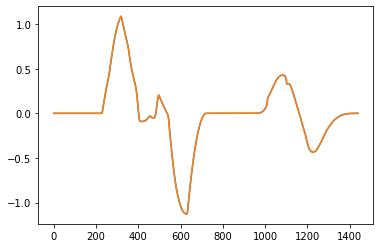

In [0]:
plt.plot(km.cluster_centers_.reshape(F.shape[1], 2))
plt.show()

In [0]:
km.labels_

array([0, 0, 1, 1, 0])

In [0]:
km.inertia_

21.63548010785339

In [0]:
km_dtw = TimeSeriesKMeans(n_clusters=2, metric="dtw",verbose=1)
km_dtw.fit(F)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.6s finished


5.760 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.8s finished


0.187 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.8s finished


0.187 --> 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.8s finished


TimeSeriesKMeans(dtw_inertia=False, init='k-means++', max_iter=50,
                 max_iter_barycenter=100, metric='dtw', metric_params=None,
                 n_clusters=2, n_init=1, n_jobs=None, random_state=None,
                 tol=1e-06, verbose=1)

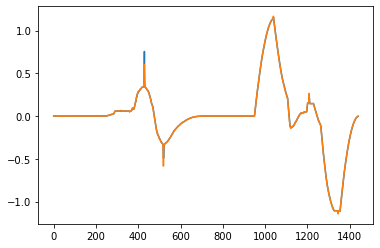

In [0]:
plt.plot(km_dtw.cluster_centers_.reshape(F.shape[1], 2))
plt.show()

In [0]:
km_dtw.labels_

array([1, 1, 0, 0, 1])

In [0]:
km_dtw.inertia_

0.18699051221618046

###  Compression based

In [0]:
import zlib
import string

In [0]:
from sklearn.metrics import pairwise_distances

In [0]:
def cdm_dist(x, y):
    x_str = (' '.join([str(v) for v in x.ravel()])).encode('utf-8')
    y_str = (' '.join([str(v) for v in y.ravel()])).encode('utf-8')
    return len(zlib.compress(x_str + y_str)) / (len(zlib.compress(x_str)) + len(zlib.compress(y_str)))

In [0]:
M = pairwise_distances(F.reshape(F.shape[0], F.shape[1]), metric=cdm_dist)

In [0]:
M.shape

(5, 5)

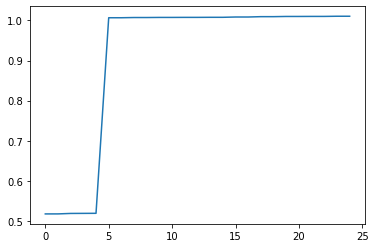

In [0]:
plt.plot(sorted(M.ravel()))
plt.show()

In [0]:
from sklearn.cluster import DBSCAN

In [0]:
dbscan = DBSCAN(eps=1, min_samples=5, metric='precomputed')
dbscan.fit(M)

DBSCAN(algorithm='auto', eps=1, leaf_size=30, metric='precomputed',
       metric_params=None, min_samples=5, n_jobs=None, p=None)

In [0]:
dbscan.labels_

array([-1, -1, -1, -1, -1])

### Approximation based

In [0]:
pip install tslearn

     |████████████████████████████████| 747kB 8.9MB/s 


In [0]:
from tslearn.piecewise import PiecewiseAggregateApproximation
from tslearn.piecewise import SymbolicAggregateApproximation
from tslearn.piecewise import OneD_SymbolicAggregateApproximation
from tslearn.clustering import TimeSeriesKMeans

In [0]:
n_paa_segments = 10
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
F_paa = paa.fit_transform(F)

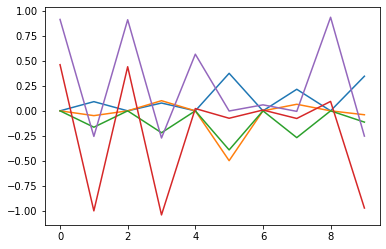

In [0]:
plt.plot(F_paa.reshape(F_paa.shape[1], F_paa.shape[0]))
plt.show()

In [0]:
km = TimeSeriesKMeans(n_clusters=2, metric="euclidean", max_iter=5)
km.fit(F_paa)

TimeSeriesKMeans(dtw_inertia=False, init='k-means++', max_iter=5,
                 max_iter_barycenter=100, metric='euclidean',
                 metric_params=None, n_clusters=2, n_init=1, n_jobs=None,
                 random_state=None, tol=1e-06, verbose=0)

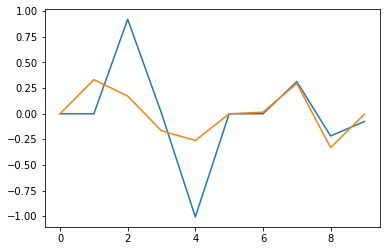

In [0]:
plt.plot(km.cluster_centers_.reshape(F_paa.shape[1], 2))
plt.show()

In [0]:
km.cluster_centers_.shape

(2, 10, 1)

In [0]:
km.labels_

array([0, 0, 1, 1, 0])

In [0]:
km.inertia_

0.09240975229003923

In [0]:
km = TimeSeriesKMeans(n_clusters=2, metric="dtw", max_iter=5)
km.fit(F_paa)

TimeSeriesKMeans(dtw_inertia=False, init='k-means++', max_iter=5,
                 max_iter_barycenter=100, metric='dtw', metric_params=None,
                 n_clusters=2, n_init=1, n_jobs=None, random_state=None,
                 tol=1e-06, verbose=0)

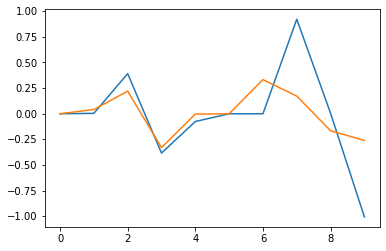

In [0]:
plt.plot(km.cluster_centers_.reshape(F_paa.shape[1], 2))
plt.show()

In [0]:
km.labels_

array([1, 1, 0, 0, 1])

In [0]:
km.inertia_

0.05966567371172634

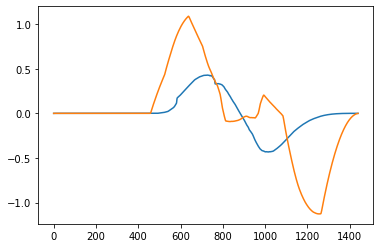

In [0]:
for i in range(2):
    plt.plot(np.mean(F[np.where(km.labels_ == i)[0]], axis=0))
plt.show()